<div align="center"> Projet 3 - Préparez des données pour un organisme de santé publique</div>
<div align="center"> Charlotte Dubus </div>   

<hr>

<div align="center">
    <img src="https://static.openfoodfacts.org/images/logos/off-logo-horizontal-light.svg" alt="Openfoodfacts logo">
</div>   
<div align="center">
    <img src="https://phonegatealert.org/wp-content/uploads/2019/11/logo_ogg-1.png" alt="Santé publique France logo">
</div>

<div align="center"> Sommaire </div>  

 1. **[Introduction](#Introduction)**  

---

2. **[Analyse  et  pré-exploration  des  données](#Analyse-et-pré-exploration-des-données)**  
    2.1 [Analyse  de  forme](#Analyse-de-forme)  
    2.2 [Analyse  de  fond](#Analyse-de-fond)

---

3. **[Nettoyage  des  données](#Nettoyage-des-données)**  
    3.1 [Variables  quantitatives](#Variables-quantitatives)  
    3.2 [Variables  qualitatives](#Variables-qualitatives)

---

4. **[Analyse  Exploratoire](#Analyse-Exploratoire)**  
    4.1 [Analyse  Univariée](#Analyse-Univariée)  
    4.2 [Analyse  Bivariée](#Analyse-Bivariée)  
    4.3 [Analyse  Multivariée](#Analyse-Multivariée)  

---

5. **[Conclusion](#Conclusion)**

# Introduction

 ## Mission ##

L’agence Santé publique France confie à votre entreprise la création d’un système de suggestion ou d’autocomplétion pour aider les usagers à remplir plus efficacement la base de données.
Vous êtes missionné sur le projet de nettoyage et exploration des données en interne, afin de déterminer la faisabilité de cette idée d’application de Santé publique France.

---

**Explications:**

- ***Le Nutri-score :*** C'est un système d'étiquetage nutritionnel qui classe les aliments en fonction de leur qualité nutritionnelle. Le Nutri-Score attribue une note à chaque aliment sur la base de sa composition nutritionnelle, en tenant compte à la fois des éléments bénéfiques (comme les fibres, les protéines, les fruits et légumes) et des éléments moins favorables (comme les calories, les sucres, les graisses saturées et le sel). Les aliments reçoivent une lettre et une couleur correspondant à la qualité nutritionnelle globale, allant de A (vert, considéré comme plus sain) à E (rouge, considéré comme moins sain).
  
- ***Groupes PNNS :*** Le terme "PNNS" fait référence au 'Plan National Nutrition Santé'. Il vise à prévenir les problèmes de santé liés à la nutrition, tels que l'obésité, les maladies cardiovasculaires et le diabète.Le plan PNNS se décline en plusieurs groupes, notamment les 'Groupes d'Aliments' et les 'Repères Nutritionnels Quotidiens'.

- ***L'application Openfoodfacts :*** Open Food Facts est une base de données collaborative et un projet open-source qui collecte des informations sur les produits alimentaires du monde entier. L'objectif principal d'Open Food Facts est de fournir des données transparentes et accessibles sur la composition nutritionnelle et les caractéristiques des produits alimentaires, permettant aux consommateurs de prendre des décisions éclairées lors de leurs achats.

---

*NB : Vous retrouverez le jeu de données utilisé pour cette analyse à ce [lien](https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/parcours-data-scientist/P2/fr.openfoodfacts.org.products.csv.zip).*

 ## Préparation du jupyter notebook

In [ ]:
pip install adjustText

In [ ]:
pip install scikit-posthocs

In [ ]:
# Importation des librairies nécessaires pour le traitement du jeu de données
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import plotly as px
import plotly.express as pxe
import plotly.graph_objects as go
from matplotlib.patches import Patch
import sklearn as skl
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from adjustText import adjust_text
import statsmodels.api as sm
from scipy import stats
from statsmodels.formula.api import ols
from scipy.stats import kruskal
import scikit_posthocs as sp
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

In [ ]:
# Vérification des versions de chaque librairie
print('NumPy      : ' + np.version.full_version)
print('Pandas     : ' + pd.__version__)
print('Seaborn    : ' + sns.__version__)
print('Plotly     : ' + px.__version__)
print('MatplotLib : ' + mpl.__version__)
print('Missingno  : ' + msno.__version__)
print('Sklearn    : ' + skl.__version__)

NumPy      : 1.23.5
Pandas     : 1.5.3
Seaborn    : 0.12.2
Plotly     : 5.15.0
MatplotLib : 3.7.1
Missingno  : 0.5.2
Sklearn    : 1.2.2


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Chargement du dataset
chemin_fichier = '/content/drive/MyDrive/Data/openfoodfacts.csv'

# Lire le fichier CSV
data = pd.read_csv(chemin_fichier, sep='\t', encoding='utf-8', low_memory=False)

In [ ]:
# Réglage d'affichage du jeu de données
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows',165)

In [ ]:
# Création d'une copie du dataframe des données
df_openfoodfacts = data.copy()

# Analyse et pré-exploration des données

Cette partie est composée de 2 étapes cruciales qui nous permettront de comprendre notre jeu de données. Elle nous permettra de plonger plus profondément dans les informations recueillies de dégager des premières tendances significatives.

Dans cette section, nous entamerons l'étape cruciale de l'analyse et de l'exploration des données. Cette phase nous permettra de plonger plus profondément dans les informations recueillies, de dégager des tendances notables, et de tirer des conclusions tangibles. Nous aborderons les chiffres, les graphiques et les métriques avec l'objectif de mieux comprendre notre sujet d'étude.

## Analyse de forme ##

L'analyse de forme nous permet de faire l'examen des caractéristiques structurelles de notre jeu de données. Elle se concentre sur la structure du dataset et permet de prendre des décisions initiales sur la manipulation des données, la préparation des données et les étapes d'analyse ultérieures.

On retrouve dans cette étape :
- L'examen des premières lignes du jeu de données  
- Sa dimension  
- Les types de données présents
- La recherche de valeurs manquantes

In [ ]:
# Présentation du DataFrame
df_openfoodfacts.head()

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,packaging,packaging_tags,brands,brands_tags,categories,categories_tags,categories_fr,origins,origins_tags,manufacturing_places,manufacturing_places_tags,labels,labels_tags,labels_fr,emb_codes,emb_codes_tags,first_packaging_code_geo,cities,cities_tags,purchase_places,stores,countries,countries_tags,countries_fr,ingredients_text,allergens,allergens_fr,traces,traces_tags,traces_fr,serving_size,no_nutriments,additives_n,additives,additives_tags,additives_fr,ingredients_from_palm_oil_n,ingredients_from_palm_oil,ingredients_from_palm_oil_tags,ingredients_that_may_be_from_palm_oil_n,ingredients_that_may_be_from_palm_oil,ingredients_that_may_be_from_palm_oil_tags,nutrition_grade_uk,nutrition_grade_fr,pnns_groups_1,pnns_groups_2,states,states_tags,states_fr,main_category,main_category_fr,image_url,image_small_url,energy_100g,energy-from-fat_100g,fat_100g,saturated-fat_100g,butyric-acid_100g,caproic-acid_100g,caprylic-acid_100g,capric-acid_100g,lauric-acid_100g,myristic-acid_100g,palmitic-acid_100g,stearic-acid_100g,arachidic-acid_100g,behenic-acid_100g,lignoceric-acid_100g,cerotic-acid_100g,montanic-acid_100g,melissic-acid_100g,monounsaturated-fat_100g,polyunsaturated-fat_100g,omega-3-fat_100g,alpha-linolenic-acid_100g,eicosapentaenoic-acid_100g,docosahexaenoic-acid_100g,omega-6-fat_100g,linoleic-acid_100g,arachidonic-acid_100g,gamma-linolenic-acid_100g,dihomo-gamma-linolenic-acid_100g,omega-9-fat_100g,oleic-acid_100g,elaidic-acid_100g,gondoic-acid_100g,mead-acid_100g,erucic-acid_100g,nervonic-acid_100g,trans-fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,sucrose_100g,glucose_100g,fructose_100g,lactose_100g,maltose_100g,maltodextrins_100g,starch_100g,polyols_100g,fiber_100g,proteins_100g,casein_100g,serum-proteins_100g,nucleotides_100g,salt_100g,sodium_100g,alcohol_100g,vitamin-a_100g,beta-carotene_100g,vitamin-d_100g,vitamin-e_100g,vitamin-k_100g,vitamin-c_100g,vitamin-b1_100g,vitamin-b2_100g,vitamin-pp_100g,vitamin-b6_100g,vitamin-b9_100g,folates_100g,vitamin-b12_100g,biotin_100g,pantothenic-acid_100g,silica_100g,bicarbonate_100g,potassium_100g,chloride_100g,calcium_100g,phosphorus_100g,iron_100g,magnesium_100g,zinc_100g,copper_100g,manganese_100g,fluoride_100g,selenium_100g,chromium_100g,molybdenum_100g,iodine_100g,caffeine_100g,taurine_100g,ph_100g,fruits-vegetables-nuts_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
0,0000000003087,http://world-fr.openfoodfacts.org/produit/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,NaN,1kg,NaN,NaN,Ferme t'y R'nao,ferme-t-y-r-nao,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,en:FR,en:france,France,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"en:to-be-completed, en:nutrition-facts-to-be-c...","en:to-be-completed,en:nutrition-facts-to-be-co...","A compléter,Informations nutritionnelles à com...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0000000004530,http://world-fr.openfoodfacts.org/produit/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,US,en:united-states,États-Unis,"Bananas, vegetable oil (coconut oil, corn oil ...",NaN,NaN,NaN,NaN,NaN,28 g (1 ONZ),NaN,0.0,[ bananas -> en:bananas ]

In [ ]:
# Affichage du nombre de lignes & de colonnes
temp_string = "Le DataFrame contient {} lignes et {} colonnes.".format( df_openfoodfacts.shape[0], df_openfoodfacts.shape[1])
temp_string

'Le DataFrame contient 320772 lignes et 162 colonnes.'

In [ ]:
#Informations générales sur le DataFrame
df_openfoodfacts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 320772 entries, 0 to 320771
Columns: 162 entries, code to water-hardness_100g
dtypes: float64(106), object(56)
memory usage: 396.5+ MB


In [ ]:
# Répartition des types de données
df_openfoodfacts.dtypes.value_counts()

float64    106
object      56
dtype: int64

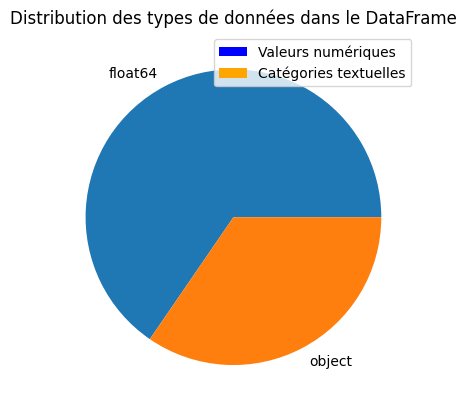

In [ ]:
df_openfoodfacts.dtypes.value_counts().plot.pie()
plt.title("Distribution des types de données dans le DataFrame")
custom_labels = ['Valeurs numériques', 'Catégories textuelles']
colors = ['blue', 'orange']
legend_handles = [Patch(facecolor=color, label=label) for label, color in zip(custom_labels, colors)]
plt.legend(handles=legend_handles)
plt.show()


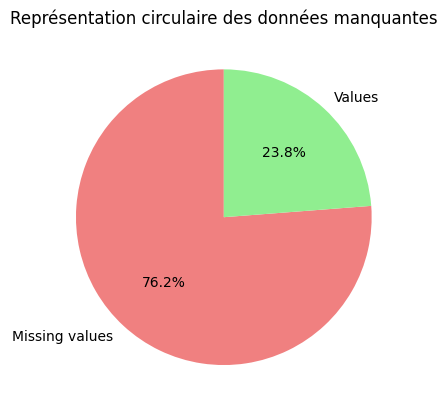

In [ ]:
# Aperçu graphique des données manquantes
total_values = df_openfoodfacts.count().sum()
total_no_values = df_openfoodfacts.isna().sum().sum()

total = pd.DataFrame({'Category': ['Missing values', 'Values'],
                      'Count': [total_no_values, total_values]})

plt.pie(total['Count'], labels=total['Category'], autopct='%1.1f%%', startangle=90, colors=['lightcoral', 'lightgreen'])
plt.title('Représentation circulaire des données manquantes')
plt.show()

In [ ]:
#Pourcentages de données manquantes dans les 162 colonnes présentes du Dataset
df_openfoodfacts.isnull().mean().sort_values()

last_modified_t                               0.000000
last_modified_datetime                        0.000000
creator                                       0.000006
created_t                                     0.000009
created_datetime                              0.000028
code                                          0.000072
url                                           0.000072
states                                        0.000143
states_tags                                   0.000143
states_fr                                     0.000143
countries_fr                                  0.000873
countries                                     0.000873
countries_tags                                0.000873
product_name                                  0.055373
brands                                        0.088574
brands_tags                                   0.088599
energy_100g                                   0.185986
proteins_100g                                 0.189699
salt_100g 

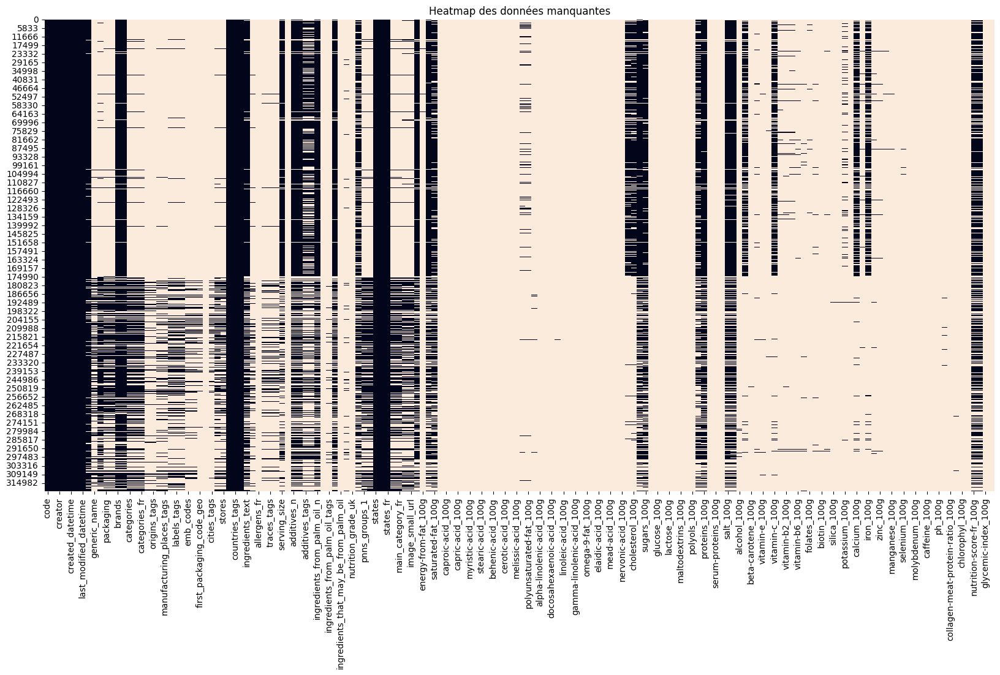

In [ ]:
#Répartition graphique des données manquantes par colonne
plt.figure(figsize=(20,10))
sns.heatmap(df_openfoodfacts.isna(),cbar=False)
plt.title("Heatmap des données manquantes")
plt.show()

In [ ]:
# Recherche du nombre de colonnes vides d'informations
no_values = df_openfoodfacts.columns[df_openfoodfacts.isna().all()].tolist()
print('Il y a ',len(no_values),'variables sans donnée.')

Il y a  16 variables sans donnée.


In [ ]:
#Affichage des noms des colonnes vides
print(no_values)

['no_nutriments', 'ingredients_from_palm_oil', 'ingredients_that_may_be_from_palm_oil', 'nutrition_grade_uk', 'butyric-acid_100g', 'caproic-acid_100g', 'lignoceric-acid_100g', 'cerotic-acid_100g', 'melissic-acid_100g', 'elaidic-acid_100g', 'mead-acid_100g', 'erucic-acid_100g', 'nervonic-acid_100g', 'chlorophyl_100g', 'glycemic-index_100g', 'water-hardness_100g']


In [ ]:
# Recherche du nombre de colonnes vides à 99% et plus
missing_values_99 = df_openfoodfacts.columns[(df_openfoodfacts.isna().mean()>=0.99) & (df_openfoodfacts.isna().mean() < 1)].tolist()
print('Il y a ',len(missing_values_99),'variables avec au moins 99% de données manquantes.')

Il y a  58 variables avec au moins 99% de données manquantes.


In [ ]:
#Affichage des noms de ces colonnes
print(missing_values_99)

['cities', 'allergens_fr', 'energy-from-fat_100g', 'caprylic-acid_100g', 'capric-acid_100g', 'lauric-acid_100g', 'myristic-acid_100g', 'palmitic-acid_100g', 'stearic-acid_100g', 'arachidic-acid_100g', 'behenic-acid_100g', 'montanic-acid_100g', 'omega-3-fat_100g', 'alpha-linolenic-acid_100g', 'eicosapentaenoic-acid_100g', 'docosahexaenoic-acid_100g', 'omega-6-fat_100g', 'linoleic-acid_100g', 'arachidonic-acid_100g', 'gamma-linolenic-acid_100g', 'dihomo-gamma-linolenic-acid_100g', 'omega-9-fat_100g', 'oleic-acid_100g', 'gondoic-acid_100g', 'sucrose_100g', 'glucose_100g', 'fructose_100g', 'lactose_100g', 'maltose_100g', 'maltodextrins_100g', 'starch_100g', 'polyols_100g', 'casein_100g', 'serum-proteins_100g', 'nucleotides_100g', 'beta-carotene_100g', 'vitamin-e_100g', 'vitamin-k_100g', 'folates_100g', 'biotin_100g', 'pantothenic-acid_100g', 'silica_100g', 'bicarbonate_100g', 'chloride_100g', 'copper_100g', 'manganese_100g', 'fluoride_100g', 'selenium_100g', 'chromium_100g', 'molybdenum_10

In [ ]:
# Recherche du nombre de colonnes vides à plus de 75 %
seuil = 0.75
nb_no_values_75 = df_openfoodfacts.columns[df_openfoodfacts.isna().mean() > seuil]
print('Il y a ',len(nb_no_values_75),'variables avec plus de 75% de données manquantes.')

Il y a  112 variables avec plus de 75% de données manquantes.


In [ ]:
#Affichage des noms de ces colonnes
print(nb_no_values_75)

Index(['generic_name', 'packaging', 'packaging_tags', 'origins',
       'origins_tags', 'manufacturing_places', 'manufacturing_places_tags',
       'labels', 'labels_tags', 'labels_fr',
       ...
       'caffeine_100g', 'taurine_100g', 'ph_100g',
       'fruits-vegetables-nuts_100g', 'collagen-meat-protein-ratio_100g',
       'cocoa_100g', 'chlorophyl_100g', 'carbon-footprint_100g',
       'glycemic-index_100g', 'water-hardness_100g'],
      dtype='object', length=112)


**Conclusion :**

- L'exploration de la forme du dataset révèle un ensemble de données substantiel, comprenant 320 772 lignes et 162 colonnes. Parmi ces colonnes, 106 sont de nature quantitative, tandis que 56 sont qualitatives. Cette diversité de types de variables suggère la présence d'une variété d'informations, des valeurs numériques aux catégories textuelles.  

- Cependant, une observation importante est la prévalence de valeurs manquantes dans le dataset. Un nombre significatif de colonnes (112) affichent au moins 75% de données manquantes, dont 58 sont presque entièrement vides, avec 99% ou plus de valeurs manquantes. De plus, 16 colonnes ne contiennent aucune donnée, signalant des lacunes substantielles.

---

Cela souligne la nécessité d'une gestion prudente des valeurs manquantes, avec une attention particulière portée à plus de 30 colonnes, dont le Nutri-Score inclus, où environ 31% des données sont manquantes.  

Afin de conserver des données réellement exploitables tout en préservant un maximum d'informations du dataset, je fais le choix de considérer les features qui ont moins de 75% de données manquantes. Cela permettra de maintenir une base de données plus robuste et de préserver un équilibre entre la qualité des données et la richesse des informations disponibles pour des analyses futures.

## Analyse de fond ##

Maintenant que nous avons éclairci la structure de notre dataset dans l'analyse de forme, je réalise une exploration approfondie avec l'analyse de fond préliminaire. Cette phase prépare notre jeu de données avant son nettoyage.

On retrouve dans cette étape :
- Les premiers filtrages du dataset
- L'examen de chaque colonne afin de concerver celles qui sont alignées sur nos objectifs d'analyse
- La recherche  et le traitement des doublons
- Les statistiques descriptives et les premières tendances.

In [ ]:
# Filtrage du Df avec le seuil de 75% & taille du DataFrame
df_openfoodfacts= df_openfoodfacts[df_openfoodfacts.columns[df_openfoodfacts.isna().sum()/df_openfoodfacts.shape[0]<= 0.75]]
df_openfoodfacts.shape

(320772, 50)

In [ ]:
# Affichage des colonnes après filtrage
df_openfoodfacts.columns

Index(['code', 'url', 'creator', 'created_t', 'created_datetime',
       'last_modified_t', 'last_modified_datetime', 'product_name', 'quantity',
       'brands', 'brands_tags', 'categories', 'categories_tags',
       'categories_fr', 'countries', 'countries_tags', 'countries_fr',
       'ingredients_text', 'serving_size', 'additives_n', 'additives',
       'additives_tags', 'additives_fr', 'ingredients_from_palm_oil_n',
       'ingredients_that_may_be_from_palm_oil_n', 'nutrition_grade_fr',
       'pnns_groups_1', 'pnns_groups_2', 'states', 'states_tags', 'states_fr',
       'main_category', 'main_category_fr', 'energy_100g', 'fat_100g',
       'saturated-fat_100g', 'trans-fat_100g', 'cholesterol_100g',
       'carbohydrates_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g',
       'salt_100g', 'sodium_100g', 'vitamin-a_100g', 'vitamin-c_100g',
       'calcium_100g', 'iron_100g', 'nutrition-score-fr_100g',
       'nutrition-score-uk_100g'],
      dtype='object')

In [ ]:
# Selection des colonnes qualitatives et quantitatives
select_columns_qualitatives=['code','product_name','pnns_groups_1','nutrition_grade_fr']
select_columns_quantitatives=['energy_100g','fiber_100g','fat_100g','saturated-fat_100g','cholesterol_100g','carbohydrates_100g','proteins_100g','salt_100g','sugars_100g','iron_100g','nutrition-score-fr_100g']

In [ ]:
# Création et aperçu du nouveau DataFrame avec la sélection des features
df_analysis = df_openfoodfacts[select_columns_qualitatives + select_columns_quantitatives]
df_analysis.head()

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
0,0000000003087,Farine de blé noir,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0000000004530,Banana Chips Sweetened (Whole),NaN,d,2243.0,3.6,28.57,28.57,0.018,64.29,3.57,0.00000,14.29,0.00129,14.0
2,0000000004559,Peanuts,NaN,b,1941.0,7.1,17.86,0.00,0.000,60.71,17.86,0.63500,17.86,0.00129,0.0
3,0000000016087,Organic Salted Nut Mix,NaN,d,2540.0,7.1,57.14,5.36,NaN,17.86,17.86,1.22428,3.57,0.00514,12.0
4,0000000016094,Organic Polenta,NaN,NaN,1552.0,5.7,1.43,NaN,NaN,77.14,8.57,NaN,NaN,NaN,NaN


In [ ]:
# Suppression des lignes où les données manquantes sont essentielles pour la suite
df_analysis = df_analysis.dropna(subset=['nutrition-score-fr_100g'])
df_analysis = df_analysis.dropna(subset=['code'])
df_analysis = df_analysis.dropna(subset=['product_name'])

In [ ]:
# Suppression des lignes avec plus de 75% de données manquantes
missing_values_rows = df_analysis.isna().sum(axis=1)
missing_values_rows_75 = df_analysis[missing_values_rows >= seuil * df_analysis.shape[1]]
missing_values_rows_75.count().sum()

0

In [ ]:
# Recherche des doublons dans le df & la colonne 'code'
doublons_code = df_analysis['code'].duplicated().sum()
print(f"Il y a {doublons_code} doublon(s) dans la colonne 'code'.")

Il y a 0 doublon(s) dans la colonne 'code'.


In [ ]:
# Conversion de la colonne product_ name en minuscule
df_analysis['product_name'] = df_analysis['product_name'].str.lower()

In [ ]:
# Recherche des doublons dans le df & la colonne 'product_name'
doublons_product_name = df_analysis['product_name'].duplicated().sum()
print(f"Il y a {doublons_product_name} doublons dans la colonne 'product name'.")

Il y a 61894 doublons dans la colonne 'product name'.


In [ ]:
# Suppression des doublons dans 'product name' en gardant la dernière entrée
df_analysis.drop_duplicates(subset=['product_name'], keep='last', inplace=True)

In [ ]:
# Statistiques descriptives des features quantitatives
df_analysis.describe()

,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
count,156420.000000,136263.000000,142189.000000,156420.000000,92432.000000,142167.000000,156420.000000,156420.000000,156420.000000,90599.000000,156569.000000
mean,1193.739933,2.862380,13.242948,5.058321,0.019774,34.256050,7.745039,1.796030,15.548778,0.003633,9.343938
std,1095.263754,15.250867,15.622862,7.716733,0.442121,28.401802,8.052222,163.217455,21.879483,0.208103,9.031658
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-17.860000,-0.000260,-14.000000
25%,491.000000,0.000000,1.100000,0.000000,0.000000,7.330000,2.100000,0.100000,1.400000,0.000000,1.000000
50%,1197.000000,1.500000,7.600000,1.800000,0.000000,26.560000,5.845000,0.635000,5.560000,0.001080,10.000000
75%,1736.000000,3.600000,21.430000,7.140000,0.019000,60.000000,10.710000,1.361440,24.700000,0.002510,16.000000
max,231199.000000,5380.000000,714.290000,550.000000,95.238000,190.000000,430.000000,64312.800000,3520.000000,50.000000,40.000000


In [ ]:
# Statistiques descriptives des features qualitatives
df_analysis.describe(exclude=np.number)

,code,product_name,pnns_groups_1,nutrition_grade_fr
count,156569,156569,46813,156569
unique,156569,156569,14,5
top,0000000004530,banana chips sweetened (whole),unknown,d
freq,1,1,8811,44698


In [ ]:
#Dimension du DataFrame après les premiers filtrages
temp_string = "Le DataFrame contient {} lignes et {} colonnes.".format( df_analysis.shape[0], df_analysis.shape[1])
temp_string

'Le DataFrame contient 156569 lignes et 15 colonnes.'

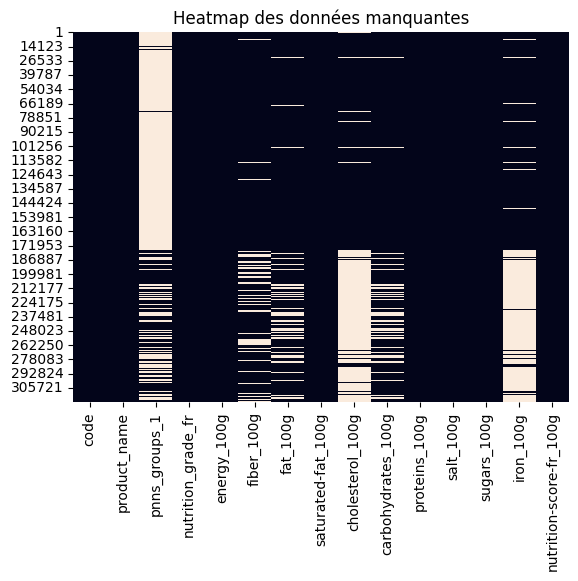

In [ ]:
# Représentation graphique des données manquantes dans ce Df
sns.heatmap(df_analysis.isna(),cbar=False)
plt.title("Heatmap des données manquantes")
plt.show()

**Conclusion:**

- Restriction de notre ensemble de données en sélectionnant des colonnes qualitatives et quantitatives spécifiques, pertinentes pour notre étude.Le DatFrame résultant comprend des informations cruciales telles que le code, le nom du produit, les groupes PNNS, la note et le grade nutritionnelle ainsi que diverses informations nutritionnelles par portion.
- Elimination des doublons dans la feature 'product_name', concernant la dernière entrée pour chaque produit.
- Suppression des lignes qui contenaient plus de 75% de données manquantes où les valeurs sont essentielles.

En conséquence, notre DataFrame consolidé contient maintenant 160544 lignes et 16 colonnes, prêt à être exploité pour des analyses plus avancées. Nous passons ensuite au nettoyage des données en recherchant et en traitant les valeurs 'aberrantes' et les données manquantes.

---
**Informations:**

Les variables qualitatives ont été méticuleusement choisies pour résoudre des problématiques de classification des produits, facilitant ainsi une compréhension approfondie de leur nature et de leur impact sur la santé.  

La sélection attentive des variables quantitatives s'inscrit dans une approche globale visant à traiter les préoccupations essentielles liées à la santé corporelle, mais également qui permet de cibler spécifiquement les régimes alimentaires nécessaires pour aborder un large éventail de problématiques de santé.  

En combinant ces deux aspects, notre ensemble de données se positionne comme une ressource riche et équilibrée, prête à être explorée sous l'angle de la nutrition, de la classification des produits, et de la réponse aux exigences spécifiques liées à la santé. Ce processus de sélection éclairé constitue une étape fondamentale dans la préparation de nos données pour des analyses plus avancées, visant à fournir des insights pertinents et à guider des décisions informées en matière de nutrition et de bien-être.

# Nettoyage des données #

Le nettoyage des données constitue une étape essentielle pour garantir la fiabilité et la qualité de notre ensemble de données.  
Nous aborderons 2 aspects fondamentaux : la gestion des valeurs aberrantes et le traitement des données manquantes.

On retrouve dans cette étape :
- Traitement des variables quantitatives
- Traitement des variables qualitatives

En combinant ces approches, nous visons à préparer un ensemble de données propre et robuste, prêt à être exploré de manière approfondie tout en assurant la solidité de nos conclusions futures.

## Variables quantitatives

### Fiber_100g

Les fibres jouent un rôle clé dans notre alimentation, impactant la digestion, le métabolisme, et la santé intestinale.

In [ ]:
#Analyse statistique de la feature avant traitement
df_analysis['fiber_100g'].describe()

count    136263.000000
mean          2.862380
std          15.250867
min           0.000000
25%           0.000000
50%           1.500000
75%           3.600000
max        5380.000000
Name: fiber_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='fiber_100g')
fig.update_layout(xaxis_type='log')
fig.show()

**Information:**  
Un aliment ne peut pas contenir plus de 100g de fibres pour 100g d’aliment, car cela dépasserait la quantité totale de l’aliment. En d’autres termes, si un aliment contient 100g de fibres pour 100g d’aliment, cela signifie qu’il est composé à 100% de fibres, ce qui n’est pas possible car les aliments contiennent généralement d’autres nutriments.

*NB: Plus d'informations sur ce [lien](https://www.passeportsante.net/fr/Nutrition/PalmaresNutriments/Fiche.aspx?doc=fibres)*  
*NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)*

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de fibres supérieurs ou égales à 100g
df_analysis['code'][df_analysis['fiber_100g']>=100].count()

9

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_fiber = df_analysis[df_analysis['fiber_100g'] >=100]
df_fiber

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
86625,0074410530525,"yamashin, powdered agar-agar",NaN,b,1046.0,100.0,0.0,0.0,0.0,75.0,0.0,0.63500,0.0,0.009,0.0
127525,0698502500571,savarez - jeu de cordes,NaN,a,4.0,100.0,NaN,0.1,NaN,NaN,100.0,0.00000,0.1,NaN,-10.0
170118,0883929140886,harry potter & the deathly hallows radcliffe /...,unknown,a,4.0,100.0,NaN,0.0,NaN,NaN,100.0,0.00000,0.0,NaN,-10.0
244661,3590670000174,noix sèches,unknown,a,0.0,100.0,0.0,0.0,NaN,0.0,0.0,0.00000,0.0,NaN,-5.0
273543,5051889553625,le hobbit : la bataille des cinq armés - versi...,NaN,a,4.0,100.0,NaN,0.0,NaN,NaN,100.0,0.00000,0.0,NaN,-10.0
283105,6091035082004,eau,NaN,e,418.0,100.0,NaN,100.0,NaN,NaN,100.0,2.00000,100.0,NaN,24.0
285429,7340055304214,marshall - major noir,NaN,c,21.0,100.0,NaN,5.0,NaN,NaN,100.0,50.00000,5.0,NaN,10.0
298897,7622210988768,milka schmunzelhase alpenmilch 175g,unknown,e,2218.0,178.0,29.0,18.0,NaN,59.0,6.3,0.37000,58.0,NaN,22.0
313506,8710573641501,"nusco, chocolate spread, chocolate",NaN,e,231199.0,5380.0,NaN,550.0,NaN,NaN,430.0,0.01016,3520.0,NaN,25.0


In [ ]:
# Suppression des lignes de produits non alimentaires
indices_a_supprimer = [127525, 170118, 273543, 285429,283105]
df_analysis.drop(indices_a_supprimer, inplace=True)

In [ ]:
# Verification sur le site OpenFoodFacts et mise à jour des valeurs nutritionnelles
df_analysis.at[244661,'energy_100g']=2941
df_analysis.at[244661,'fiber_100g']=5.6
df_analysis.at[244661,'fat_100g']=64.3
df_analysis.at[244661,'saturated-fat_100g']=5.4
df_analysis.at[244661,'carbohydrates_100g']=11.3
df_analysis.at[244661,'proteins_100g']=14.3
df_analysis.at[244661,'salt_100g']=0
df_analysis.at[244661,'sugars_100g']=0

In [ ]:
# Pas de données ou peu cohérentes - mise en NaN pour traitement ultérieur
df_analysis.at[298897,'fiber_100g']=np.nan
df_analysis.at[86625,'fiber_100g']=np.nan

In [ ]:
# # Verification sur le site OpenFoodFacts et mise à jour des valeurs nutritionnelles
df_analysis.at[313506,'energy_100g']= 2310
df_analysis.at[313506,'fiber_100g']=3.6
df_analysis.at[313506,'fat_100g']=35
df_analysis.at[313506,'saturated-fat_100g']=5.5
df_analysis.at[313506,'carbohydrates_100g']=53.8
df_analysis.at[313506,'proteins_100g']=4.3
df_analysis.at[313506,'salt_100g']=0.1
df_analysis.at[313506,'sugars_100g']=52.3

In [ ]:
#Fonction pour les données supérieure ou égale à 100
def fiber_sup_100g_par_nan():
    global df_analysis

    condition_fiber_superieur_100g = df_analysis['fiber_100g'] >= 100
    df_analysis.loc[condition_fiber_superieur_100g, 'fiber_100g'] = np.nan

    return df_analysis

df_analysis = fiber_sup_100g_par_nan()

In [ ]:
# Fonction de remplissage des données NaN par 0
def fiber_nan_par_zero(df_analysis):
    df_analysis['fiber_100g'] = df_analysis['fiber_100g'].fillna(0)
    return df_analysis

df_analysis = fiber_nan_par_zero(df_analysis)

**Raisonnement**

L'option de remplacer les valeurs manquantes (NaN) dans la colonne 'fiber_100g' par 0 a été prise pour des raisons spécifiques liées à la nature de la teneur en fibres dans les produits alimentaires (plus d'infos : https://leblognutrition.fr/aliments-sans-fibres-2/) .   


In [ ]:
#Analyse statistique après traitement
df_analysis['fiber_100g'].describe()

count    156564.000000
mean          2.451315
std           4.246034
min           0.000000
25%           0.000000
50%           0.900000
75%           3.300000
max          99.000000
Name: fiber_100g, dtype: float64

In [ ]:

# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='fiber_100g')
fig.update_layout(xaxis_type='log')
fig.show()

**Conclusion:**

- ***Approche Métiers:*** En attribuant la valeur 0 aux données manquantes sur la teneur en fibres, nous préservons une représentation réaliste des produits alimentaires dans notre analyse. Cette méthode pragmatique admet que l’absence de données ne signifie pas nécessairement une absence totale de fibres, permettant ainsi une évaluation plus exhaustive des caractéristiques nutritionnelles.

- ***Approche Analytique:*** En attribuant 0 aux valeurs manquantes, nous préservons l’intégrité et l’uniformité de notre base de données. Cette méthode prévient toute déformation potentielle dans nos calculs et comparaisons, assurant que chaque produit, même ceux qui ne disposent pas d’informations spécifiques sur la teneur en fibres, a une contribution équitable à l’analyse.


### Salt_100g

La consommation de sel est un aspect essentiel à considérer dans une alimentation équilibrée, et sa modération est recommandée pour maintenir une bonne santé.

In [ ]:
# Analyse statistique de la feature avant traitement
df_analysis['salt_100g'].describe()

count    156415.000000
mean          1.795756
std         163.220018
min           0.000000
25%           0.100000
50%           0.635000
75%           1.361440
max       64312.800000
Name: salt_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='salt_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Information:**  
Un produit alimentaire ne peut pas contenir plus de 100g de sel pour 100g d’aliment, car cela dépasserait la quantité totale de celui-ci.  
Seul les aliments purs de sel peuvent contenir 100g de sel pour 100g de produits car il est composé de 100g de l'aliment.

*NB: Plus d'informations sur ce [lien](https://sante.journaldesfemmes.fr/fiches-nutrition/2544426-aliments-riches-en-sel-la-liste/)*  
*NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)*

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de sel supérieurs à 100g
df_analysis['code'][df_analysis['salt_100g']>100].count()

40

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_salt = df_analysis[df_analysis['salt_100g'] >100]
df_salt

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
11129,0013964151954,autumn cookie selection,NaN,e,2025.0,1.600,30.65,2.420,0.04000,48.39,4.84,327.74128,22.58,0.002320,21.0
20821,0024000163114,"special blend, peas & carrots",NaN,c,197.0,3.100,0.00,0.000,0.00000,10.16,2.34,714.37500,3.12,0.000840,5.0
21892,0025315248701,"marie sharp's, orange pulp habanero pepper sau...",NaN,e,2008.0,34.000,0.00,0.000,0.00000,90.00,14.00,594.86800,44.00,0.008170,19.0
28787,0033717200159,"fratelli comino, tochetti with sea salt",NaN,d,1812.0,3.300,13.33,3.330,0.00000,70.00,10.00,177.80000,3.33,0.001200,14.0
32371,0036632038258,light & fit greek crunch - s'mores,unknown,d,386.0,0.709,1.77,0.709,0.00355,11.30,7.80,153.00000,7.80,0.000511,11.0
55514,0042608432029,pure carrot with organic lemon juice,NaN,c,176.0,0.800,0.00,0.000,0.00000,9.58,0.83,158.75000,4.17,0.000300,9.0
58007,0046100007013,string cheese snacks,NaN,e,1222.0,0.000,18.75,12.500,62.50000,4.17,25.00,1799.16582,0.00,0.000000,23.0
68379,0070022001491,"rhodes, bake n serv, cinnamon rolls with cream...",NaN,d,1243.0,1.400,8.11,2.700,0.00000,48.65,5.41,1098.37728,9.46,0.002430,16.0
68388,0070022007493,"rhodes, bake n serv, cinnamon rolls with cream...",NaN,d,1238.0,1.400,7.04,2.110,0.00000,50.70,5.63,858.59112,11.27,0.002540,16.0
94631,0077890357378,swiss recipe smoked almonds & sea salt in dark...,NaN,e,2322.0,7.100,40.48,14.290,0.00500,45.24,9.52,1318.38192,33.33,0.014140,28.0


In [ ]:
# Aperçu détailllé de ces lignes avec conditions
df_salt = df_analysis[(df_analysis['product_name'].str.contains('salt', case=False, na=False))
                      & (df_analysis['salt_100g'] > 100)
                      & (df_analysis['energy_100g'] == 0)]
df_salt

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
132084,0715483075314,roasted garlic & himalayan pink salt seasoning,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,107.10418,0.0,0.0,10.0
132086,0715483075369,habanero & himalayan pink salt seasoning,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,101.23678,0.0,0.0,10.0
132087,0715483075376,himalayan pink salt seasoning,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,112.18418,0.0,0.0,10.0
132090,0715483075499,sriracha & himalayan pink salt seasoning,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,104.86644,0.0,0.0,10.0
149081,0810776022478,"jim kelly, sea salt adjustable grinder",NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100.01250,0.0,0.0,10.0
177375,20035372,applewood smoked sea salt,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,101.60000,0.0,0.0,10.0
177376,20035389,himalayan pink salt,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,106.68000,0.0,0.0,10.0
177379,20035433,mediterranean coarse sea salt,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,105.83418,0.0,0.0,10.0
279614,54130979000399,organic dill salt,NaN,c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,100.51034,0.0,NaN,10.0


In [ ]:
# Fonction de modification des produits de 'sel'
def salt_max():
    global df_analysis

    condition1 = df_analysis['product_name'].str.contains('salt', case=False, na=False)
    condition2 = df_analysis['salt_100g'] > 100
    condition3 = df_analysis['energy_100g'] == 0

    df_selected = df_analysis[condition1 & condition2 & condition3]
    df_analysis.loc[df_selected.index, 'salt_100g'] = 100

    return df_analysis


df_analysis = salt_max()

In [ ]:
# Fonction de modification des autres produits
def salt_sup_100g_par_nan():
    global df_analysis

    condition_salt_superieur_100g = df_analysis['salt_100g'] > 100

    df_analysis.loc[condition_salt_superieur_100g, 'salt_100g'] = np.nan

    return df_analysis

df_analysis = salt_sup_100g_par_nan()

In [ ]:
# Fonction pour remplacer les NaN par la médiane
def salt_nan_par_mediane(df_analysis):

    mediane_salt = df_analysis['salt_100g'].median(skipna=True)

    df_analysis['salt_100g'].fillna(mediane_salt, inplace=True)

    return df_analysis


df_analysis = salt_nan_par_mediane(df_analysis)

In [ ]:
#Analyse statistique après traitement
df_analysis['salt_100g'].describe()

count    156564.000000
mean          1.260847
std           4.126603
min           0.000000
25%           0.100000
50%           0.635000
75%           1.358900
max         100.000000
Name: salt_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='salt_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Conclusion:**

- ***Approche Métiers:*** Le choix de traiter les valeurs manquantes dans 'salt_100g' par la médiane permet d’assurer une représentation réaliste de la teneur en sel des produits alimentaires. Cette décision est soutenue par des sources externes, comme indiqué sur le site:  https://www.unedietedechef.fr/regime-sans-sucre-ni-sel/.  

- ***Approche Analytique:***  En remplaçant les valeurs manquantes par la médiane (0.635), nous préservons la cohérence des données, minimisant ainsi les distorsions potentielles dans les calculs et les comparaisons. La présence de produits alimentaires avec des teneurs en sel extrêmes, comme le sel d’Himalaya, peut fausser la moyenne de la caractéristique. C’est pourquoi le choix de la médiane offre une meilleure représentation de la distribution des données.

### Cholesterol_100g

Le cholestérol présent dans notre alimentation joue un rôle clé dans la santé cardiovasculaire. Comprendre les sources et les types de cholestérol alimentaire est essentiel pour adopter des habitudes alimentaires équilibrées et promouvoir le bien-être cardiaque.

In [ ]:
# Analyse statistique de la feature avant traitement
df_analysis['cholesterol_100g'].describe()

count    92432.000000
mean         0.019774
std          0.442121
min          0.000000
25%          0.000000
50%          0.000000
75%          0.019000
max         95.238000
Name: cholesterol_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='cholesterol_100g')
fig.update_layout(xaxis_type="-")
fig.show()


**Information:**  

Un produit alimentaire ne peut pas contenir plus de 100g de cholestérol pour 100g d’aliment, car cela dépasserait la quantité totale de celui-ci.  

**Raisonnement:**  
L'aliment le plus riche en cholestérol est la cervelle de veau cuite pour 3.1g de cholestérol pour 100g.  


*NB: Plus d'informations sur ce [lien](https://sante.journaldesfemmes.fr/calories/classement/aliments/cholesterol)*  
*NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)*

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de cholestérol supérieurs à 3,1g
df_analysis['code'][df_analysis['cholesterol_100g']>3.1].count()

3

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_cholesterol = df_analysis[df_analysis['cholesterol_100g'] >3.1]
df_cholesterol

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
58007,0046100007013,string cheese snacks,NaN,e,1222.0,0.0,18.75,12.50,62.500,4.17,25.00,0.63500,0.0,0.00000,23.0
137796,0736547010447,sliced havarti jalapeno,NaN,e,1594.0,0.0,38.10,23.81,95.238,0.00,23.81,1.63322,0.0,0.00000,21.0
284888,718133065370,"organic chocolate ice cream, bittersweet choco...",NaN,c,937.0,3.5,12.94,8.24,70.588,24.71,4.71,0.08890,20.0,0.00169,10.0


In [ ]:
# Au vue des autres taux présents dans le tableau, nous supposons qu'il s'agit d'un problème de gramme.
# Nous décidons de traiter les données en les convertissant en g et non en mg.

df_analysis.at[58007,'cholesterol_100g']=62.500/1000
df_analysis.at[137796,'cholesterol_100g']=95.238/1000
df_analysis.at[284888,'cholesterol_100g']=70.588/1000

In [ ]:
# Fonction remplacement des produits avec plus de 4g de cholestérol en NaN
def cholesterol_sup_4g_par_nan():
    global df_analysis

    condition = df_analysis['cholesterol_100g'] > 4

    df_analysis.loc[condition, 'cholesterol_100g'] = np.nan

    return df_analysis

df_analysis = cholesterol_sup_4g_par_nan()

In [ ]:
# Fonction pour remplir les NaN par la moyenne
def cholesterol_nan_par_moyenne(df_analysis):

    moyenne_cholesterol = df_analysis['cholesterol_100g'].mean(skipna=True)

    df_analysis['cholesterol_100g'].fillna(moyenne_cholesterol, inplace=True)

    return df_analysis


df_analysis = cholesterol_nan_par_moyenne(df_analysis)

In [ ]:
#Analyse statistique après traitement
df_analysis['cholesterol_100g'].describe()

count    156564.000000
mean          0.017307
std           0.027325
min           0.000000
25%           0.000000
50%           0.017307
75%           0.017307
max           1.291000
Name: cholesterol_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='cholesterol_100g')
fig.update_layout(xaxis_type="-")
fig.show()

**Conclusion:**

- ***Approche Métiers:*** Lors de l’analyse des valeurs aberrantes, nous avons pris des décisions stratégiques basées sur des observations clés. Par exemple, la cervelle de veau cuite a été identifiée comme l’aliment avec la concentration de cholestérol la plus élevée, ce qui a influencé notre traitement des valeurs aberrantes.


- ***Approche Analytique:*** Notre analyse a révélé une dispersion modérée dans les données, avec un écart type de 0.027, indiquant une faible variabilité. Après le traitement des données, nous avons observé que les valeurs minimales et maximales ont montré des variations limitées. Par conséquent, nous avons opté pour l’imputation des valeurs manquantes par la moyenne. Cette approche assure une représentation équilibrée et précise de l’ensemble des données.


### Proteins_100g

Les protéines, blocs de construction essentiels de la vie, jouent un rôle fondamental dans le fonctionnement cellulaire, la croissance musculaire et la régulation métabolique.

In [ ]:
# Analyse statistique de la feature avant traitement
df_analysis['proteins_100g'].describe()

count    156415.000000
mean          7.739460
std           7.964189
min           0.000000
25%           2.100000
50%           5.840000
75%          10.710000
max         100.000000
Name: proteins_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='proteins_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Information:**

Un produit alimentaire ne peut pas contenir plus de 100g de protéines pour 100g d’aliment, car cela dépasserait la quantité totale de celui-ci. Cependant certains aliments protéinés spécifiques sont extrèmement riches.

**Raisonnement:**  

Les aliments les plus riches en protéines sont des poudres protéinées ou encore la gélatine alimentaire (84.5g)

NB: Plus d'informations sur ce [lien](https://toutpourmasante.fr/aliments-riches-proteines/)

NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de proteines supérieurs ou égals à 100g
df_analysis['code'][df_analysis['proteins_100g']>90].count()

9

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_proteins = df_analysis[df_analysis['proteins_100g'] >90]
df_proteins

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
13370,0016473902352,"bari, pomegranate balsamic vinegar",NaN,c,724.0,0.0,0.0,0.0,0.000000,40.0,93.33,0.05080,38.33,NaN,5.0
71066,0070552903203,unflavored gelatin,NaN,b,1795.0,0.0,0.0,0.0,0.017307,0.0,100.00,0.36322,0.00,NaN,1.0
132896,0718122726011,"bari, balsamic vinegar, fig",NaN,c,724.0,0.0,0.0,0.0,0.000000,40.0,93.33,0.05080,38.33,NaN,5.0
150075,0812603011556,tcho-a-day dark chocolate,NaN,e,2301.0,0.0,35.0,22.5,0.000000,55.0,100.00,0.00000,40.00,0.00495,24.0
198798,3183280016354,le saunier de camargue,unknown,e,243.0,0.0,NaN,36.0,0.017307,NaN,96.00,100.00000,0.50,NaN,20.0
213017,3257983765946,edulcorant a l'extrait de stevia,unknown,b,1556.0,0.0,NaN,0.0,0.017307,NaN,93.10,0.08000,6.90,NaN,0.0
222741,3286011051744,"lingettes pocket pour visage et mains, biodégr...",unknown,d,1912.0,1.0,NaN,6.0,0.017307,NaN,99.00,2.00000,6.00,NaN,18.0
228018,3350033331259,fromage blanc brebis,NaN,a,364.0,0.0,NaN,3.2,0.017307,NaN,94.70,0.10000,2.90,NaN,-1.0
303889,8009958000218,mini gressins,NaN,d,1640.0,3.5,NaN,4.0,0.017307,NaN,95.00,2.00000,2.50,NaN,11.0


**Remarque:**


In [ ]:
# Suppression de la ligne de produit non alimentaire
indices_a_supprimer = [222741]
df_analysis.drop(indices_a_supprimer, inplace=True)

In [ ]:
# Verification sur le site OpenFoodFacts et mise à jour des valeurs nutritionnelles
df_analysis.at[198798,'energy_100g']= 0
df_analysis.at[198798,'fiber_100g']=0
df_analysis.at[198798,'fat_100g']=0
df_analysis.at[198798,'saturated-fat_100g']=0
df_analysis.at[198798,'carbohydrates_100g']=0
df_analysis.at[198798,'proteins_100g']=0
df_analysis.at[198798,'salt_100g']=98.4
df_analysis.at[198798,'sugars_100g']=0

In [ ]:
df_analysis.at[213017,'energy_100g']= 1607
df_analysis.at[213017,'fiber_100g']=0
df_analysis.at[213017,'fat_100g']=0.01
df_analysis.at[213017,'saturated-fat_100g']=0
df_analysis.at[213017,'carbohydrates_100g']=96
df_analysis.at[213017,'proteins_100g']=0
df_analysis.at[213017,'salt_100g']=0.08
df_analysis.at[213017,'sugars_100g']=6.7

In [ ]:
df_analysis.at[228018,'energy_100g']= 365
df_analysis.at[228018,'fat_100g']=4.5
df_analysis.at[228018,'carbohydrates_100g']=5.8
df_analysis.at[228018,'proteins_100g']=5.9
df_analysis.at[228018,'salt_100g']=0.13
df_analysis.at[228018,'sugars_100g']=3.6

In [ ]:
df_analysis.at[303889,'energy_100g']= 1652
df_analysis.at[303889,'fat_100g']=8.5
df_analysis.at[303889,'carbohydrates_100g']=67.5
df_analysis.at[303889,'proteins_100g']=9.5

In [ ]:
# Fonction remplacement des produits égals ou supérieurs à 100g de protéines en NaN
def proteins_supegal_90g_par_nan():
    global df_analysis

    condition = df_analysis['proteins_100g'] >90

    df_analysis.loc[condition, 'proteins_100g'] = np.nan

    return df_analysis

df_analysis = proteins_supegal_90g_par_nan()

In [ ]:
# Fonction pour remplir les NaN par la médiane
def proteins_nan_par_mediane(df_analysis):

    mediane_proteins = df_analysis['proteins_100g'].median(skipna=True)

    df_analysis['proteins_100g'].fillna(mediane_proteins, inplace=True)

    return df_analysis


df_analysis = proteins_nan_par_mediane(df_analysis)

In [ ]:
#Analyse statistique après traitement
df_analysis['proteins_100g'].describe()

count    156563.000000
mean          7.732418
std           7.932460
min           0.000000
25%           2.100000
50%           5.830000
75%          10.710000
max          90.000000
Name: proteins_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='proteins_100g')
fig.update_layout(xaxis_type="-")
fig.show()

**Conclusion:**

- ***Approche Métiers:*** Les décisions prises lors du traitement des valeurs aberrantes ont été guidées par la reconnaissance que certains aliments, comme les protéines en poudre ou la gélatine alimentaire, sont exceptionnellement riches en protéines. Cela a aidé à déterminer ce qui pourrait être considéré comme une valeur aberrante dans ce contexte. De plus, la compréhension que la teneur en protéines peut varier considérablement d’un aliment à l’autre a informé l’approche de remplissage des données manquantes.  

- ***Approche Analytique:*** Après avoir examiné les statistiques descriptives, il est clair que la distribution présente une certaine asymétrie, comme en témoigne l’écart entre la moyenne et la médiane. De plus, l’écart type indique une dispersion significative des données. Dans ce contexte, le choix d’utiliser la médiane pour imputer les valeurs manquantes est judicieux car elle est moins sensible aux valeurs extrêmes et offre une meilleure représentation de la tendance centrale pour des distributions asymétriques.

### Iron_100g

Le fer est un oligo-élément vital pour le transport de l’oxygène dans le corps et le soutien du système immunitaire.

In [ ]:
# Analyse statistique de la feature avant traitement
df_analysis['iron_100g'].describe()

count    90599.000000
mean         0.003633
std          0.208103
min         -0.000260
25%          0.000000
50%          0.001080
75%          0.002510
max         50.000000
Name: iron_100g, dtype: float64

**Remarque**: Présence de données négatives

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='iron_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Information:** Aucun produit alimentaire ne peut contenir une quantité négative de fer. La teneur minimale en fer pour tout produit alimentaire est de 0g.  


**Raisonnement:** L’aliment le plus riche en fer est le thym déshydraté, qui contient 0.124g de fer pour 100g.

NB: Plus d’informations sur ce [lien](https://toutpourmasante.fr/aliments-riches-fer/).  
NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/).

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de fer inférieurs à 0g
df_analysis['code'][df_analysis['iron_100g']< 0].count()

1

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_iron = df_analysis[df_analysis['iron_100g'] < 0]
df_iron

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
316892,8850649009290,"lamthong, fruit cocktail in syrup",NaN,b,297.0,1.4,0.0,0.0,0.0,16.43,0.71,0.0,14.29,-0.00026,2.0


**Remarque:**  
Suite à une étude détaillée, il est crucial de préciser qu’il n’est pas possible de garantir une amélioration optimale des informations nutritionnelles. Par conséquent, cette ligne sera traitée avec la gestion des données manquantes par une fonction définie.

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de fer est supérieur à 0.130g
df_analysis['code'][df_analysis['iron_100g']>=0.130].count()

23

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_iron = df_analysis[df_analysis['iron_100g'] >= 0.130]
df_iron

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
4461,0011110877437,original no bean chili,NaN,c,406.0,1.30,5.08,2.54,0.021000,6.78,5.93,1.04394,1.27,6.35593,3.0
14313,0018627740001,go lean cereals,unknown,a,1130.0,19.20,1.92,0.00,0.017307,57.70,25.00,0.41500,11.50,19.20000,-4.0
23570,0028190007807,unpopped popcorn,NaN,d,1904.0,9.10,27.27,9.09,0.000000,51.52,6.06,1.92532,0.00,12.12121,17.0
65917,0055270857779,caribbean traditions thyme leaves,NaN,b,0.0,0.00,0.00,0.00,0.000000,0.00,0.00,0.00000,0.00,0.18000,0.0
82253,0072869351012,boiled salted duck eggs,NaN,d,891.0,0.00,16.44,5.33,0.465000,2.04,14.18,2.59842,0.00,2.80000,17.0
86418,0074333377573,natural sweetened shredded wheat bite size cereal,NaN,a,1611.0,9.60,1.92,0.00,0.000000,82.69,9.62,0.00000,21.15,11.53846,-2.0
86616,0074410396497,"goku-uma ramen-noodles, miso",NaN,e,1515.0,2.90,16.19,9.52,0.000000,45.71,8.57,6.28904,4.76,2.85714,20.0
123679,0678108107190,sweet rice,NaN,a,1393.0,0.00,0.00,0.00,0.000000,88.89,8.89,0.00000,0.00,3.11111,-1.0
132323,0716519020162,broccoli wokly,NaN,a,146.0,2.40,0.00,0.00,0.000000,7.06,2.35,0.08890,1.18,4.70588,-4.0
138144,0737483987688,palm sugar,NaN,d,1569.0,0.00,0.00,0.00,0.000000,100.00,0.00,0.00000,100.00,50.00000,14.0


In [ ]:
# Modification des valeurs après consultation du site Openfoodfacts

df_analysis.at[171085,'iron_100g']=0

df_analysis.at[171085,'energy_100g']=136
df_analysis.at[171085,'fiber_100g']=0
df_analysis.at[171085,'fat_100g']=2.25
df_analysis.at[171085,'saturated-fat_100g']=1.5
df_analysis.at[171085,'cholesterol_100g']=0.045
df_analysis.at[171085,'carbohydrates_100g']=0.5
df_analysis.at[171085,'proteins_100g']=2.25
df_analysis.at[171085,'salt_100g']=0.219
df_analysis.at[171085,'sugars_100g']=0

In [ ]:
df_analysis.at[213804,'iron_100g']=0

df_analysis.at[213804,'energy_100g']=653
df_analysis.at[213804,'fiber_100g']=5.5
df_analysis.at[213804,'fat_100g']=8.5
df_analysis.at[213804,'saturated-fat_100g']=1.3
df_analysis.at[213804,'carbohydrates_100g']=3
df_analysis.at[213804,'proteins_100g']=14
df_analysis.at[213804,'salt_100g']=1
df_analysis.at[213804,'sugars_100g']=0.8

In [ ]:
df_analysis.at[317615,'iron_100g']=0.00155

In [ ]:
df_analysis.at[4461,'iron_100g']=0.00114
df_analysis.at[4461,'cholesterol_100g']=0.021

df_analysis.at[14313,'iron_100g']=0.00346
df_analysis.at[82253,'iron_100g']=0.00273
df_analysis.at[123679,'iron_100g']=0.00311
df_analysis.at[132323,'iron_100g']=0.0047
df_analysis.at[138144,'iron_100g']=0.009
df_analysis.at[173034,'iron_100g']=0.0037
df_analysis.at[187526,'iron_100g']=0.0042
df_analysis.at[218058,'iron_100g']=0.0024

df_analysis.at[223030,'energy_100g']=1636
df_analysis.at[223030,'carbohydrates_100g']=76
df_analysis.at[223030,'sugars_100g']=21
df_analysis.at[223030,'iron_100g']=0.0028

df_analysis.at[251403,'energy_100g']=1668
df_analysis.at[251403,'fiber_100g']=11
df_analysis.at[251403,'fat_100g']=11
df_analysis.at[251403,'saturated-fat_100g']=3.3
df_analysis.at[251403,'carbohydrates_100g']=58
df_analysis.at[251403,'salt_100g']=0.03
df_analysis.at[251403,'sugars_100g']=11
df_analysis.at[251403,'iron_100g']=0.0031

df_analysis.at[268038,'iron_100g']=0.0007

In [ ]:
#Fonction remplacement des données inférieures à ou supérieur à 0.130g par NaN
def iron_moins_0_ou_sup_130mg_par_nan():
    global df_analysis

    condition1 = df_analysis['iron_100g'] >= 0.130
    condition2 = df_analysis['iron_100g'] < 0

    df_analysis.loc[condition1 | condition2, 'iron_100g'] = np.nan

    return df_analysis

df_analysis = iron_moins_0_ou_sup_130mg_par_nan()

In [ ]:
# Fonction traitement des NaN en remplaçant par la moyenne
def iron_nan_par_moyenne(df_analysis):

    moyenne_iron = df_analysis['iron_100g'].mean(skipna=True)

    df_analysis['iron_100g'].fillna(moyenne_iron, inplace=True)

    return df_analysis


df_analysis = iron_nan_par_moyenne(df_analysis)

In [ ]:
# Exception de ce produit, après vérification il s’agit d’une valeur atypique et non aberrante.
df_analysis.at[65917,'iron_100g']=0.18

In [ ]:
# Analyse statistique de la feature avant traitement
df_analysis['iron_100g'].describe()

count    156563.000000
mean          0.001878
std           0.002690
min           0.000000
25%           0.000770
50%           0.001877
75%           0.001877
max           0.180000
Name: iron_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='iron_100g')
fig.update_layout(xaxis_type="-")
fig.show()

**Conclusion:**

- ***Approche Métiers:*** Nos décisions sont basées sur l'observation de la teneur en fer du thym déshydraté. Cet aliment a été identifié comme ayant la concentration de fer la plus élevée.

- ***Approche Analytique:*** Notre analyse a révélé une dispersion modérée dans les données. Après le traitement des données, nous avons observé que les valeurs minimales et maximales ont montré des variations limitées, et que la moyenne et la médiane était très similaire. Nous choisissons de traiter les valeurs manquantes avec la moyenne pour assurer une représentation équilibrée.

---

**Explications :**
Nous allons nous concentrer sur l’analyse des variables Sugar, Energy, Carbohydrates, Fat et Saturated Fat. Notre objectif est de comprendre leur distribution, leur corrélation et leur impact sur notre modèle.

Nous commencerons par le traitement des valeurs aberrantes. Cette étape est cruciale car elle nous permet d’éliminer les valeurs qui pourraient fausser nos résultats et rendre notre modèle moins précis. Nous expliquerons comment nous avons identifié ces valeurs aberrantes et comment nous les avons traitées.

Une fois que nous aurons traité les valeurs aberrantes, nous utiliserons la méthode IterativeImputer pour imputer les valeurs manquantes dans ces variables. Cette méthode est particulièrement efficace car elle tient compte de la structure de corrélation entre les variables pour estimer les valeurs manquantes.

### Sugars_100g

Le sucre, un élément omniprésent dans notre alimentation, joue un rôle essentiel en fournissant l’énergie nécessaire à notre corps.
Bien que nécessaire à notre organisme, il peut être nuisible en excès, contribuant à divers problèmes de santé.

In [ ]:
# Analyse statistique de la feature
df_analysis['sugars_100g'].describe()

count    156414.000000
mean         15.526501
std          20.004228
min         -17.860000
25%           1.400000
50%           5.560000
75%          24.700000
max         104.000000
Name: sugars_100g, dtype: float64

**Remarque**: Présence de données négatives

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='sugars_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Information:**  
Un produit alimentaire ne peut pas contenir plus de 100g de sucre pour 100g d’aliment, car cela dépasserait la quantité totale de celui-ci.  
Seul les aliments purs de sucre peuvent contenir 100g de sucre pour 100g de produits car il est composé de 100g de l'aliment.

*NB: Plus d'informations sur ce [lien](https://www.cultures-sucre.com/sucre-et-alimentation/la-teneur-en-sucres-des-aliments/)*  
*NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)*

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de sucre supérieurs à 100g
df_analysis['code'][df_analysis['sugars_100g']>100].count()

3

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_sugars = df_analysis[df_analysis['sugars_100g'] > 100]
df_sugars

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
202571,3229820787909,sirop d'agave brun bio,unknown,d,1760.0,0.0,0.0,0.0,0.017307,104.0,0.0,0.14,104.0,0.001877,15.0
260598,4016249014940,agave syrup dark,unknown,d,1760.0,0.0,1.0,1.0,0.017307,103.5,1.0,0.10,103.5,0.001877,15.0
260599,4016249015732,sirop d agave pur,unknown,d,1760.0,0.0,1.0,0.1,0.017307,103.5,1.0,0.10,103.5,0.001877,15.0


In [ ]:
# Fonction sur les sirops d'agave supérieur à 100g
def sugars_sup_100_agave():
    global df_analysis

    condition1 = df_analysis['product_name'].str.contains('agave', case=False, na=False)
    condition2 = df_analysis['sugars_100g'] > 100

    df_selected = df_analysis[condition1 & condition2]
    df_analysis.loc[df_selected.index, 'sugars_100g'] = 100

    return df_analysis


df_analysis =sugars_sup_100_agave()

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de sucre inférieurs à 0g
df_analysis['code'][df_analysis['sugars_100g']<0].count()

6

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_sugars = df_analysis[df_analysis['sugars_100g'] < 0]
df_sugars

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
8582,0011213420608,grade a fancy chopped spinach,NaN,a,151.0,1.2,0.00,0.00,0.000000,3.61,2.41,0.38354,-1.20,0.000870,-1.0
18209,0021130493432,"select, spicy red bell pepper pasta sauce",NaN,b,167.0,0.8,0.80,0.00,0.000000,7.20,0.80,0.87376,-0.80,0.001877,2.0
117739,0608866999263,"hummous, black truffle",NaN,a,598.0,3.6,3.57,0.00,0.000000,21.43,7.14,0.95250,-3.57,0.001290,-4.0
150858,0813922021028,"italianavera, tomato sauce with gaeta olives &...",NaN,c,326.0,1.2,6.25,1.25,0.000000,5.00,1.25,1.19380,-6.25,0.000900,4.0
164030,0856336001538,organic pumpkin seeds,NaN,a,255.0,17.9,21.43,3.57,0.000000,53.57,17.86,1.93294,-17.86,0.003210,-2.0
195761,3161712000928,caprice des dieux,Milk and dairy products,d,1379.0,0.0,30.00,21.00,0.017307,0.80,15.30,1.40000,-0.10,0.001877,15.0


In [ ]:
# Modification des valeurs après consultation du site Openfoodfacts
df_analysis.at[8582,'sugars_100g']=1.2
df_analysis.at[18209,'sugars_100g']=2.4
df_analysis.at[117739,'sugars_100g']=0
df_analysis.at[150858,'sugars_100g']=3.75
df_analysis.at[164030,'sugars_100g']=0

In [ ]:
# Fonction transformation en NaN les données inférieures à 0 et supérieures à 100
def sugars_moins_0_sup_100g_par_nan():
    global df_analysis

    condition1 = df_analysis['sugars_100g'] > 100
    condition2 = df_analysis['sugars_100g'] < 0

    df_analysis.loc[condition1 | condition2, 'sugars_100g'] = np.nan

    return df_analysis

df_analysis = sugars_moins_0_sup_100g_par_nan()

In [ ]:
# Analyse statistique de la feature après traitement
df_analysis['sugars_100g'].describe()

count    156413.000000
mean         15.526767
std          20.003709
min           0.000000
25%           1.400000
50%           5.560000
75%          24.700000
max         100.000000
Name: sugars_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='sugars_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Conclusion:**

- ***Approche Métiers:*** Nos décisions sont basées sur l’observation de la teneur en sucre des produits. Nous avons identifié que la teneur maximale en sucre peut atteindre 100g pour 100g de produit.

- ***Approche Analytique:*** Notre analyse a révélé une dispersion modérée dans les données de teneur en sucre. Après le traitement des valeurs aberrantes, nous avons observé que les valeurs minimales et maximales ont montré des variations limitées, et que la moyenne et la médiane étaient très similaires.

- Pour le traitement des valeurs manquantes, nous utiliserons un Iterative Imputer dans les étapes ultérieures de l’analyse.

### Carbohydrates_100g

Les glucides sont une source d’énergie clé pour le corps. Ils se trouvent dans divers aliments et sont essentiels pour le fonctionnement de nos organes.

In [ ]:
# Analyse statistique de la feature
df_analysis['carbohydrates_100g'].describe()

count    142172.000000
mean         34.256501
std          28.402157
min           0.000000
25%           7.330000
50%          26.560000
75%          60.000000
max         190.000000
Name: carbohydrates_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='carbohydrates_100g')
fig.update_layout(xaxis_type="-")
fig.show()

**Information:**  
En théorie, un aliment pourrait contenir 100g de glucides pour 100g de produit, mais en pratique, c’est très rare. La plupart des aliments contiennent une combinaison de glucides, de protéines, de graisses et d’eau.
Cependant, il est impossible qu’un aliment contienne plus de 100g de glucides pour chaque 100g de produit.

*NB: Plus d'informations sur ce [lien](https://www.femmeactuelle.fr/sante/alimentation-equilibree/la-liste-des-aliments-les-plus-riches-en-glucides-2116180)*  
*NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)*

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de sucre supérieurs à 100g
df_analysis['code'][df_analysis['carbohydrates_100g']>100].count()

7

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_carbohydrates = df_analysis[df_analysis['carbohydrates_100g'] > 100]
df_carbohydrates

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
202571,3229820787909,sirop d'agave brun bio,unknown,d,1760.0,0.0,0.0,0.0,0.017307,104.0,0.0,0.14000,100.0,0.001877,15.0
234726,3473710080032,palets pur beurre,Sugary snacks,e,3925.0,3.0,52.0,35.5,0.213000,106.0,10.0,1.30048,52.0,0.001000,31.0
245311,3596710288755,mini choux goût fromage de chèvre - poivre,Salty snacks,e,18700.0,0.0,380.0,210.0,0.017307,190.0,0.0,9.33000,22.7,0.001877,35.0
260598,4016249014940,agave syrup dark,unknown,d,1760.0,0.0,1.0,1.0,0.017307,103.5,1.0,0.10000,100.0,0.001877,15.0
260599,4016249015732,sirop d agave pur,unknown,d,1760.0,0.0,1.0,0.1,0.017307,103.5,1.0,0.10000,100.0,0.001877,15.0
286482,7610089074439,sauce caramel,NaN,d,1724.0,0.0,0.0,0.0,0.017307,101.0,0.3,0.06000,78.0,0.001877,15.0
317635,8935000901649,banane sèche,Fruits and vegetables,c,1259.0,0.0,0.0,0.0,0.017307,139.0,5.0,0.00000,41.5,0.001877,4.0


In [ ]:
# Modification des valeurs après consultation du site Openfoodfacts
df_analysis.at[234726,'energy_100g']= 2268
df_analysis.at[234726,'fat_100g']= 31.7
df_analysis.at[234726,'fiber_100g']= 3
df_analysis.at[234726,'saturated-fat_100g']= 21.3
df_analysis.at[234726,'cholesterol_100g']=0.213
df_analysis.at[234726,'carbohydrates_100g']= 58.6
df_analysis.at[234726,'proteins_100g']= 5.6
df_analysis.at[234726,'salt_100g']= 0
df_analysis.at[234726,'sugars_100g']= 27.4
df_analysis.at[234726,'iron_100g']=0.001

In [ ]:
df_analysis.at[245311,'energy_100g']=2782
df_analysis.at[245311,'fiber_100g']= 1
df_analysis.at[245311,'fat_100g']=57
df_analysis.at[245311,'saturated-fat_100g']=32
df_analysis.at[245311,'carbohydrates_100g']=29
df_analysis.at[245311,'proteins_100g']=11
df_analysis.at[245311,'salt_100g']=1.4
df_analysis.at[245311,'sugars_100g']=3.4

In [ ]:
df_analysis.at[317635,'fat_100g']=0.3
df_analysis.at[317635,'saturated-fat_100g']=0.1
df_analysis.at[317635,'carbohydrates_100g']=69.8

In [ ]:
# Fonction ajustement de la valeur pour les données supérieurs à 100g
def carbohydrates_sup_100g_par_100():
    global df_analysis

    condition = df_analysis['carbohydrates_100g'] > 100

    df_analysis.loc[condition, 'carbohydrates_100g'] = 100

    return df_analysis

df_analysis = carbohydrates_sup_100g_par_100()

***Remarque:***   
Il est important de noter que la quantité de sucres dans un aliment ne peut jamais dépasser la quantité totale de glucides, car les sucres sont eux-mêmes une forme de glucides. Par conséquent, la teneur en sucres d’un aliment est toujours incluse dans la teneur totale en glucides.

*NB: Plus d'info à ce [lien](https://www.passeportsante.net/magazine/nutrition?doc=liste-aliments-plus-riches-glucides)*.

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de sucre supérieurs aux glucides
df_analysis['code'][df_analysis['carbohydrates_100g']< df_analysis['sugars_100g']].count()

467

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_sugars = df_analysis[df_analysis['carbohydrates_100g'] < df_analysis['sugars_100g']]
df_sugars

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
379,0000790410058,dried honey crisp apples,NaN,c,1255.0,7.5,0.00,0.00,0.000000,72.50,0.00,0.00000,75.00,0.000000,8.0
1509,0010315944111,"muchacha, salsa, mild",NaN,c,297.0,0.0,5.36,0.00,0.000000,3.57,0.00,0.68072,7.14,0.001290,3.0
1510,0010315944142,"muchacha, medium salsa",NaN,c,297.0,0.0,5.36,0.00,0.000000,3.57,0.00,0.68072,7.14,0.001290,3.0
1511,0010315944173,"muchacho, hot salsa, hot",NaN,c,297.0,0.0,5.36,0.00,0.000000,3.57,0.00,0.68072,7.14,0.001290,3.0
2441,0011110489913,ricotta cheese part skim,NaN,b,540.0,0.0,8.06,4.84,0.032000,3.23,11.29,0.30734,4.84,0.002320,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
317748,8993440110083,"sambal kecap sweet soy chili sauce, hot",NaN,e,1674.0,30.0,30.00,0.00,0.010000,20.00,20.00,3.73380,80.00,0.001877,19.0
318961,9300624407621,deep spring orange & passionfruit,Beverages,a,38.4,0.0,0.40,0.00,0.017307,2.00,0.40,0.00965,2.16,0.001877,4.0
320075,9330870008990,"hank's, jam, raspberry",NaN,d,849.0,0.0,0.00,0.00,0.017307,46.80,2.00,0.02032,62.40,0.001877,12.0
320137,9338297000153,organic lightly sparkling blood orange,NaN,b,155.0,0.6,0.00,0.00,0.000000,8.48,0.61,0.01524,9.09,0.001877,2.0


**Remarque:**  
Compte tenu du nombre de lignes répertoriées et du fait que les informations sont très peu disponibles sur Openfoodfacts pour un échantillon de ceux-ci, nous décidons de les supprimer de notre ensemble de données.

In [ ]:
#Suppression des données aberrantes précédentes
rows_to_drop = df_analysis[df_analysis['carbohydrates_100g'] < df_analysis['sugars_100g']].index

df_analysis.drop(rows_to_drop, inplace=True)
df_analysis.reset_index(drop=True, inplace=True)

In [ ]:
# Analyse statistique de la feature après traitement
df_analysis['carbohydrates_100g'].describe()

count    141705.000000
mean         34.320218
std          28.395044
min           0.000000
25%           7.430000
50%          26.670000
75%          60.000000
max         100.000000
Name: carbohydrates_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='carbohydrates_100g')
fig.update_layout(xaxis_type="-")
fig.show()

**Conclusion:**  

- ***Approche Métiers:*** Nos décisions sont basées sur l’observation de la teneur en glucides des produits. Nous avons identifié que la teneur maximale en glucides peut atteindre 100g pour 100g de produit.  
- ***Approche Analytique:***Notre analyse a révélé une dispersion significative dans les données de teneur en glucides. La teneur moyenne en glucides est de 34.16g avec un écart-type de 28.39g.
- Pour le traitement des valeurs manquantes, nous utiliserons un Iterative Imputer dans les étapes ultérieures de l’analyse.

In [ ]:
valeurs_manquantes_sugars = df_analysis['sugars_100g'].isnull().sum()
valeurs_manquantes_carbs = df_analysis['carbohydrates_100g'].isnull().sum()

print(f'Valeurs manquantes dans "sugars_100g": {valeurs_manquantes_sugars}')
print(f'Valeurs manquantes dans "carbohydrates_100g": {valeurs_manquantes_carbs}')

Valeurs manquantes dans "sugars_100g": 150
Valeurs manquantes dans "carbohydrates_100g": 14391


### Fat_100g

 Les graisses fournissent de l’énergie, soutiennent la croissance cellulaire et aident à protéger les organes. Une compréhension précise de leur consommation est cruciale pour une alimentation équilibrée.

In [ ]:
# Analyse statistique de la feature
df_analysis['fat_100g'].describe()

count    141728.000000
mean         13.241945
std          15.592037
min           0.000000
25%           1.100000
50%           7.600000
75%          21.430000
max         714.290000
Name: fat_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='fat_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Information:** Selon la norme CODEX STAN 256-2007, les produits gras peuvent contenir entre 10% et 90% de matière grasse.   
Cependant, il est important de noter que la teneur en graisses peut varier en fonction du type de produit et des réglementations spécifiques à chaque pays. Par exemple, pour les margarines et certaines matières grasses à tartiner, la teneur en matière grasse doit être supérieure ou égale à 80%.

*NB: Plus d'infos à ce [lien](https://www.fao.org/input/download/standards/10742/CXS_256f.pdf).*  
*NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)*

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de graisses supérieurs à 100g
df_analysis['code'][df_analysis['fat_100g']>100].count()

3

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_fat = df_analysis[df_analysis['fat_100g'] > 100]
df_fat

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
53776,0201203040026,premium extra virgin olive oil,NaN,e,110579.0,0.0,714.29,100.0,0.000000,NaN,0.0,0.00,0.0,0.001877,20.0
148977,8005305900255,ekstra jomfru olivenolie,Fat and sauces,d,3737.0,0.0,101.00,15.0,0.017307,0.0,0.0,0.00,0.0,0.001877,11.0
149777,8032942610032,graine de couscous moyen,Cereals and potatoes,a,1482.0,0.0,105.00,0.3,0.017307,70.0,12.0,0.01,2.5,0.001877,-1.0


In [ ]:
# Modification des valeurs après consultation du site Openfoodfacts
df_analysis.at[53952,'energy_100g']=3700
df_analysis.at[53952,'fat_100g']=100
df_analysis.at[53952,'saturated-fat_100g']=14

In [ ]:
df_analysis.at[153660,'fat_100g']=0
df_analysis.at[153660,'saturated-fat_100g']=0

In [ ]:
# Fonction traitement des données supérieurs à 100 en NaN
def fat_sup_100g_par_nan():
    global df_analysis

    condition = df_analysis['fat_100g'] > 100

    df_analysis.loc[condition, 'fat_100g'] = np.nan

    return df_analysis

df_analysis = fat_sup_100g_par_nan()

In [ ]:
# Analyse statistique de la feature après traitement
df_analysis['fat_100g'].describe()

count    141725.000000
mean         13.236382
std          15.478634
min           0.000000
25%           1.100000
50%           7.600000
75%          21.430000
max         100.000000
Name: fat_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='fat_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Conclusion:**  
- ***Approche Métiers:*** Nos décisions sont basées sur l’observation de la teneur en matières grasses des produits. Nous avons identifié que la teneur maximale en matières grasses peut atteindre 90g pour 100g de produit mais également que les matières grasses 'pures' doivent contenir au moins 80g de graisses pour 100g de produits.
-***Approche Analytique:*** Notre analyse a révélé une dispersion significative dans les données de teneur en matières grasses. La teneur moyenne en matières grasses est de 13.26g avec un écart-type de 15.56g.
- Pour le traitement des valeurs manquantes, nous utiliserons un Iterative Imputer dans les étapes ultérieures de l’analyse.

### Saturated-fat_100g

Les graisses saturées sont un type de lipides présents dans divers aliments. Elles sont souvent associées à une augmentation du taux de cholestérol dans le sang, ce qui peut augmenter le risque de maladies cardiovasculaires. Cependant, elles sont également une source d’énergie essentielle pour le corps. Il est donc important de les consommer avec modération dans le cadre d’une alimentation équilibrée.

In [ ]:
# Analyse statistique de la feature
df_analysis['saturated-fat_100g'].describe()

count    155947.000000
mean          5.052466
std           7.571978
min           0.000000
25%           0.000000
50%           1.800000
75%           7.140000
max         100.000000
Name: saturated-fat_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='saturated-fat_100g')
fig.update_layout(xaxis_type="-")
fig.show()

**Information:**
Un produit alimentaire ne peut pas contenir 100g de graisses saturées pour 100g de produit. Cela signifierait que le produit est composé exclusivement de graisses saturées, ce qui n’est pas possible.

*NB: Plus d'info à ce [lien](https://sante.journaldesfemmes.fr/calories/classement/aliments/acides-gras-satures).*  
*NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)*

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de graisses saturées supérieurs à 100g
df_analysis['code'][df_analysis['saturated-fat_100g']>=100].count()

6

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_saturated_fat = df_analysis[df_analysis['saturated-fat_100g'] >= 100]
df_saturated_fat

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
53776,0201203040026,premium extra virgin olive oil,NaN,e,110579.0,0.0,NaN,100.0,0.000000,NaN,0.0,0.0,0.0,0.001877,20.0
84025,0855522004186,"st. jamaica, coconut oil",NaN,e,4184.0,0.0,100.0,100.0,0.000000,0.0,0.0,0.0,0.0,0.000000,20.0
92521,20022082,frites & fritures,Fat and sauces,e,3700.0,0.0,100.0,100.0,0.017307,0.0,0.0,0.0,0.0,0.001877,20.0
95100,26008028,jog'frit,Fat and sauces,e,3700.0,0.0,100.0,100.0,0.017307,0.0,0.0,0.0,0.0,0.001877,20.0
112070,3270190118800,huile de tournesol végétale 2 litre,NaN,e,3766.0,0.0,NaN,100.0,0.017307,NaN,0.0,0.0,0.0,0.001877,20.0
136763,5158418187631,végétaline (offre familiale),Fat and sauces,d,3700.0,0.0,100.0,100.0,0.017307,0.0,0.0,0.0,0.0,0.001877,15.0


**Remarque:**
Les produits non modifiés se révèlent être des données atypiques plutôt qu'aberrantes.

Il est important de noter que la quantité de graisses saturées dans un aliment ne peut jamais dépasser la quantité totale de matières grasses, car les graisses saturées sont eux-mêmes une forme de matière grasses.

In [ ]:
# Modification des valeurs après consultation du site Openfoodfacts
df_analysis.at[114196,'energy_100g']=3404
df_analysis.at[114196,'fat_100g']=92
df_analysis.at[114196,'saturated-fat_100g']=10

In [ ]:
# Fonction traitement des données supérieurs à 100 en NaN
def saturatedfat_sup_100g_par_nan():
    global df_analysis

    condition = df_analysis['saturated-fat_100g'] > 100

    df_analysis.loc[condition, 'saturated-fat_100g'] = np.nan

    return df_analysis

df_analysis = saturatedfat_sup_100g_par_nan()

In [ ]:
# Recherche du nombre des lignes où les produits ont des taux de graisses saturées supérieurs aux matières grasses
df_analysis['code'][df_analysis['saturated-fat_100g']> df_analysis['fat_100g']].count()

233

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_saturated_fat = df_analysis[df_analysis['saturated-fat_100g'] > df_analysis['fat_100g']]
df_saturated_fat

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
2399,0011150253642,iced brownies,NaN,e,1322.0,2.6,9.21,21.05,0.026000,60.53,2.63,0.43434,47.37,0.001890,21.0
2400,0011150253659,easter pink frosted brownies,NaN,e,1322.0,2.6,9.21,21.05,0.026000,60.53,2.63,0.43434,47.37,0.001890,21.0
2713,0011152010908,algues wakame pour soupe ou salade wel-pac 56.7g,NaN,c,0.0,0.0,0.00,1.00,0.017307,40.00,20.00,24.00000,0.00,0.004800,5.0
2737,0011152066486,"hime brand, kuromame amani prepared black soy ...",NaN,a,837.0,6.3,0.00,1.05,0.000000,36.84,13.68,1.57734,0.00,0.003790,-1.0
6576,0019646006444,tootsie tarts,NaN,e,1230.0,0.0,0.00,20.59,0.000000,82.35,0.00,0.00000,82.35,0.000000,23.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151864,8437008813202,brócoli,Fruits and vegetables,a,204.0,0.0,0.40,0.50,0.017307,7.20,2.40,0.70000,0.10,0.001877,-3.0
154494,8722700044598,"lipton alps 20x1.1 gr, 1 boîte",NaN,b,17.0,0.0,0.00,0.10,0.017307,0.50,0.50,0.00000,0.10,0.001877,0.0
155120,88936000463,mahi burgers,NaN,c,368.0,0.0,0.88,4.42,0.062000,5.31,15.93,0.89916,1.77,0.001270,3.0
155214,8935054704463,bot rieng galangal powder,NaN,c,1674.0,20.0,0.00,20.00,0.000000,40.00,0.00,0.00000,0.00,0.000000,9.0


**Remarque:**  
Compte tenu du nombre de lignes répertoriées et du fait que les informations sont très peu disponibles sur Openfoodfacts pour un échantillon de ceux-ci, nous décidons de les supprimer de notre ensemble de données.

In [ ]:
#Suppression des données aberrantes précédentes
rows_to_drop = df_analysis[df_analysis['saturated-fat_100g'] > df_analysis['fat_100g']].index

df_analysis.drop(rows_to_drop, inplace=True)
df_analysis.reset_index(drop=True, inplace=True)

In [ ]:
# # Analyse statistique de la feature après traitement
df_analysis['saturated-fat_100g'].describe()

count    155714.000000
mean          5.039200
std           7.539865
min           0.000000
25%           0.000000
50%           1.800000
75%           7.140000
max         100.000000
Name: saturated-fat_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données après traitement
fig = pxe.box(df_analysis, x='saturated-fat_100g')
fig.update_layout(xaxis_type="-")
fig.show()

**Conclusion:**
- ***Approche Métiers:*** Nos décisions sont basées sur l’observation de la teneur en graisses saturées des produits. Nous avons identifié que la teneur maximale en graisses saturées peut atteindre 100g pour 100g de produit.

- ***Approche Analytique:*** Notre analyse a révélé une dispersion significative dans les données de teneur en graisses saturées. La teneur moyenne en graisses saturées est de 5.05g avec un écart-type de 7.59g. La teneur minimale en graisses saturées est de 0g et la teneur maximale est de 100g. La moitié des produits ont une teneur en graisses saturées inférieure ou égale à 1.8g, et 75% des produits ont une teneur inférieure ou égale à 7.14g.

- Pour le traitement des valeurs manquantes, nous continuerons à utiliser un Iterative Imputer dans les étapes ultérieures de l’analyse.

In [ ]:
valeurs_manquantes_fat = df_analysis['fat_100g'].isnull().sum()
valeurs_manquantes_saturated_fat = df_analysis['saturated-fat_100g'].isnull().sum()

print(f'Valeurs manquantes dans "fat_100g": {valeurs_manquantes_fat}')
print(f'Valeurs manquantes dans "saturated-fat_100g": {valeurs_manquantes_saturated_fat}')

Valeurs manquantes dans "fat_100g": 14371
Valeurs manquantes dans "saturated-fat_100g": 149


### Energy_100g

L’énergie dans l’alimentation, mesurée en kilocalories ou kilojoules, est essentielle pour soutenir les fonctions vitales et l’activité physique quotidienne de l’individu.

In [ ]:
# Analyse statistique de la feature
df_analysis['energy_100g'].describe()

count    155714.000000
mean       1192.944177
std         927.686033
min           0.000000
25%         494.000000
50%        1197.000000
75%        1736.000000
max      182764.000000
Name: energy_100g, dtype: float64

In [ ]:
# Aperçu graphique de la répartitions des données
fig = pxe.box(df_analysis, x='energy_100g')
fig.update_layout(xaxis_type="log")
fig.show()

**Information:**
 En général, les huiles et les graisses sont les aliments qui contiennent le plus d’énergie, avec environ 3700 kJ pour 100g.

 *NB: Plus d'onfo à ce [lien](https://sante.journaldesfemmes.fr/calories/huile-de-colza/aliment-17130)*  
 NB2: Aide aux traitement avec le site [Openfoodfacts](https://fr.openfoodfacts.org/)

In [ ]:
# Recherche du nombre des lignes où les produits ont des KJ d'énergie supérieurs à 10 000
df_analysis['code'][df_analysis['energy_100g']>10000].count()

7

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_energy = df_analysis[df_analysis['energy_100g'] > 10000]
df_energy

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
20721,0041390030512,instant aka miso soup,NaN,e,14644.0,0.0,10.00,0.00,0.000000,40.00,20.00,20.06600,0.0,0.000000,20.0
29981,0056141003103,"crema salvadorena, soft blend dairy spread",NaN,e,10966.0,0.0,24.14,13.79,0.086000,6.90,3.45,1.40208,6.9,0.000000,27.0
53721,0201203040026,premium extra virgin olive oil,NaN,e,110579.0,0.0,NaN,100.00,0.000000,NaN,0.00,0.00000,0.0,0.001877,20.0
54719,0444444387721,"flave!, assorted fish",NaN,e,14347.0,0.0,0.00,0.00,0.000000,80.95,0.00,0.06096,50.0,0.001877,20.0
113472,3291960006127,huiles vierge biologique de colza - première p...,Fat and sauces,c,15481.0,0.0,100.00,8.00,0.017307,0.00,0.00,0.00000,0.0,0.001877,10.0
126455,3661405001053,"légume noisettes carottes, 500 grammes, marque...",unknown,d,182764.0,3.5,9.00,2.00,0.017307,21.00,4.00,1.19000,4.5,0.001877,12.0
142637,7610849929825,qualité & prix bretzels précuits,NaN,d,12050.0,2.5,7.00,0.50,0.017307,48.00,9.00,1.80000,3.5,0.001877,14.0


**Remarque:** Les produits non modifiés seront traités dans la fonction définie par la suite.

In [ ]:
# Modification des valeurs après consultation du site Openfoodfacts
df_analysis.at[20787,'energy_100g']=1464
df_analysis.at[54915,'energy_100g']=1393
df_analysis.at[92542,'energy_100g']=2200
df_analysis.at[115701,'energy_100g']= 3700
df_analysis.at[129557,'energy_100g']=764
df_analysis.at[146300,'energy_100g']= 1250

In [ ]:
# Recherche du nombre des lignes où les produits ont des KJ d'énergie supérieurs à 8 000
df_analysis['code'][df_analysis['energy_100g']>8000].count()

9

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_energy = df_analysis[df_analysis['energy_100g'] > 8000]
df_energy

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
20721,0041390030512,instant aka miso soup,NaN,e,14644.0,0.0,10.00,0.00,0.000000,40.00,20.00,20.06600,0.00,0.000000,20.0
29981,0056141003103,"crema salvadorena, soft blend dairy spread",NaN,e,10966.0,0.0,24.14,13.79,0.086000,6.90,3.45,1.40208,6.90,0.000000,27.0
53721,0201203040026,premium extra virgin olive oil,NaN,e,110579.0,0.0,NaN,100.00,0.000000,NaN,0.00,0.00000,0.00,0.001877,20.0
54719,0444444387721,"flave!, assorted fish",NaN,e,14347.0,0.0,0.00,0.00,0.000000,80.95,0.00,0.06096,50.00,0.001877,20.0
93064,20233679,halva with almonds,Sugary snacks,e,9983.0,0.0,36.80,7.80,0.017307,44.20,12.90,0.00000,32.00,0.001877,24.0
113472,3291960006127,huiles vierge biologique de colza - première p...,Fat and sauces,c,15481.0,0.0,100.00,8.00,0.017307,0.00,0.00,0.00000,0.00,0.001877,10.0
126455,3661405001053,"légume noisettes carottes, 500 grammes, marque...",unknown,d,182764.0,3.5,9.00,2.00,0.017307,21.00,4.00,1.19000,4.50,0.001877,12.0
133913,4809013950045,"sir norman baker, pilipit",NaN,e,8715.0,0.0,25.00,25.00,0.000000,62.50,8.33,0.33782,16.67,0.001877,24.0
142637,7610849929825,qualité & prix bretzels précuits,NaN,d,12050.0,2.5,7.00,0.50,0.017307,48.00,9.00,1.80000,3.50,0.001877,14.0


**Remarque:** Les produits non modifiés seront traités dans la fonction définie par la suite.

In [ ]:
# Modification des valeurs après consultation du site Openfoodfacts
df_analysis.at[93444,'energy_100g']=2386
df_analysis.at[137256,'energy_100g']=2092

In [ ]:
# Recherche du nombre des lignes où les produits ont des KJ d'énergie supérieurs à 3 900
df_analysis['code'][df_analysis['energy_100g']>3900].count()

104

In [ ]:
# Aperçu de ces lignes pour examen et analyse
df_energy = df_analysis[df_analysis['energy_100g'] > 3900]
df_energy

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
6662,0019962333026,tamalito candy,NaN,e,5439.0,0.0,0.00,0.00,0.000000,90.00,0.00,0.40640,80.00,0.000000,21.0
15810,0037842017682,dried habanero chiles,NaN,d,6276.0,0.0,0.00,0.00,0.000000,100.00,0.00,0.25400,0.00,0.000000,11.0
20721,0041390030512,instant aka miso soup,NaN,e,14644.0,0.0,10.00,0.00,0.000000,40.00,20.00,20.06600,0.00,0.000000,20.0
24974,0043000013083,"maxwell house, creme cappuccino",NaN,e,4184.0,0.0,56.25,37.50,0.188000,75.00,37.50,3.33248,75.00,0.000000,40.0
24975,0043000013090,cafe collection coffee & milk creamer,NaN,e,4707.0,0.0,75.00,43.75,0.250000,87.50,50.00,3.96748,75.00,0.000000,40.0
24983,0043000032893,coffee & milk creamer,NaN,e,5577.0,0.0,100.00,58.33,0.333000,66.67,66.67,6.35000,66.67,0.000000,40.0
25033,0043000054048,"tim hortons, cafe & bake shop latte",NaN,e,4184.0,0.0,75.00,43.75,0.250000,50.00,50.00,4.76250,37.50,0.000000,38.0
25346,0043647390011,tawny' orange,NaN,e,5054.0,0.0,NaN,0.00,0.017307,NaN,0.00,0.00000,65.00,0.001877,20.0
29981,0056141003103,"crema salvadorena, soft blend dairy spread",NaN,e,10966.0,0.0,24.14,13.79,0.086000,6.90,3.45,1.40208,6.90,0.000000,27.0
36473,0072238630045,italian black truffle almonds,NaN,e,4033.0,17.9,75.00,7.14,0.000000,32.14,32.14,4.03606,10.71,0.007710,24.0


In [ ]:
# Fonction de remplacement des données supérieurs à 3900KJ d'énergie en NaN
def energy_sup_3900_par_nan():
    global df_analysis

    condition1 = df_analysis['energy_100g'] > 3900

    df_analysis.loc[condition1, 'energy_100g'] = np.nan

    return df_analysis

df_analysis = energy_sup_3900_par_nan()

In [ ]:
# Analyse statistique de la feature après traitement
df_analysis['energy_100g'].describe()

count    155610.000000
mean       1188.257770
std         746.304119
min           0.000000
25%         493.000000
50%        1197.000000
75%        1732.000000
max        3887.000000
Name: energy_100g, dtype: float64

In [ ]:
valeurs_manquantes_energy = df_analysis['energy_100g'].isnull().sum()

print(f'Valeurs manquantes dans "energy_100g": {valeurs_manquantes_energy}')

Valeurs manquantes dans "energy_100g": 253


**Conclusion:**
- ***Approche Métiers:*** Nos observations sur la teneur en matières grasses des produits ont révélé que les huiles et les graisses, qui sont essentiellement des matières grasses 'pures', contiennent le plus d’énergie, avec environ 3700 kJ pour 100g.  
 *Cela confirme que les produits avec une teneur en matières grasses proche de 100g pour 100g de produit sont ceux qui contiennent le plus d’énergie.*

- ***Approche Analytique:*** Notre analyse a montré une dispersion significative dans les données de teneur en énergie. La teneur moyenne en énergie est de 1186.47 kJ avec un écart-type de 748.37 kJ. Le maximum observé est de 3887 kJ.


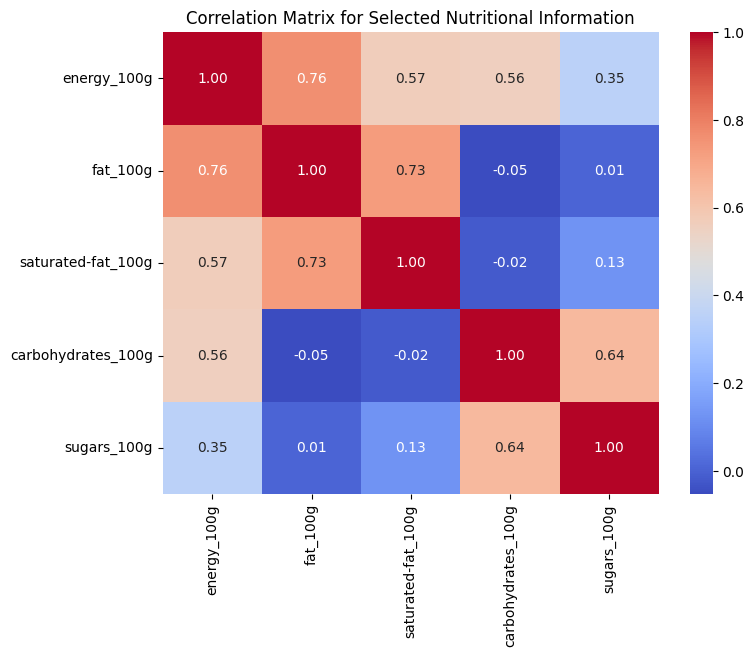

In [ ]:
selected_columns = ['energy_100g', 'fat_100g', 'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g']

df_subset = df_analysis[selected_columns]
correlation_matrix = df_subset.corr()

plt.figure(figsize=(8, 6))
heatmap = sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Correlation Matrix for Selected Nutritional Information')
plt.show()

**Observation:**
En observant la matrice de corrélation pour les informations nutritionnelles sélectionnées, il est apparent que certaines variables sont fortement corrélées, comme fat_100g avec energy_100g et saturated-fat_100g ainsi que carbohydrates_100g et sugars_100g ce qui était prévisible étant donné leur relation directe dans les données nutritionnelles.

Ces informations sont précieuses pour notre prochaine étape, l'utilisation de l'IterativeImputer.  

Avec l'IterativeImputer, nous pouvons tirer parti de ces corrélations pour imputer les valeurs manquantes de manière plus informée.

In [ ]:
colonnes_a_imputer = ['energy_100g', 'fat_100g', 'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g']

limits = {
    'energy_100g': (0, 3900),
    'fat_100g': (0, 100),
    'saturated-fat_100g': (0, 100),
    'carbohydrates_100g': (0, 100),
    'sugars_100g': (0, 100)}

df_imputation = df_analysis[colonnes_a_imputer].copy()

iterative_imputer = IterativeImputer(max_iter=50, random_state=0)
df_imputation_imputed = pd.DataFrame(iterative_imputer.fit_transform(df_imputation), columns=colonnes_a_imputer)

for column, (min_value, max_value) in limits.items():
    df_imputation_imputed[column] = df_imputation_imputed[column].clip(lower=min_value, upper=max_value)

df_analysis.update(df_imputation_imputed)
df_analysis.head()

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
0,0000000004530,banana chips sweetened (whole),NaN,d,2243.0,3.6,28.57,28.57,0.018000,64.29,3.57,0.00000,14.29,0.00129,14.0
1,0000000016087,organic salted nut mix,NaN,d,2540.0,7.1,57.14,5.36,0.017307,17.86,17.86,1.22428,3.57,0.00514,12.0
2,0000000016872,zen party mix,NaN,d,2230.0,6.7,36.67,5.00,0.017307,36.67,16.67,1.60782,3.33,0.00360,12.0
3,0000000018012,cinnamon nut granola,NaN,b,1824.0,9.1,18.18,1.82,0.017307,60.00,14.55,0.02286,21.82,0.00131,0.0
4,0000000018050,organic hazelnuts,NaN,b,2632.0,10.7,60.71,3.57,0.017307,17.86,14.29,0.01016,3.57,0.00450,0.0


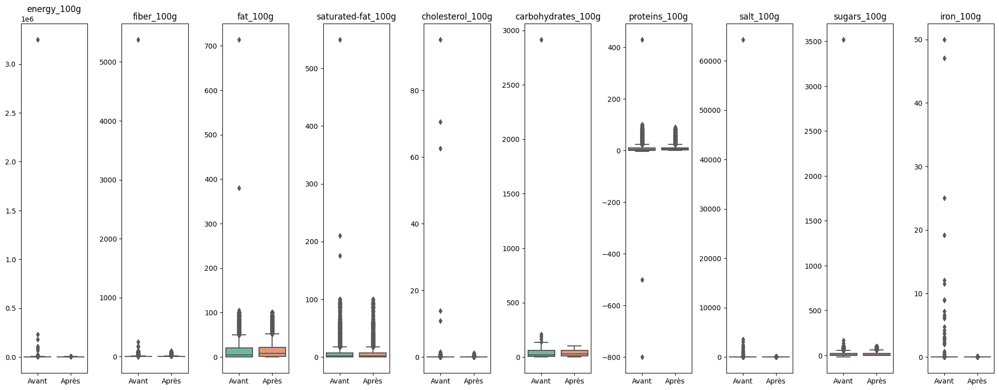

In [ ]:
colonnes_a_comparer = ['energy_100g','fiber_100g', 'fat_100g', 'saturated-fat_100g','cholesterol_100g','carbohydrates_100g','proteins_100g','salt_100g', 'sugars_100g','iron_100g']


plt.figure(figsize=(20, 15))

# Création des boxplots pour chaque colonne avant et après traitement
for i, column in enumerate(colonnes_a_comparer, 1):
    plt.subplot(2, len(colonnes_a_comparer), i)
    sns.boxplot(data=[df_openfoodfacts[column], df_analysis[column]], palette="Set2")
    plt.xticks([0, 1], ['Avant', 'Après'])
    plt.title(column)

# Affichage du graphique
plt.tight_layout()
plt.show()

In [ ]:
df_analysis.describe()

,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
count,155863.000000,155863.000000,155863.000000,155863.00000,155863.000000,155863.000000,155863.000000,155863.000000,155863.000000,155863.000000,155863.000000
mean,1188.595925,2.453949,13.301169,5.03920,0.017299,34.116525,7.732724,1.258848,15.495234,0.001879,9.333716
std,746.294126,4.243133,15.421744,7.53626,0.027324,27.994311,7.926141,4.120334,19.960530,0.002692,9.030122
min,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-14.000000
25%,494.000000,0.000000,1.100000,0.00000,0.000000,8.240000,2.100000,0.100000,1.400000,0.000770,1.000000
50%,1197.000000,0.900000,7.910000,1.80000,0.017307,26.420000,5.830000,0.635000,5.560000,0.001877,10.000000
75%,1732.000000,3.300000,21.430000,7.14000,0.017307,59.260000,10.710000,1.358900,24.620000,0.001877,16.000000
max,3900.000000,99.000000,100.000000,100.00000,1.291000,100.000000,90.000000,100.000000,100.000000,0.180000,40.000000


<Axes: >

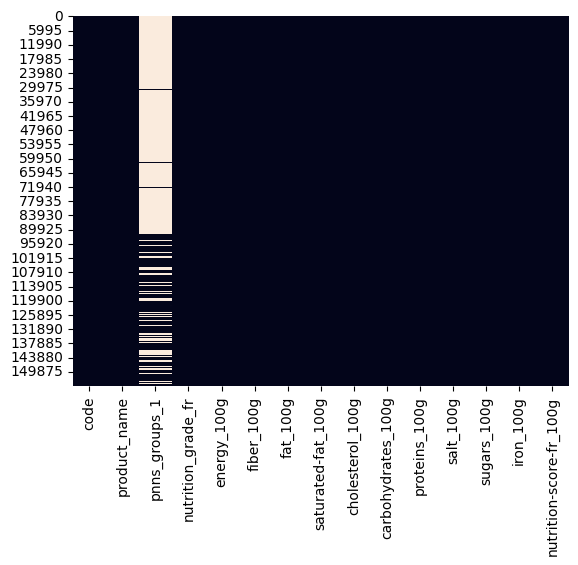

In [ ]:
sns.heatmap(df_analysis.isna(),cbar=False)

**Conclusion:**
- Les boxplots permettent de mettre en avant une réduction significative des valeurs aberrantes après traitement dans les variables quantitatives.

- Les médianes et les quartiles n'ont pas subi de changement majeurs indiquant que les différents traitements ont ciblé les valeurs extrèmes sans altérer la distribution centrales des données.

## Variables qualitatives

### Nutri-Grade ###

Le Nutri-grade est un système d’étiquetage nutritionnel qui permet aux consommateurs de mieux comprendre la qualité nutritionnelle des produits alimentaires. Il est composé d’un classement de A (vert) à E (rouge), qui indique la qualité nutritionnelle du produit, basé sur le Nutri-Score.  

Nous mettons en place une fonction qui permet de remplir la feature Nutri-grade en respectant les nutriscores associés.


In [ ]:
# Aperçu des valeurs et nombre d'occurance dans la feature
grade_counts = df_analysis['nutrition_grade_fr'].value_counts().sort_index()
grade_counts

a    24029
b    23841
c    32676
d    44486
e    30831
Name: nutrition_grade_fr, dtype: int64

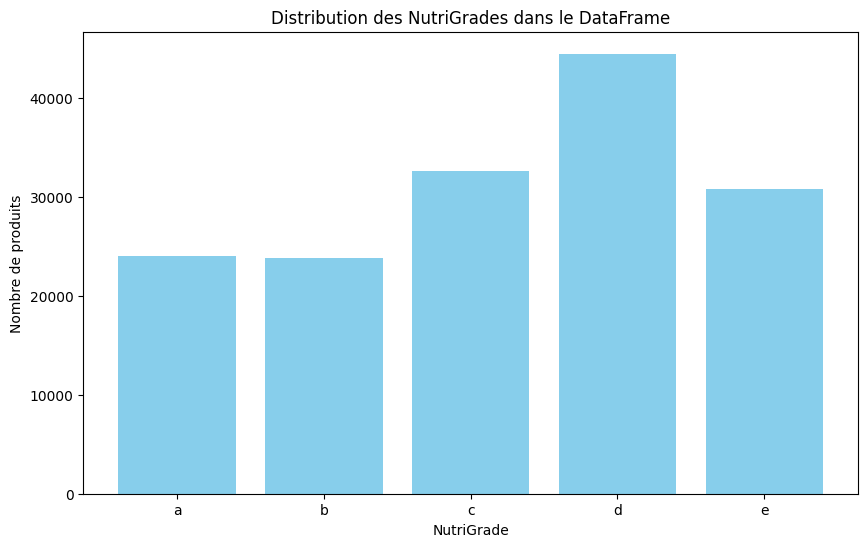

In [ ]:
# Visualisation de la répartition
plt.figure(figsize=(10, 6))
plt.bar(grade_counts.index, grade_counts.values, color='skyblue')
plt.xlabel('NutriGrade')
plt.ylabel('Nombre de produits')
plt.title('Distribution des NutriGrades dans le DataFrame')
plt.show()

In [ ]:
# Fonction pour convertir les scores en grades Nutri-Score correspondant
def score_to_grade(score):
    if score <= -1:
        return 'A'
    elif score <= 2:
        return 'B'
    elif score <= 10:
        return 'C'
    elif score <= 18:
        return 'D'
    elif score >= 19:
        return 'E'
    else:
        return 'Unknown'

df_analysis['nutrition_grade_fr'] = df_analysis['nutrition-score-fr_100g'].apply(score_to_grade)
df_analysis

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
0,0000000004530,banana chips sweetened (whole),NaN,D,2243.0,3.6,28.570000,28.57,0.018000,64.290000,3.57,0.00000,14.29,0.001290,14.0
1,0000000016087,organic salted nut mix,NaN,D,2540.0,7.1,57.140000,5.36,0.017307,17.860000,17.86,1.22428,3.57,0.005140,12.0
2,0000000016872,zen party mix,NaN,D,2230.0,6.7,36.670000,5.00,0.017307,36.670000,16.67,1.60782,3.33,0.003600,12.0
3,0000000018012,cinnamon nut granola,NaN,B,1824.0,9.1,18.180000,1.82,0.017307,60.000000,14.55,0.02286,21.82,0.001310,0.0
4,0000000018050,organic hazelnuts,NaN,B,2632.0,10.7,60.710000,3.57,0.017307,17.860000,14.29,0.01016,3.57,0.004500,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155858,9787461062105,natural cassava,NaN,A,1477.0,4.7,0.000000,0.00,0.000000,87.060000,1.18,0.03048,2.35,0.001270,-1.0
155859,9847548283004,tartines craquantes bio au sarrasin,Cereals and potatoes,A,1643.0,5.9,2.800000,0.60,0.017307,74.800000,13.00,0.68000,2.60,0.003800,-4.0
155860,9900000000233,amandes,NaN,B,2406.0,12.2,30.655493,3.73,0.017307,58.818311,21.22,0.10000,3.89,0.001877,0.0
155861,99111250,thé vert earl grey,Beverages,B,21.0,0.2,0.200000,0.20,0.017307,0.500000,0.50,0.02540,0.50,0.001877,2.0


In [ ]:
# Aperçu des valeurs et nombre d'occurance dans la feature après traitement
grade_counts = df_analysis['nutrition_grade_fr'].value_counts().sort_index()
grade_counts

A    24072
B    24163
C    33120
D    44874
E    29634
Name: nutrition_grade_fr, dtype: int64

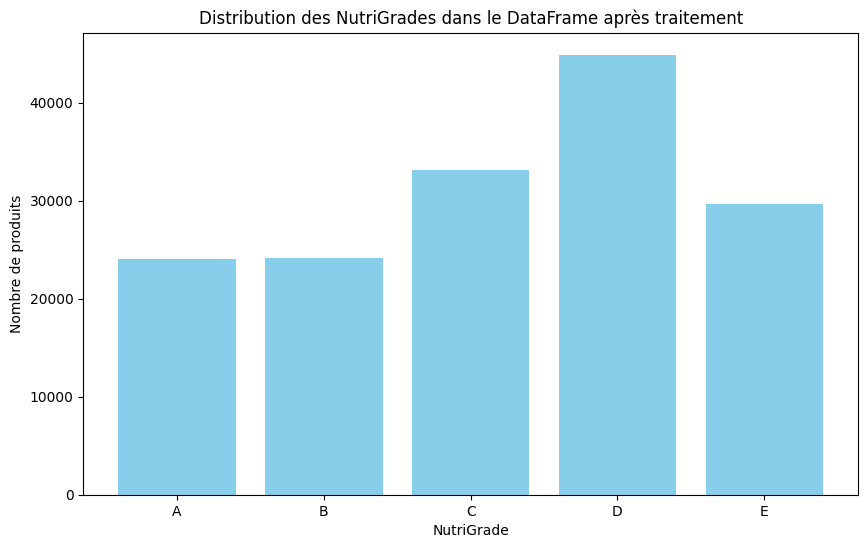

In [ ]:
# Visualisation de la répartition après traitement
plt.figure(figsize=(10, 6))
plt.bar(grade_counts.index, grade_counts.values, color='skyblue')
plt.xlabel('NutriGrade')
plt.ylabel('Nombre de produits')
plt.title('Distribution des NutriGrades dans le DataFrame après traitement')
plt.show()

**Conclusion:**
- Pas de présence de catégorie mal typographiée.
- L'analyse avant et après traitement révèle des Nutri-grades incorrects avant l'application de la fonction.

### PNNS 1 ###

Le Programme National Nutrition Santé (PNNS) 1, lancé en 2001 en France, est une initiative gouvernementale visant à promouvoir une alimentation saine et un mode de vie équilibré pour prévenir les problèmes de santé liés à la nutrition.

In [ ]:
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count       46666
unique         14
top       unknown
freq         8783
Name: pnns_groups_1, dtype: object

In [ ]:
# Aperçu des différentes catégories présentes dans la feature
group_counts =df_analysis['pnns_groups_1'].value_counts()
group_counts

unknown                    8783
Sugary snacks              7594
Milk and dairy products    5370
Cereals and potatoes       5018
Composite foods            4591
Beverages                  4006
Fish Meat Eggs             3984
Fat and sauces             2405
Fruits and vegetables      2370
Salty snacks               1726
fruits-and-vegetables       501
sugary-snacks               306
cereals-and-potatoes         11
salty-snacks                  1
Name: pnns_groups_1, dtype: int64

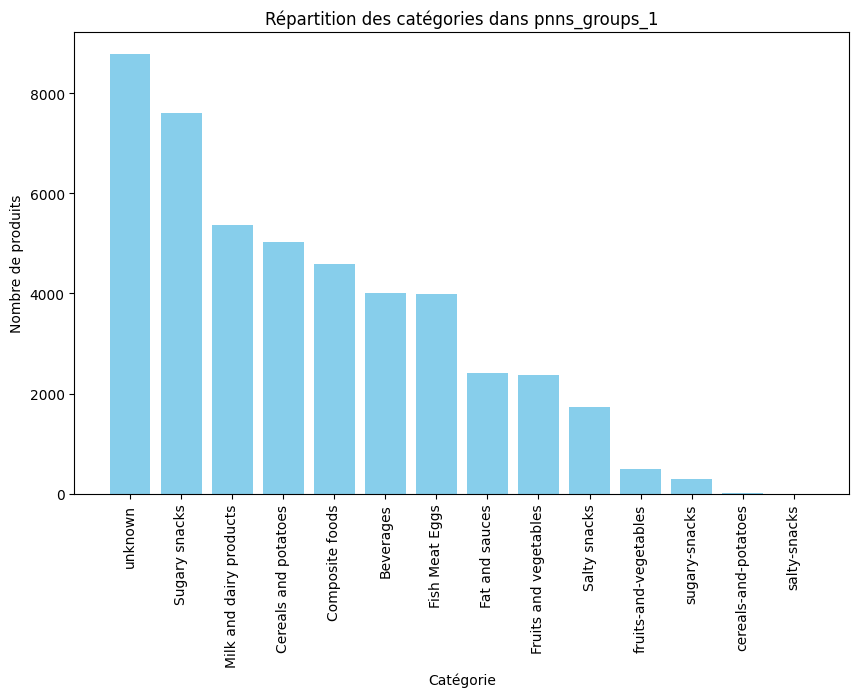

In [ ]:
# Visualisation graphique de la répartition des catégories
plt.figure(figsize=(10, 6))
plt.bar(group_counts.index, group_counts.values, color='skyblue')
plt.xlabel('Catégorie')
plt.ylabel('Nombre de produits')
plt.title('Répartition des catégories dans pnns_groups_1')
plt.xticks(rotation=90)
plt.show()

In [ ]:
# Modification des noms de catégories doublons (erreurs typographiques)
categories= {
    'fruits-and-vegetables':'Fruits and vegetables',
    'sugary-snacks':'Sugary snacks',
    'cereals-and-potatoes':'Cereals and potatoes',
    'salty-snacks':'Salty snacks'
}

df_analysis['pnns_groups_1'] = df_analysis['pnns_groups_1'].replace(categories)

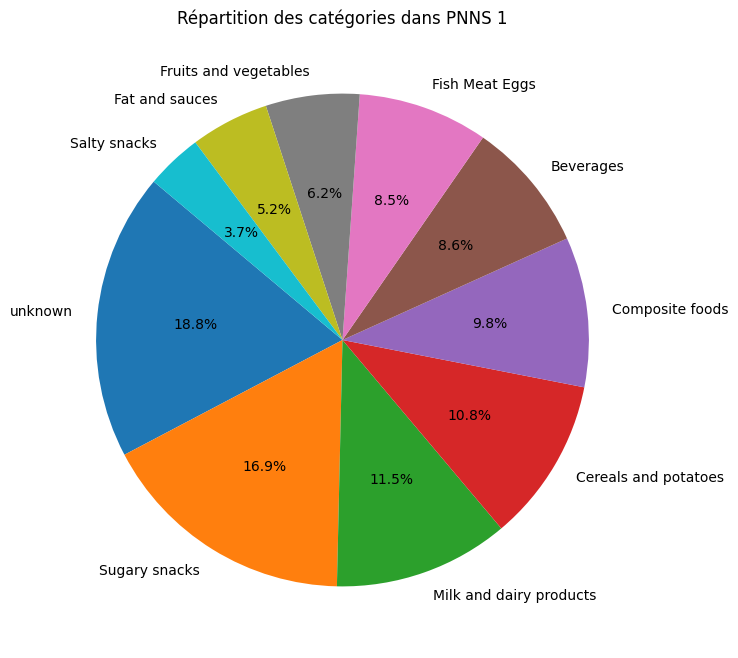

In [ ]:
# Visualisation après traitement des doublons
group_counts = df_analysis['pnns_groups_1'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(group_counts.values, labels=group_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Répartition des catégories dans PNNS 1')
plt.show()

In [ ]:
# Fonction pour remplacer les 'unknown' en NaN
def pnns_1_unknown_par_nan():
    global df_analysis

    condition1 = df_analysis['pnns_groups_1'] == 'unknown'

    df_analysis.loc[condition1, 'pnns_groups_1'] = np.nan

    return df_analysis

df_analysis = pnns_1_unknown_par_nan()

La feature PNNS 1 comporte énormément de valeurs manquantes (NaN) qui empêchent une analyse complète et fiable des données.  

Dans cette partie, nous proposons une méthode pour traiter une partie des données NaN de la colonne pnns_groups_1, en utilisant les mots clés présents dans la colonne product_name. Cette méthode consiste à attribuer une catégorie de pnns_groups_1 à chaque produit en fonction des mots clés qu’il contient, en se basant sur une liste de correspondances entre les mots clés et les catégories.

*Remarque: Le traitement s'effectuera dans un ordre précis afin d'éviter au maximum des classements non représentatif.*

In [ ]:
# Recherche par mots clé dans la catégorie "Beverages" et aperçu du nombre
keywords_beverage = ['juice', 'jus', 'tea', 'thé', 'water', 'eau', 'soda', 'coffee', 'café', 'drink', 'sirop', 'syrup', 'cidre', 'cider', 'sparkling', 'pétillant', 'lemonade', 'limonade', 'vin', 'wine', 'whisky', 'vodka', 'rhum', 'bière', 'beer']
df_beverage = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_beverage in x for keywords_beverage in keywords_beverage))]
df_beverage.count()


code                       12037
product_name               12037
pnns_groups_1               3309
nutrition_grade_fr         12037
energy_100g                12037
fiber_100g                 12037
fat_100g                   12037
saturated-fat_100g         12037
cholesterol_100g           12037
carbohydrates_100g         12037
proteins_100g              12037
salt_100g                  12037
sugars_100g                12037
iron_100g                  12037
nutrition-score-fr_100g    12037
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_beverage), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]


8728

In [ ]:
# Fonction de traitement avec conditions
def pnns1_beverage():
    global df_analysis

    keywords_beverage = ['juice', 'jus', 'tea', 'thé', 'water', 'eau', 'soda', 'coffee', 'café', 'drink', 'sirop', 'syrup', 'cidre', 'cider', 'sparkling', 'pétillant', 'lemonade', 'limonade', 'vin', 'wine', 'whisky', 'vodka', 'rhum', 'bière', 'beer']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()
    condition3 = df_analysis['proteins_100g'] < 1

    for keyword in keywords_beverage:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2 & condition3]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Beverages'

    return df_analysis

df_analysis = pnns1_beverage()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie "Beverages"
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count         43105
unique            9
top       Beverages
freq           9228
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clé dans la catégorie "Fat and sauces" et aperçu du nombre
keywords_fat = ['huile', 'oil', 'sauce','sauces', 'vinaigrette', 'mayonnaise', 'matière grasse', 'fat', 'ketchup', 'moutarde', 'mustard', 'vinaigre', 'vinegar','margarine']
df_fat = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_fat in x for keywords_fat in keywords_fat))]
df_fat.count()

code                       11536
product_name               11536
pnns_groups_1               2880
nutrition_grade_fr         11536
energy_100g                11536
fiber_100g                 11536
fat_100g                   11536
saturated-fat_100g         11536
cholesterol_100g           11536
carbohydrates_100g         11536
proteins_100g              11536
salt_100g                  11536
sugars_100g                11536
iron_100g                  11536
nutrition-score-fr_100g    11536
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_fat), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

8656

In [ ]:
# Fonction de traitement avec conditions
def pnns1_fat():
    global df_analysis

    keywords_fat = ['huile', 'oil', 'sauce','sauces', 'vinaigrette', 'mayonnaise', 'matière grasse', 'fat', 'ketchup', 'moutarde', 'mustard', 'vinaigre', 'vinegar','margarine']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()

    for keyword in keywords_fat:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Fat and sauces'

    return df_analysis

df_analysis = pnns1_fat()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie "Fat and sauces"
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count              51761
unique                 9
top       Fat and sauces
freq               11061
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clé dans la catégorie "Composite foods" et aperçu du nombre
keywords_food = ['sandwitch', 'pizza', 'burger', 'quiche', 'tourte', 'pie', 'tarte', 'moussaka', 'lasagne', 'lasagna', 'paella', 'risotto', 'poêlé', 'hachis parmentier', 'ravioli', 'stir-fry', 'tart', 'soup', 'soupe', 'couscous', 'kebab', 'sushi', 'wrap', 'tacos', 'ratatouille','crepe','pudding']
df_food = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_food in x for keywords_food in keywords_food))]
df_food.count()

code                       9144
product_name               9144
pnns_groups_1              2397
nutrition_grade_fr         9144
energy_100g                9144
fiber_100g                 9144
fat_100g                   9144
saturated-fat_100g         9144
cholesterol_100g           9144
carbohydrates_100g         9144
proteins_100g              9144
salt_100g                  9144
sugars_100g                9144
iron_100g                  9144
nutrition-score-fr_100g    9144
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_food), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

6747

In [ ]:
# Fonction de traitement avec conditions
def pnns1_food():
    global df_analysis

    keywords_food = ['sandwitch', 'pizza', 'burger', 'quiche', 'tourte', 'pie', 'tarte', 'moussaka', 'lasagne', 'lasagna', 'paella', 'risotto', 'poêlé', 'hachis parmentier', 'ravioli', 'stir-fry', 'tart', 'soup', 'soupe', 'couscous', 'kebab', 'sushi', 'wrap', 'tacos', 'ratatouille','crepe','pudding']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()

    for keyword in keywords_food:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Composite foods'

    return df_analysis

df_analysis = pnns1_food()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie "Composite Foods"
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count               58508
unique                  9
top       Composite foods
freq                11338
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clé dans la catégorie "Salty snacks" et aperçu du nombre
keywords_salty_snacks = ['chips', 'salé', 'bretzel', 'pretzel', 'cracker', 'nachos', 'croutons', 'tortillas', 'salted','party','mix']
df_salty_snacks = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_salty_snacks in x for keywords_salty_snacks in keywords_salty_snacks))]
df_salty_snacks.count()

code                       12251
product_name               12251
pnns_groups_1               2096
nutrition_grade_fr         12251
energy_100g                12251
fiber_100g                 12251
fat_100g                   12251
saturated-fat_100g         12251
cholesterol_100g           12251
carbohydrates_100g         12251
proteins_100g              12251
salt_100g                  12251
sugars_100g                12251
iron_100g                  12251
nutrition-score-fr_100g    12251
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_salty_snacks), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

10155

In [ ]:
# Fonction de traitement avec conditions
def pnns1_salty_snacks():
    global df_analysis

    keywords_salty_snacks = ['chips', 'salé', 'bretzel', 'pretzel', 'cracker', 'nachos', 'croutons', 'tortillas', 'salted','party','mix']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()

    for keyword in keywords_salty_snacks:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Salty snacks'

    return df_analysis

df_analysis = pnns1_salty_snacks()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie " Salty Snacks"
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count            68663
unique               9
top       Salty snacks
freq             11882
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clé dans la catégorie "Sugary snacks" et aperçu du nombre
keywords_sugary_snacks =  ['bonbon', 'candy', 'chocolat', 'chocolate', 'sucré', 'cookie', 'patisserie', 'pastry', 'sugar', 'confiture', 'jam', 'marshmallow', 'peanut butter', 'cake', 'muffins', 'chausson', 'beignets', 'donuts', 'bar', 'barre', 'gelée', 'jelly', 'miel', 'honey', 'pâtes à tartiner', 'spreads', 'gauffre', 'waffle']
df_sugary_snacks = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_sugary_snacks in x for keywords_sugary_snacks in keywords_sugary_snacks))]
df_sugary_snacks.count()

code                       28773
product_name               28773
pnns_groups_1               8646
nutrition_grade_fr         28773
energy_100g                28773
fiber_100g                 28773
fat_100g                   28773
saturated-fat_100g         28773
cholesterol_100g           28773
carbohydrates_100g         28773
proteins_100g              28773
salt_100g                  28773
sugars_100g                28773
iron_100g                  28773
nutrition-score-fr_100g    28773
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_sugary_snacks), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

20127

In [ ]:
# Fonction de traitement avec conditions
def pnns1_sugary_snacks():
    global df_analysis

    keywords_sugary_snacks = ['bonbon', 'candy', 'chocolat', 'chocolate', 'sucré', 'cookie', 'patisserie', 'pastry', 'sugar', 'confiture', 'jam', 'marshmallow', 'peanut butter', 'cake', 'muffins', 'chausson', 'beignets', 'donuts', 'bar', 'barre', 'gelée', 'jelly', 'miel', 'honey', 'pâtes à tartiner', 'spreads', 'gauffre', 'waffle']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()

    for keyword in keywords_sugary_snacks:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Sugary snacks'

    return df_analysis

df_analysis = pnns1_sugary_snacks()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie " Sugary Snacks"
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count             88790
unique                9
top       Sugary snacks
freq              28027
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clé dans la catégorie "Meat" et aperçu du nombre
keywords_meat = ['poisson', 'fish', 'viande', 'meat', 'oeuf', 'egg', 'poulet', 'chicken', 'boeuf', 'beef', 'porc', 'pork', 'lamb', 'agneau', 'dinde', 'turkey', 'saumon', 'salmon', 'thon', 'tuna', 'crevette', 'shrimp', 'crabe', 'crab', 'steak', 'truite', 'trout', 'jelly fish']
df_meat = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_meat in x for keywords_meat in keywords_meat))]
df_meat.count()

code                       13878
product_name               13878
pnns_groups_1               5951
nutrition_grade_fr         13878
energy_100g                13878
fiber_100g                 13878
fat_100g                   13878
saturated-fat_100g         13878
cholesterol_100g           13878
carbohydrates_100g         13878
proteins_100g              13878
salt_100g                  13878
sugars_100g                13878
iron_100g                  13878
nutrition-score-fr_100g    13878
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_meat), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

7927

In [ ]:
# Fonction de traitement avec conditions
def pnns1_meat():
    global df_analysis

    keywords_meat = ['poisson', 'fish', 'viande', 'meat', 'oeuf', 'egg', 'poulet', 'chicken', 'boeuf', 'beef', 'porc', 'pork', 'lamb', 'agneau', 'dinde', 'turkey', 'saumon', 'salmon', 'thon', 'tuna', 'crevette', 'shrimp', 'crabe', 'crab', 'steak', 'truite', 'trout', 'jelly fish']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()

    for keyword in keywords_meat:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Fish Meat Eggs'

    return df_analysis

df_analysis = pnns1_meat()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie " Meat "
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count             96717
unique                9
top       Sugary snacks
freq              28027
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clé dans la catégorie "Cereals and potatoes" et aperçu du nombre
keywords_cereals = ['céréales', 'cereals', 'pain', 'bread', 'pomme de terre', 'potato', 'riz', 'rice', 'pâtes', 'pasta', 'blé', 'wheat', 'granola']
df_cereals = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_cereals in x for keywords_cereals in keywords_cereals))]
df_cereals.count()

code                       15012
product_name               15012
pnns_groups_1               7935
nutrition_grade_fr         15012
energy_100g                15012
fiber_100g                 15012
fat_100g                   15012
saturated-fat_100g         15012
cholesterol_100g           15012
carbohydrates_100g         15012
proteins_100g              15012
salt_100g                  15012
sugars_100g                15012
iron_100g                  15012
nutrition-score-fr_100g    15012
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_cereals), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

7077

In [ ]:
# Fonction de traitement avec conditions
def pnns1_cereals():
    global df_analysis

    keywords_cereals = ['céréales', 'cereals', 'pain', 'bread', 'pomme de terre', 'potato', 'riz', 'rice', 'pâtes', 'pasta', 'blé', 'wheat', 'granola']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()

    for keyword in keywords_cereals:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Cereals and potatoes'

    return df_analysis

df_analysis = pnns1_cereals()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie " Cereals and potatoes "
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count            103794
unique                9
top       Sugary snacks
freq              28027
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clé dans la catégorie "Milk and dairy products" et aperçu du nombre
keywords_milk = ['Lait', 'Milk', 'Fromage', 'Cheese', 'Yaourt', 'Yogurt','Beurre','Butter','Crème','Cream ','Dairy','Ice cream','Glacé']
df_milk = df_analysis[df_analysis['product_name'].apply(lambda x: any(keywords_milk in x for keywords_milk in keywords_milk))]
df_milk.count()

code                       0
product_name               0
pnns_groups_1              0
nutrition_grade_fr         0
energy_100g                0
fiber_100g                 0
fat_100g                   0
saturated-fat_100g         0
cholesterol_100g           0
carbohydrates_100g         0
proteins_100g              0
salt_100g                  0
sugars_100g                0
iron_100g                  0
nutrition-score-fr_100g    0
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_milk), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

9695

In [ ]:
# Fonction de traitement avec conditions
def pnns1_milk():
    global df_analysis

    keywords_milk = ['Lait', 'Milk', 'Fromage', 'Cheese', 'Yaourt', 'Yogurt','Beurre','Butter','Crème','Cream ','Dairy','Ice cream','Glacé']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()

    for keyword in keywords_milk:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Milk and dairy products'

    return df_analysis

df_analysis = pnns1_milk()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie " Milk and dairy products "
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count            113489
unique                9
top       Sugary snacks
freq              28027
Name: pnns_groups_1, dtype: object

In [ ]:
# Recherche par mots clés avec fonction dans la catégorie "Fruits and vegetables" en divisant les 2 types d'aliments
keywords_fruits =['fruit', 'apple', 'pomme', 'banane', 'banana', 'strawberry', 'fraise', 'cherry', 'cerise', 'orange', 'raisin', 'grapes', 'grape', 'kiwi', 'poire', 'pear', 'melon', 'mango', 'mangue', 'pineapple', 'ananas', 'peach', 'pêche', 'apricot', 'abricot', 'lemon', 'citron', 'raspberry', 'framboise','amandes', 'almonds','organic', 'noix','walnut','pecan','cashews']
keywords_vegetables = ['vegetable', 'légume', 'carotte', 'carrot', 'tomate', 'tomato', 'poivron', 'bell pepper', 'brocoli', 'broccoli', 'epinard', 'spinach', 'chou', 'cabbage', 'courgette', 'zucchini', 'aubergine', 'eggplant', 'haricot', 'bean', 'pois', 'pea', 'cauliflower', 'chou fleur', 'champignon', 'mushroom','piment','chile', 'avocat', 'avocado', 'salade', 'salad','natural']

def filter_fruits_vegetables(df):
    condition_fruits = df['product_name'].apply(lambda x: any(keyword in x for keyword in keywords_fruits))
    condition_vegetables = df['product_name'].apply(lambda x: any(keyword in x for keyword in keywords_vegetables))

    df_fruits = df[condition_fruits]
    df_vegetables = df[condition_vegetables]

    return df_fruits, df_vegetables

df_fruits, df_vegetables = filter_fruits_vegetables(df_analysis)


In [ ]:
# Aperçu du nombre pour 'Fruits'
df_fruits.count()

code                       27187
product_name               27187
pnns_groups_1              19033
nutrition_grade_fr         27187
energy_100g                27187
fiber_100g                 27187
fat_100g                   27187
saturated-fat_100g         27187
cholesterol_100g           27187
carbohydrates_100g         27187
proteins_100g              27187
salt_100g                  27187
sugars_100g                27187
iron_100g                  27187
nutrition-score-fr_100g    27187
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_fruits), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

8154

In [ ]:
# Aperçu du nombre pour 'Vegetables'
df_vegetables.count()

code                       19090
product_name               19090
pnns_groups_1              12462
nutrition_grade_fr         19090
energy_100g                19090
fiber_100g                 19090
fat_100g                   19090
saturated-fat_100g         19090
cholesterol_100g           19090
carbohydrates_100g         19090
proteins_100g              19090
salt_100g                  19090
sugars_100g                19090
iron_100g                  19090
nutrition-score-fr_100g    19090
dtype: int64

In [ ]:
# Affichage du nombre de données concernées par la recherche mot clé & un NaN en groupe pnns1
df_analysis[(df_analysis['product_name'].str.contains('|'.join(keywords_vegetables), case=False, na=False)) & (df_analysis['pnns_groups_1'].isna())].shape[0]

6628

In [ ]:
# Fonction de traitement avec conditions
def pnns1_fruits_vegetables():
    global df_analysis

    keywords_fruits = ['fruit', 'apple', 'pomme', 'banane', 'banana', 'strawberry', 'fraise', 'cherry', 'cerise', 'orange', 'raisin', 'grapes', 'grape', 'kiwi', 'poire', 'pear', 'melon', 'mango', 'mangue', 'pineapple', 'ananas', 'peach', 'pêche', 'apricot', 'abricot', 'lemon', 'citron', 'raspberry', 'framboise','amandes', 'almonds','organic', 'noix','walnuts','pecan','cashews']
    keywords_vegetables = ['vegetable', 'légume', 'carotte', 'carrot', 'tomate', 'tomato', 'poivron','piment','chile', 'bell pepper', 'brocoli', 'broccoli', 'epinard', 'spinach', 'chou', 'cabbage', 'courgette', 'zucchini', 'aubergine', 'eggplant', 'haricot', 'bean', 'pois', 'pea', 'cauliflower', 'chou fleur', 'champignon', 'mushroom', 'avocat', 'avocado', 'salade', 'salad','natural']
    condition1 = pd.Series(False, index=df_analysis.index)
    condition2 = df_analysis['pnns_groups_1'].isna()
    condition3 = df_analysis['nutrition_grade_fr'].isin(['A', 'B'])

    for keyword in keywords_fruits:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    for keyword in keywords_vegetables:
        condition1 = condition1 | df_analysis['product_name'].str.contains(keyword, case=False, na=False)

    df_selected = df_analysis[condition1 & condition2 & condition3]

    df_analysis.loc[df_selected.index, 'pnns_groups_1'] = 'Fruits and vegetables'

    return df_analysis

df_analysis = pnns1_fruits_vegetables()

In [ ]:
# Affichage des données catégorielles après traitement de la catégorie " Fruits and vegetables "
df_analysis['pnns_groups_1'].describe(exclude=np.number)

count            119834
unique                9
top       Sugary snacks
freq              28027
Name: pnns_groups_1, dtype: object

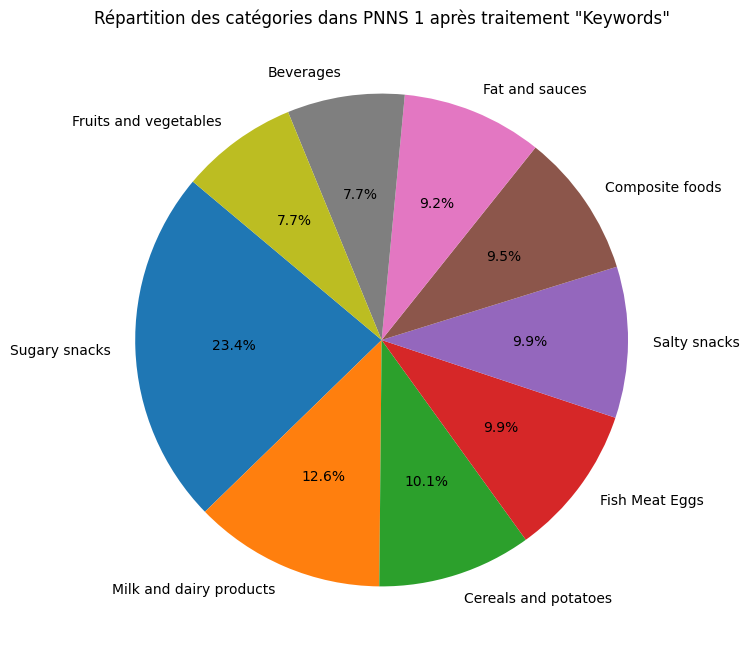

In [ ]:
# Graphique 'Pie' de la répartitions par catégorie après traitement par mots clés
group_counts = df_analysis['pnns_groups_1'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(group_counts.values, labels=group_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Répartition des catégories dans PNNS 1 après traitement "Keywords"')
plt.show()

In [ ]:
# Nombre de valeurs manquantes après traitement
missing_values_count = df_analysis['pnns_groups_1'].isnull().sum()
print("Nombre de valeurs manquantes dans 'pnns_groups_1' :", missing_values_count)

Nombre de valeurs manquantes dans 'pnns_groups_1' : 36029


Le premier traitement a été réalisé en plusieurs étapes pour analyser, filtrer et enrichir notre ensemble de données.
1. Définition des mots clés
2. Recherche et filtrage
3. Enrichissement de la classification PNNS1
4. Observation des résultats

L'objectif de cette approche est de réduire le nombre de valeurs manquantes tout en conservant un maximum de données.  

---

Afin de compléter notre ensemble de données et de gérer les valeurs manquantes restantes de manière efficace, nous allons mettre en oeuvre un RandomForestClassifier Imputer, une technique d'imputation basée sur un classificateur RandomForest.

*NB: Un RandomForest est un algorithme d'apprentissage automatique qui repose sur le principe de l'agrégation de plusieurs arbres de décision. Chaque arbre de décision est un modèle qui apprend à partir des données et prend des décisions en fonction des caractéristiques (variables) des données.*

In [ ]:
#Creation d'un DataFrame avec les données quantitatives + la colonne 'PNNS1' à imputer
analysis = df_analysis[['pnns_groups_1'] + select_columns_quantitatives].copy()

In [ ]:
# Standardisation des données en valeurs numériques
replacement_dict = {'Fruits and vegetables': '1', 'Sugary snacks': '2', 'Beverages': '3', 'Composite foods': '4',
                    'Fish Meat Eggs': '5', 'Milk and dairy products': '6', 'Fat and sauces': '7',
                    'Cereals and potatoes': '8', 'Salty snacks': '9'}

analysis['pnns_groups_1'] = analysis['pnns_groups_1'].replace(replacement_dict)
analysis['pnns_groups_1'] = analysis['pnns_groups_1'].astype(float)

In [ ]:
# Aperçu du nouveau Df
analysis.head()

,pnns_groups_1,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
0,9.0,2243.0,3.6,28.57,28.57,0.018000,64.29,3.57,0.00000,14.29,0.00129,14.0
1,9.0,2540.0,7.1,57.14,5.36,0.017307,17.86,17.86,1.22428,3.57,0.00514,12.0
2,9.0,2230.0,6.7,36.67,5.00,0.017307,36.67,16.67,1.60782,3.33,0.00360,12.0
3,8.0,1824.0,9.1,18.18,1.82,0.017307,60.00,14.55,0.02286,21.82,0.00131,0.0
4,1.0,2632.0,10.7,60.71,3.57,0.017307,17.86,14.29,0.01016,3.57,0.00450,0.0


In [ ]:
# Entraînement du RandomForestClassifier pour l'imputation de données manquantes
SEED= 42
X = analysis.drop('pnns_groups_1', axis=1)
y = analysis['pnns_groups_1']

X_with_y = X[y.notna()]
y_with_y = y[y.notna()]
X_missing_y = X[y.isna()]

model = RandomForestClassifier(random_state=SEED)
model.fit(X_with_y, y_with_y)

predicted_y = model.predict(X_missing_y)

y.loc[y.isna()] = predicted_y

**Remarque:** Avant de choisir le RandomForestClassifier, nous avons effectué un test avec le KNNImputer en utilisant la validation croisée Kfold.
Malheureusement, les résultats de ce test n'étaient pas concluants et ne répondaient pas à nos critères de performance souhaités.
Par conséquent, nous avons opté pour le RandomForestClassifier comme modèle final pour notre tâche de classification.

In [ ]:
# Évaluation des performances du modèle sur l'ensemble de données complet
y_true = y
y_pred = model.predict(X)
print("Accuracy:", accuracy_score(y_true, y_pred))
print("Classification Report:\n", classification_report(y_true, y_pred))
print("Confusion Matrix:\n", confusion_matrix(y_true, y_pred))

Accuracy: 0.9878290550034325
Classification Report:
               precision    recall  f1-score   support

         1.0       0.98      0.98      0.98     12282
         2.0       0.99      0.99      0.99     37732
         3.0       0.97      0.99      0.98     11002
         4.0       0.99      0.99      0.99     13749
         5.0       0.99      0.99      0.99     15512
         6.0       0.99      0.99      0.99     18689
         7.0       0.99      0.99      0.99     15026
         8.0       0.99      0.99      0.99     15806
         9.0       0.99      0.98      0.99     16065

    accuracy                           0.99    155863
   macro avg       0.99      0.99      0.99    155863
weighted avg       0.99      0.99      0.99    155863

Confusion Matrix:
 [[12040     7   127     9    14    15    26    29    15]
 [   26 37466    44    12    16    57    10    31    70]
 [   48    60 10852     1     2    10    15     0    14]
 [   21    39    12 13544    28    25     7    50   

**Remarque :** Les résultats de l'évaluation du modèle RandomForestClassifier sont encourageants. Il affiche une précision globale de 98.78%, indiquant une bonne capacité à prédire avec précision les classes de l'ensemble de données. Les scores de précision, de rappel et de f1-score par classe suggèrent de bonnes performances pour la plupart des classes. La matrice de confusion montre que le modèle a fait relativement peu d'erreurs.

In [ ]:
# Remplacement des valeurs manquantes dans la colonne 'pnns_groups_1' par les valeurs prédites
analysis['pnns_groups_1'].fillna(pd.Series(predicted_y, index=X_missing_y.index), inplace=True)

In [ ]:
# Aperçu des résultats dans analysis
analysis

,pnns_groups_1,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
0,9.0,2243.0,3.6,28.570000,28.57,0.018000,64.290000,3.57,0.00000,14.29,0.001290,14.0
1,9.0,2540.0,7.1,57.140000,5.36,0.017307,17.860000,17.86,1.22428,3.57,0.005140,12.0
2,9.0,2230.0,6.7,36.670000,5.00,0.017307,36.670000,16.67,1.60782,3.33,0.003600,12.0
3,8.0,1824.0,9.1,18.180000,1.82,0.017307,60.000000,14.55,0.02286,21.82,0.001310,0.0
4,1.0,2632.0,10.7,60.710000,3.57,0.017307,17.860000,14.29,0.01016,3.57,0.004500,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
155858,1.0,1477.0,4.7,0.000000,0.00,0.000000,87.060000,1.18,0.03048,2.35,0.001270,-1.0
155859,8.0,1643.0,5.9,2.800000,0.60,0.017307,74.800000,13.00,0.68000,2.60,0.003800,-4.0
155860,1.0,2406.0,12.2,30.655493,3.73,0.017307,58.818311,21.22,0.10000,3.89,0.001877,0.0
155861,3.0,21.0,0.2,0.200000,0.20,0.017307,0.500000,0.50,0.02540,0.50,0.001877,2.0


In [ ]:
# Remise à l'original des données catégorielles dans analysis
replacement_dict = {
    1: 'Fruits and vegetables',
    2: 'Sugary snacks',
    3: 'Beverages',
    4: 'Composite foods',
    5: 'Fish Meat Eggs',
    6: 'Milk and dairy products',
    7: 'Fat and sauces',
    8: 'Cereals and potatoes',
    9: 'Salty snacks'
}

analysis['pnns_groups_1'] = analysis['pnns_groups_1'].replace(replacement_dict)


In [ ]:
# Ajout des données dans le df_analysis
df_analysis['pnns_groups_1'] = analysis['pnns_groups_1']

In [ ]:
 # Aperçu après modification
df_analysis.sample(5)

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
37574,0072730273252,gourmet ultra-pasteurized heavy whipping cream,Cereals and potatoes,D,1255.0,0.0,33.33,23.33,0.133000,0.00000,0.00,0.08382,0.00,0.000000,13.0
98400,3069535461189,préparation pour taboulé à l'huile d'olive 6%,Composite foods,C,163.0,1.3,2.60,0.90,0.017307,2.60000,0.70,1.20500,2.20,0.001877,4.0
77458,0819893021968,"cookie mix, chocolate chip",Salty snacks,D,1540.0,0.0,2.63,0.00,0.000000,78.95000,5.26,1.27000,31.58,0.000000,16.0
121514,3560071000288,sirop de fraise de provence,Beverages,D,1351.0,0.0,0.00,0.00,0.017307,89.84822,0.00,0.00000,79.00,0.001877,14.0
15619,0037600302821,"black label, thick cut canadian bacon",Fish Meat Eggs,D,523.0,0.0,4.46,1.79,0.054000,1.79000,19.64,2.13106,0.00,0.001877,11.0


In [ ]:
# Vérification de la présence de données manquantes
df_analysis.isna().sum()

code                       0
product_name               0
pnns_groups_1              0
nutrition_grade_fr         0
energy_100g                0
fiber_100g                 0
fat_100g                   0
saturated-fat_100g         0
cholesterol_100g           0
carbohydrates_100g         0
proteins_100g              0
salt_100g                  0
sugars_100g                0
iron_100g                  0
nutrition-score-fr_100g    0
dtype: int64

In [ ]:
# Aperçu des données catégorielles après traitement
df_analysis.describe(exclude=np.number)

,code,product_name,pnns_groups_1,nutrition_grade_fr
count,155863,155863,155863,155863
unique,155863,155863,9,5
top,0000000004530,banana chips sweetened (whole),Sugary snacks,D
freq,1,1,37732,44874


In [ ]:
# Aperçu plus large de df_analysis après le RandomForestClassifier
df_analysis.head(20)

,code,product_name,pnns_groups_1,nutrition_grade_fr,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
0,0000000004530,banana chips sweetened (whole),Salty snacks,D,2243.0,3.6,28.57,28.57,0.018000,64.29,3.57,0.00000,14.29,0.00129,14.0
1,0000000016087,organic salted nut mix,Salty snacks,D,2540.0,7.1,57.14,5.36,0.017307,17.86,17.86,1.22428,3.57,0.00514,12.0
2,0000000016872,zen party mix,Salty snacks,D,2230.0,6.7,36.67,5.00,0.017307,36.67,16.67,1.60782,3.33,0.00360,12.0
3,0000000018012,cinnamon nut granola,Cereals and potatoes,B,1824.0,9.1,18.18,1.82,0.017307,60.00,14.55,0.02286,21.82,0.00131,0.0
4,0000000018050,organic hazelnuts,Fruits and vegetables,B,2632.0,10.7,60.71,3.57,0.017307,17.86,14.29,0.01016,3.57,0.00450,0.0
5,0000000018227,organic oat groats,Fruits and vegetables,A,1096.0,9.5,5.95,1.19,0.017307,66.67,16.67,0.02540,2.38,0.00429,-6.0
6,0000000018265,energy power mix,Salty snacks,D,1464.0,5.0,17.50,7.50,0.017307,42.50,7.50,0.28448,32.50,0.00180,14.0
7,0000000018289,antioxidant mix - berries & chocolate,Salty snacks,D,2092.0,6.7,33.33,6.67,0.017307,46.67,13.33,0.46482,30.00,0.00240,15.0
8,0000000018319,organic quinoa coconut granola with mango,Cereals and potatoes,C,1674.0,9.1,10.91,2.73,0.017307,69.09,10.91,0.02286,27.27,0.00262,7.0
9,0000000018340,fire roasted hatch green chile almonds,Salty snacks,D,2372.0,10.0,50.00,3.33,0.017307,23.33,6.67,1.27000,6.67,0.00360,11.0


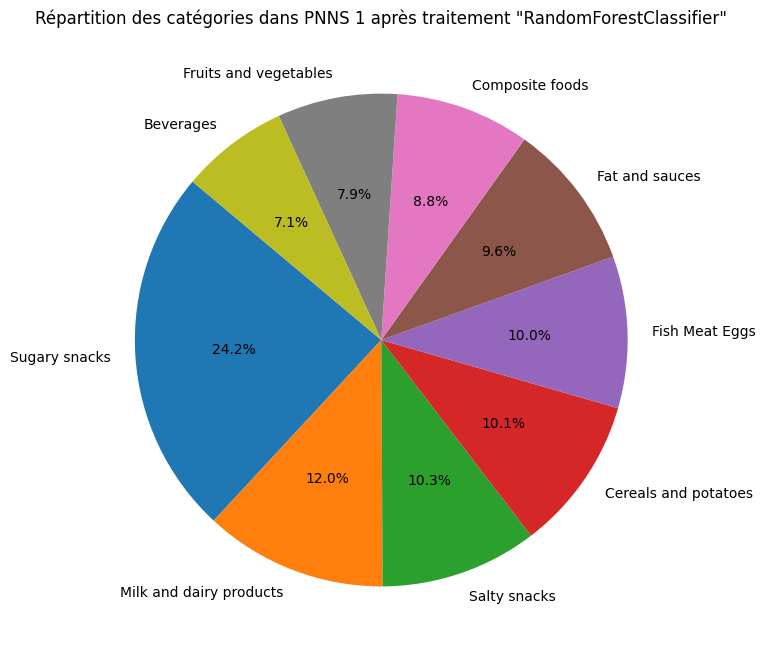

In [ ]:
# Graphique de la représentation des groupes PNNS1 après traitement et RandomForestClassifier
group_counts = df_analysis['pnns_groups_1'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(group_counts.values, labels=group_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Répartition des catégories dans PNNS 1 après traitement "RandomForestClassifier"')
plt.show()

**Conlusion:**
- Le traitement des valeurs manquantes (NaN) a permis de conserver l'intégralité du jeu de données, sans perte d'information due à des suppressions de lignes ou de colonnes.
- La répartition plus équilibrée des catégories après traitement indique que les produits sont maintenant mieux classifiés, ce qui améliore la précision des futures analyses.
- La capacité de maintenir et d'exploiter tout le potentiel des données est un avantage stratégique, permettant d'extraire des informations plus détaillées et pertinentes.

# Analyse Exploratoire #

Suite à un nettoyage approfondi de notre jeu de données, nous avons éliminé les valeurs aberrantes et comblé les valeurs manquantes, assurant ainsi l'intégrité et la complétude de nos informations.

L'analyse exploratoire des données (AED) constitue la prochaine phase de notre exploration, où nous allons plonger dans les détails des distributions, des tendances et des modèles potentiels. Nous chercherons à comprendre les relations entre les différentes variables, à identifier des groupes ou des clusters distincts, et à dégager des hypothèses pour des analyses plus poussées ou la modélisation prédictive.

Cette analyse sera en 3 parties:  
- Analyse univariée
- Analyse bivariée
-Analyse multivariée

## Analyse Univariée ##

L'analyse univariée est notre première fenêtre sur l'univers des données que nous avons méticuleusement préparé. Cette étape va nous offrir une vue d'ensemble de chaque variable indépendamment, nous révélant les tendances centrales, la dispersion et la forme de leur distribution.

### Variables numériques ###

In [ ]:
# Analyse descriptive du dataframe
df_analysis.describe()

,energy_100g,fiber_100g,fat_100g,saturated-fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,sugars_100g,iron_100g,nutrition-score-fr_100g
count,155863.000000,155863.000000,155863.000000,155863.00000,155863.000000,155863.000000,155863.000000,155863.000000,155863.000000,155863.000000,155863.000000
mean,1188.595925,2.453949,13.301169,5.03920,0.017299,34.116525,7.732724,1.258848,15.495234,0.001879,9.333716
std,746.294126,4.243133,15.421744,7.53626,0.027324,27.994311,7.926141,4.120334,19.960530,0.002692,9.030122
min,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-14.000000
25%,494.000000,0.000000,1.100000,0.00000,0.000000,8.240000,2.100000,0.100000,1.400000,0.000770,1.000000
50%,1197.000000,0.900000,7.910000,1.80000,0.017307,26.420000,5.830000,0.635000,5.560000,0.001877,10.000000
75%,1732.000000,3.300000,21.430000,7.14000,0.017307,59.260000,10.710000,1.358900,24.620000,0.001877,16.000000
max,3900.000000,99.000000,100.000000,100.00000,1.291000,100.000000,90.000000,100.000000,100.000000,0.180000,40.000000


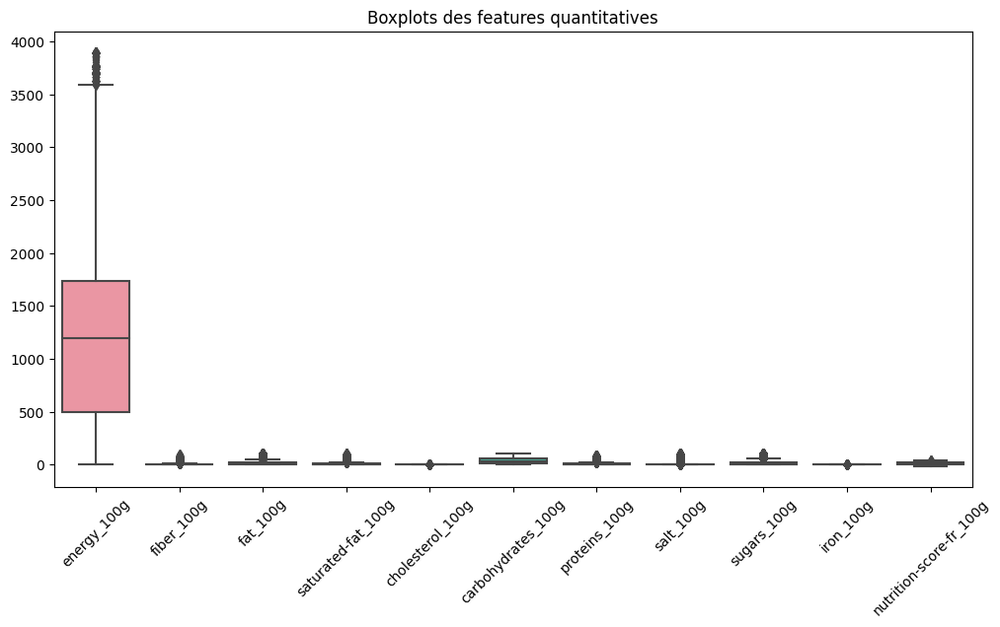

In [ ]:
# Visualisation de la distribution des caractéristiques numériques
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_analysis.select_dtypes(include='float64'))
plt.xticks(rotation=45)
plt.title("Boxplots des features quantitatives")
plt.show()

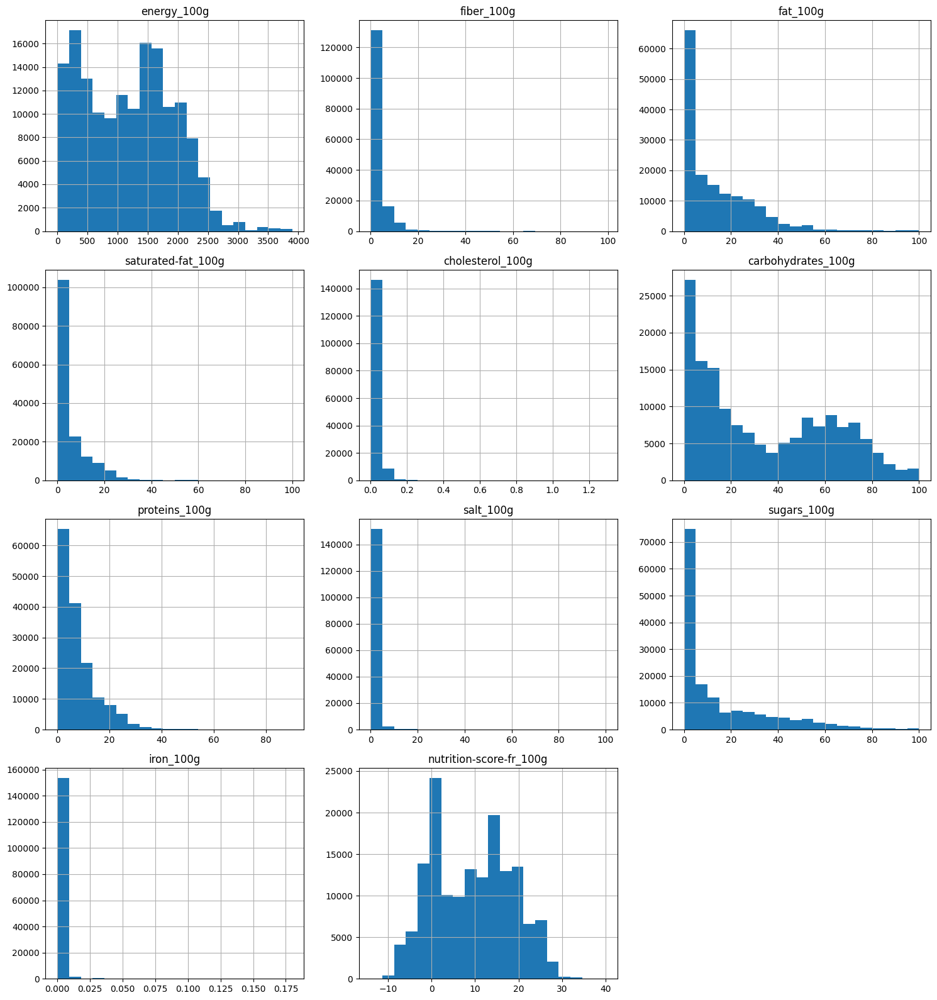

In [ ]:
# Histogrammes d'exploration de la distribution des caractéristiques numériques
num_cols = df_analysis.select_dtypes(include= 'float64').columns
n_rows = len(num_cols) // 3 + 1

plt.figure(figsize=(15, 4 * n_rows))

for i, col in enumerate(num_cols):
    plt.subplot(n_rows, 3, i + 1)
    df_analysis[col].hist(bins=20)
    plt.title(col)

plt.tight_layout()
plt.show()

**Conlusion:**
- ***Analyse des statistiques :***  Les données reflètent une diversité conséquente dans la composition nutritionnelle des produits alimentaires. La variabilité élevée observée dans presques tous les nutriments indique une large gamme de profils nutritionnels. La disparité du score nutritionnel suggère également qu'il existe un équilibre entres les produits plus ou moins bénéfiques pour la santé.

- ***Analyse des boxplots:*** Ils soulignent l'existence d'une variation considérable dans la composition nutritionnelle des produits alimentaires.Les bloxplots indiquent une diversité marquée dans la teneur nutritionnelle des produits. L'énergie varie largement, reflétant une gamme étendue de profils caloriques. Les fibres et le fer sont typiquement bas, avec quelques produits se démarquant par leur richesse. Les autres nutriments, bien que généralement présents en quantités modérées, sont fortement concentrés dans certains produits. Le score nutritionnel est distribué de façon homogène.

- ***Analyse des histogrammes:*** Les graphiques montrent une prédominance de faibles teneurs en nutriments à l'exception des protéines, qui présentent une distribution plus uniforme. La plupart des variables affichent une distribution fortement asymétrique avec des queues étendues vers les valeurs élevées, indiquant une présence de valeurs atypiques. Le score nutritionnel révèle une distribution bimodale, signalant deux populations distinctes de produits en termes de qualité nutritionnelle.

### Variables catégorielles ###

In [ ]:
# Analyse descriptive des données catégorielles du dataframe
df_analysis.describe(exclude=np.number)

,code,product_name,pnns_groups_1,nutrition_grade_fr
count,155863,155863,155863,155863
unique,155863,155863,9,5
top,0000000004530,banana chips sweetened (whole),Sugary snacks,D
freq,1,1,37732,44874


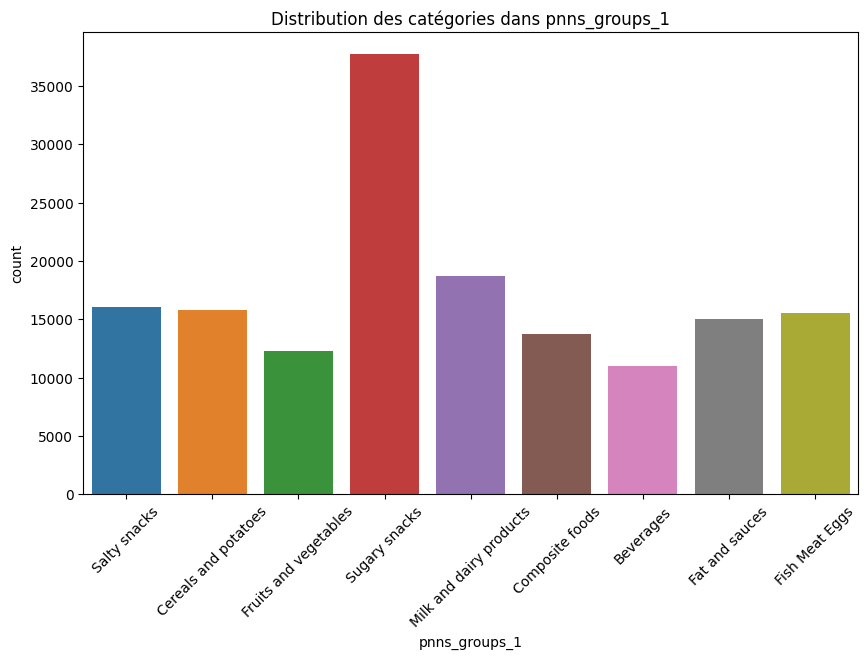

In [ ]:
# Graphique de distribution des catégories dans la colonne 'pnns_groups_1'
cat_column = 'pnns_groups_1'

plt.figure(figsize=(10, 6))
sns.countplot(x=cat_column, data=df_analysis)

plt.title('Distribution des catégories dans ' + cat_column)
plt.xticks(rotation=45)
plt.show()

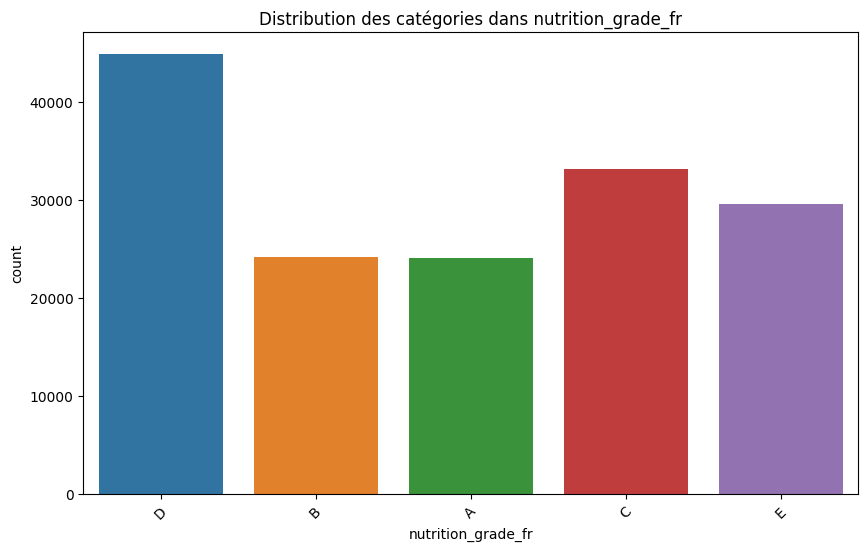

In [ ]:
# Graphique de distribution des catégories dans la colonne 'nutrition_grade_fr'
cat_column = 'nutrition_grade_fr'

plt.figure(figsize=(10, 6))
sns.countplot(x=cat_column, data=df_analysis)

plt.title('Distribution des catégories dans ' + cat_column)
plt.xticks(rotation=45)
plt.show()

**Conclusion:**  
La distribution des ***codes et noms de produits*** garantit que chaque entrée dans le dataframe est distincte, éliminant ainsi la possibilité de doublons.

On retrouve nos 9 catégories dans le PNNS1. La prédominance des ***'Sugary snacks'*** indique une représentation plus fortes pour ce groupe d'aliments dans le jeu de données, celà pourrait être du aux habitudes de consommations ou aux interrogations nutritionnelles sur cette catégorie de produits.   

Les catégories ***'Milk and dairy products'***, ***'salty snacks'***, ***'cereals and potatoes'***, ***'fat and sauces'*** et ***'fish meat eggs'*** constituent le milieu de gamme en termes de fréquence.  

Les ***'Beverages'*** et ***'Fruits and vegetables'*** sont les nombres les plus bas, indiquant qu'ils sont moins représentés dans le jeu de données.  

La variable des notes nutritionnelles regroupant les 5 lettres suit l'orientation des PNNS1 avec une note ***D*** plus courante qui indique une tendance vers une qualité nutritionnelle inférieure suivit par les lettres ***C*** et ***E***.

## Analyse Bivariée ##

L'analyse bivariée marque notre prochaine étape d'exploration. Cette phase nous permettra d'examiner les relations entre deux variables en même temps, révélant ainsi les associations, les corélations et les tendances qui peuvent exister entre elles.

### Features quantitatives ###

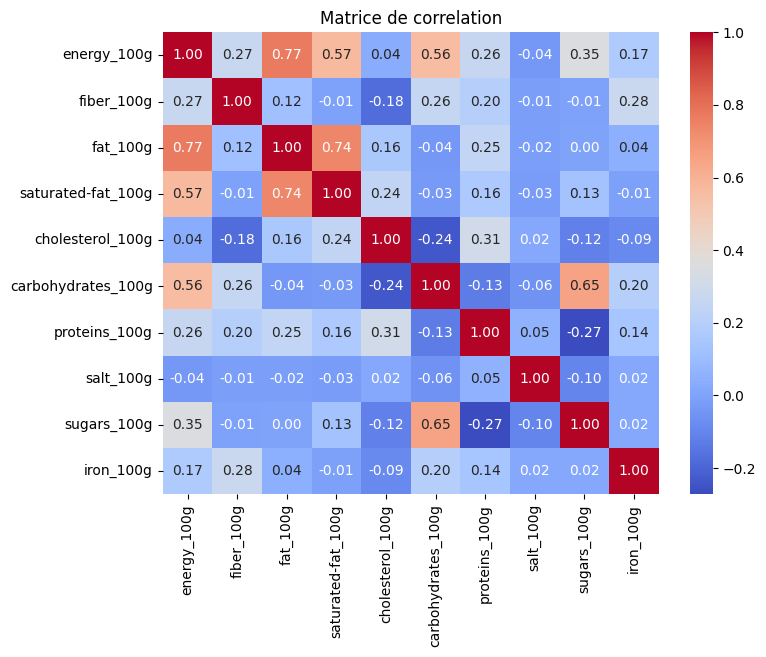

In [ ]:
selected_columns = ['energy_100g','fiber_100g', 'fat_100g', 'saturated-fat_100g',
                    'cholesterol_100g','carbohydrates_100g','proteins_100g',
                    'salt_100g', 'sugars_100g','iron_100g']

df_subset = df_analysis[selected_columns]
correlation_matrix = df_subset.corr()

plt.figure(figsize=(8, 6))
heatmap = sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Matrice de correlation')
plt.show()

In [ ]:
# Analyse de la relation entre les caractéristiques nutritionnelles sélectionnées à l'aide d'une matrice de graphiques de dispersion.
colonnes_a_comparer = ['energy_100g','fiber_100g', 'fat_100g', 'saturated-fat_100g',
                       'cholesterol_100g','carbohydrates_100g','proteins_100g',
                       'salt_100g', 'sugars_100g','iron_100g']

sample_df = df_analysis[colonnes_a_comparer].sample(frac=0.2)
sns.pairplot(sample_df)
plt.show()

Output hidden; open in https://colab.research.google.com to view.

**Conclusion:** L'analyse bivariée, en combinant la visualisation à travers une heatmap de corrélation et des scatter plots, révèle plusieurs tendances et relations entre les variables nutritionnelles :

- ***Énergie, Graisses, Acides Gras Saturés et Sucres :*** L'énergie est positivement corrélée avec les graisses, les acides gras saturés et les sucres. Cette corrélation suggère que les aliments plus énergétiques ont tendance à contenir des quantités plus élevées de ces nutriments.   

  Les graisses et les acides gras saturés présentent une forte corrélation positive. Cela indique que la composition lipidique des aliments a tendance à inclure une proportion significative d'acides gras saturés.
  
  Les sucres et les glucides montrent également une relation positive. Les sucres sont une sous-catégorie des glucides, ce qui explique cette corrélation.  


- ***Protéines :*** Les protéines ont une corrélation moins forte avec l'énergie par rapport aux graisses, indiquant qu'elles contribuent moins aux calories totales. Les aliments riches en protéines ont tendance à être moins caloriques que ceux riches en graisses ou en glucides.

- ***Sel :*** Il n'affiche pas de corrélation claire avec les autres nutriments. Cela suggère que la teneur en sel d'un aliment est relativement indépendante de sa composition en graisses, glucides ou sucres.

- ***Cholestérol, Fiber et Iron***: ces trois nutriments ne présentent pas de relations significatives ou fortes avec les autres variables nutritionnelles étudiées

### Features qualitatives/quantitatives ###

In [ ]:
#Regroupement des colonnes pour l'analyse bivariée qualitatives/quantitatives
colonnes_a_comparer = ['energy_100g','proteins_100g','salt_100g']
grouped_data = df_analysis.groupby('pnns_groups_1')[colonnes_a_comparer].agg(['mean', 'median', 'sum'])

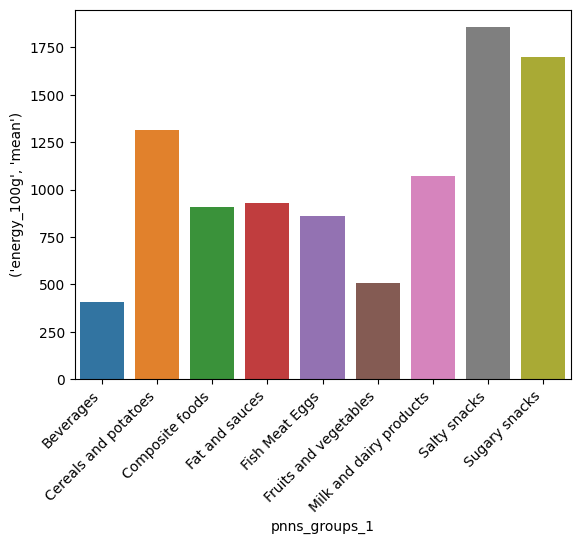

In [ ]:
# Comparaison des moyennes de la teneur énergétique ('energy_100g') par groupe alimentaire
sns.barplot(x=grouped_data.index, y=grouped_data[('energy_100g', 'mean')])
plt.xticks(rotation=45, ha='right')
plt.show()


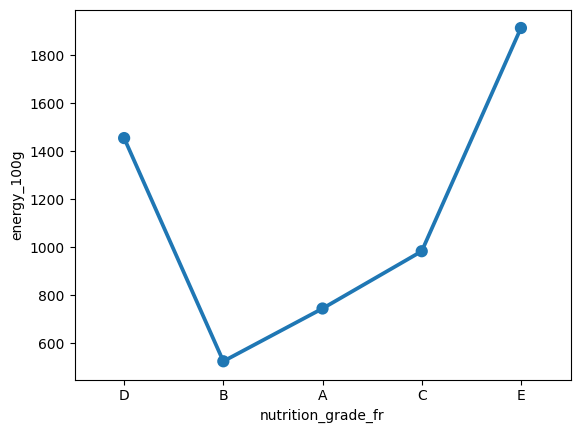

In [ ]:
# Relation entre la Note Nutritionnelle et la Teneur Énergétique par 100g
sns.pointplot(x='nutrition_grade_fr', y='energy_100g', data=df_analysis)
plt.show()

**Conclusion:**  
 Les catégories ***Sugary snacks***, ***Salty snacks***, et ***Fat and sauces*** ont une teneur énergétique moyenne élevée, indiquant des produits plus caloriques.

En revanche, la catégorie ***Beverages*** est associée à une teneur énergétique moyenne plus basse, caractérisée par des boissons moins caloriques.

Les produits notés ***A*** ont la teneur énergétique moyenne la plus basse, reflétant leur caractère plus sain.  
Cependant, les produits notés ***C*** et ***E*** montrent une teneur énergétique moyenne plus élevée, suggérant une qualité nutritionnelle moins favorable.

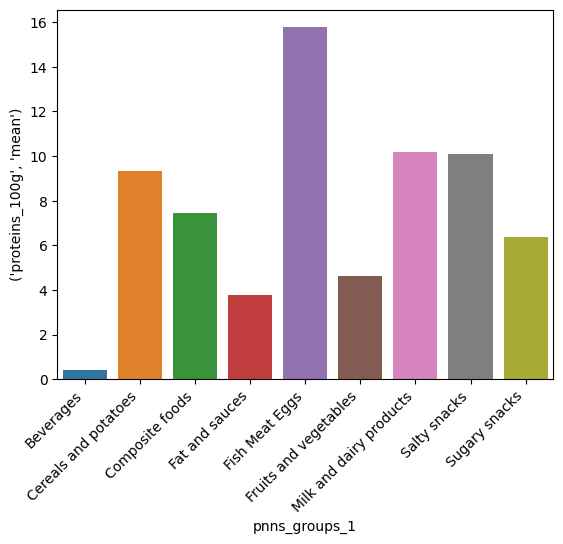

In [ ]:
# Comparaison des moyennes des proteines ('proteins_100g') par groupe alimentaire
sns.barplot(x=grouped_data.index, y=grouped_data[('proteins_100g', 'mean')])
plt.xticks(rotation=45, ha='right')
plt.show()

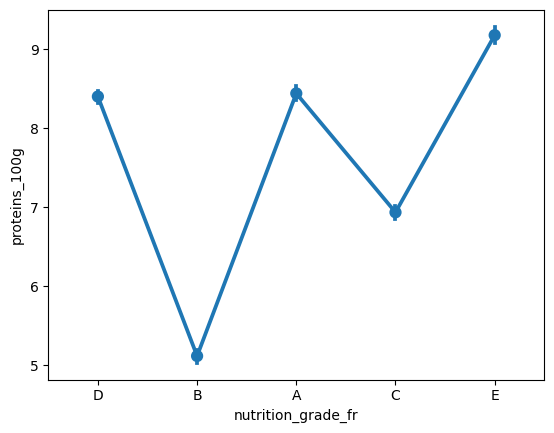

In [ ]:
# Relation entre la Note Nutritionnelle et les proteins par 100g
sns.pointplot(x='nutrition_grade_fr', y='proteins_100g', data=df_analysis)
plt.show()

**Conclusion:**  
Dans les différentes catégories PNNS, ***Fish Meat Eggs*** affiche la plus haute teneur moyenne en protéines, ce qui reflète leur contribution importante à l'apport protéique dans l'alimentation. Les catégories ***Sugary snacks*** et ***Salty snacks*** présentent les teneurs en protéines les plus faibles, conforme à leur profil nutritionnel.

Concernant le Nutrigrade, les produits avec une note ***A*** affichent une teneur en protéines relativement faible, ce qui peut être surprenant. Cependant, il est à noter que les aliments notés ***A*** ne sont pas nécessairement faibles en protéines mais peuvent être équilibrés dans leur apport calorique global.  
En revanche, les produits avec les notes ***D*** et ***E*** montrent des teneurs en protéines plus élevées, suggérant que des produits potentiellement plus riches en protéines peuvent aussi être plus caloriques ou contenir plus de matières grasses et de sucres.

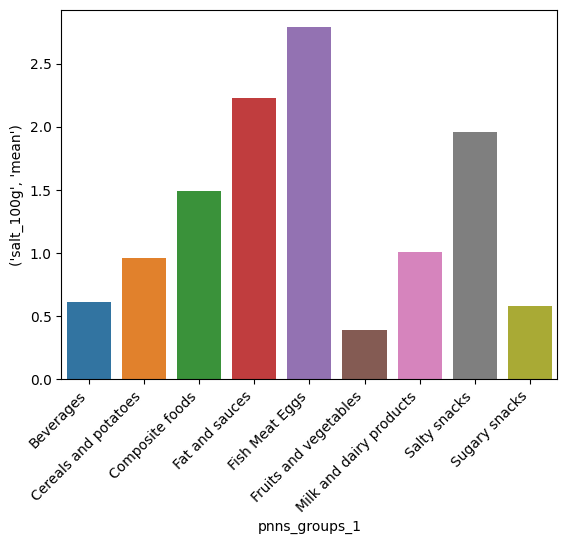

In [ ]:
# Comparaison des moyennes de la teneur en sel par groupe alimentaire
sns.barplot(x=grouped_data.index, y=grouped_data[('salt_100g', 'mean')])
plt.xticks(rotation=45, ha='right')
plt.show()

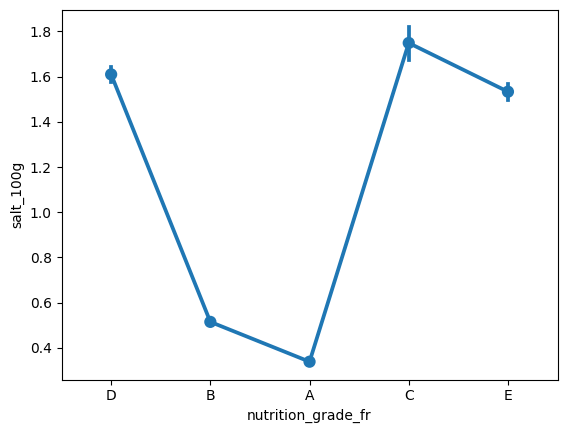

In [ ]:
# Relation entre la Note Nutritionnelle et la Teneur en sel par 100g
sns.pointplot(x='nutrition_grade_fr', y='salt_100g', data=df_analysis)
plt.show()

**Conclusion:**  
Les catégories ***Fish Meat Eggs*** et ***Fat and sauces*** montrent les moyennes de teneur en sel les plus élevées, ce qui pourrait indiquer une utilisation plus importante de sel dans la conservation ou la préparation de ces produits.

Les ***Beverages*** affichent la plus faible teneur en sel en moyenne, ce qui peut refléter une moins grande utilisation de sel dans ces produits.  

Concernant les notes nutritionnelles, les produits avec une note ***A*** ont la teneur en sel la plus basse en moyenne, soulignant leur profil nutritionnel supérieur.  
 Par contre, la note ***C*** présente une remontée significative de la teneur en sel, et les produits notés ***E*** ont la teneur la plus élevée.

## Analyse Multivariée ##

L'analyse multivariée constitue notre dernière approche d'exploration. Cette phase nous permettra d'examiner les relations complexes entre trois variables ou plus en même temps, mettant en lumière les interactions, les corrélations, et les tendances complexes qui peuvent exister entre elles.

### Analyse en composantes principales ###

L'Analyse en Composantes Principales (ACP) est une méthode d'analyse des données puissante. Elle nous permet de simplifier des données complexes en identifiant les tendances, les schémas et les facteurs importants tout en réduisant leur dimension. Dans ce contexte, nous utiliserons l'ACP pour explorer la qualité nutritionnelle des produits alimentaires en relation avec plusieurs variables nutritionnelles.

In [ ]:
#Préparation des Données pour l'Analyse en Composantes Principales
df_pca = df_analysis.copy()
df_pca.drop(columns=['code','product_name','pnns_groups_1','nutrition_grade_fr','sugars_100g','saturated-fat_100g'],inplace=True)

In [ ]:
df_pca.shape

(155863, 9)

In [ ]:
names = df_pca.index
names

RangeIndex(start=0, stop=155863, step=1)

In [ ]:
features = df_pca.columns
features

Index(['energy_100g', 'fiber_100g', 'fat_100g', 'cholesterol_100g',
       'carbohydrates_100g', 'proteins_100g', 'salt_100g', 'iron_100g',
       'nutrition-score-fr_100g'],
      dtype='object')

In [ ]:
#Mise à l'Échelle des Données avec StandardScaler
scaler = StandardScaler()
scaler.fit(df_pca)

StandardScaler()

In [ ]:
#Transformation des Données
df_pca_scaled = scaler.fit_transform(df_pca)

In [ ]:
#Résumé Statistique des Données Mises à l'Échelle
idx = ['mean', 'std']
pd.DataFrame(df_pca_scaled).describe().round(2).loc[idx, :]

,0,1,2,3,4,5,6,7,8
mean,-0.0,-0.0,-0.0,0.0,-0.0,-0.0,-0.0,-0.0,0.0
std,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


In [ ]:
#Application de l'ACP
pca = PCA()
df_pca = pca.fit(df_pca_scaled)

In [ ]:
#"Calcul du Ratio de Variance Expliquée en ACP
explained_variance_ratio = pca.explained_variance_ratio_

In [ ]:
#Calcul du Scree Plot
scree = (pca.explained_variance_ratio_*100).round(2)
scree

array([29.34, 18.77, 14.61, 11.33,  8.83,  7.94,  5.88,  3.13,  0.18])

In [ ]:
#Calcul de la Somme Cumulée du Scree Plot
scree_cum = scree.cumsum().round()
scree_cum

array([ 29.,  48.,  63.,  74.,  83.,  91.,  97., 100., 100.])

In [ ]:
#Calcul des Composantes Principales en Analyse en Composantes Principales
components = pca.components_
components = pd.DataFrame(components)
components

,0,1,2,3,4,5,6,7,8
0,0.591100,0.178709,0.492920,0.090015,0.284197,0.226145,0.010543,0.153391,0.460480
1,-0.081216,-0.430816,0.229054,0.539081,-0.486096,0.229573,0.109802,-0.340202,0.218954
2,-0.095629,0.456732,-0.011912,0.217086,-0.283619,0.613419,0.055464,0.396316,-0.343682
3,-0.061276,-0.034122,-0.111685,-0.097817,0.044554,-0.031410,0.962538,0.148135,0.147118
4,-0.064314,-0.396174,-0.364017,0.467029,0.329552,-0.014739,-0.140731,0.581124,0.148165
5,-0.052387,-0.249210,0.392955,-0.341456,-0.493378,-0.263446,-0.084801,0.584382,0.051231
6,-0.045097,0.483997,0.152071,0.539417,-0.096886,-0.657329,0.067262,0.049871,-0.033714
7,-0.358176,0.345330,-0.293989,-0.137137,-0.201590,0.072785,-0.163545,0.005149,0.757965
8,-0.702781,-0.011302,0.543573,0.010394,0.445495,0.109018,0.002943,-0.001079,-0.005576


In [ ]:
df_pca_list = range(1,10)
list(df_pca_list)

[1, 2, 3, 4, 5, 6, 7, 8, 9]

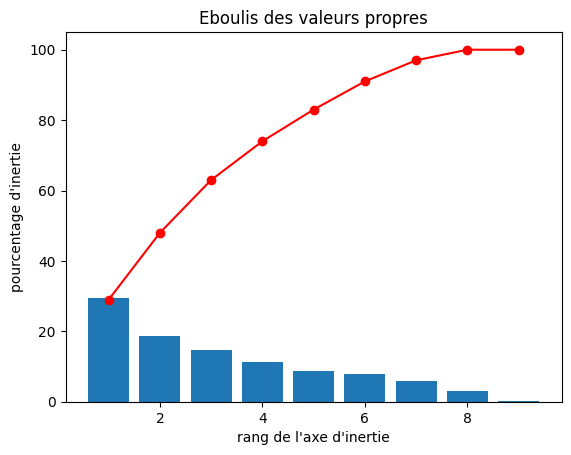

In [ ]:
# Représentation graphique de l'Éboulis des Valeurs Propres en Analyse en Composantes Principales
plt.bar(df_pca_list, scree)
plt.plot(df_pca_list, scree_cum,c="red",marker='o')
plt.xlabel("rang de l'axe d'inertie")
plt.ylabel("pourcentage d'inertie")
plt.title("Eboulis des valeurs propres")
plt.show()

In [ ]:
#Mise en Forme des Composantes Principales
components.columns = features
components.index = [f"F{i}" for i in df_pca_list]
components.round(2)

,energy_100g,fiber_100g,fat_100g,cholesterol_100g,carbohydrates_100g,proteins_100g,salt_100g,iron_100g,nutrition-score-fr_100g
F1,0.59,0.18,0.49,0.09,0.28,0.23,0.01,0.15,0.46
F2,-0.08,-0.43,0.23,0.54,-0.49,0.23,0.11,-0.34,0.22
F3,-0.10,0.46,-0.01,0.22,-0.28,0.61,0.06,0.40,-0.34
F4,-0.06,-0.03,-0.11,-0.10,0.04,-0.03,0.96,0.15,0.15
F5,-0.06,-0.40,-0.36,0.47,0.33,-0.01,-0.14,0.58,0.15
F6,-0.05,-0.25,0.39,-0.34,-0.49,-0.26,-0.08,0.58,0.05
F7,-0.05,0.48,0.15,0.54,-0.10,-0.66,0.07,0.05,-0.03
F8,-0.36,0.35,-0.29,-0.14,-0.20,0.07,-0.16,0.01,0.76
F9,-0.70,-0.01,0.54,0.01,0.45,0.11,0.00,-0.00,-0.01


In [ ]:
components.T

,F1,F2,F3,F4,F5,F6,F7,F8,F9
energy_100g,0.591100,-0.081216,-0.095629,-0.061276,-0.064314,-0.052387,-0.045097,-0.358176,-0.702781
fiber_100g,0.178709,-0.430816,0.456732,-0.034122,-0.396174,-0.249210,0.483997,0.345330,-0.011302
fat_100g,0.492920,0.229054,-0.011912,-0.111685,-0.364017,0.392955,0.152071,-0.293989,0.543573
cholesterol_100g,0.090015,0.539081,0.217086,-0.097817,0.467029,-0.341456,0.539417,-0.137137,0.010394
carbohydrates_100g,0.284197,-0.486096,-0.283619,0.044554,0.329552,-0.493378,-0.096886,-0.201590,0.445495
proteins_100g,0.226145,0.229573,0.613419,-0.031410,-0.014739,-0.263446,-0.657329,0.072785,0.109018
salt_100g,0.010543,0.109802,0.055464,0.962538,-0.140731,-0.084801,0.067262,-0.163545,0.002943
iron_100g,0.153391,-0.340202,0.396316,0.148135,0.581124,0.584382,0.049871,0.005149,-0.001079
nutrition-score-fr_100g,0.460480,0.218954,-0.343682,0.147118,0.148165,0.051231,-0.033714,0.757965,-0.005576


<Axes: >

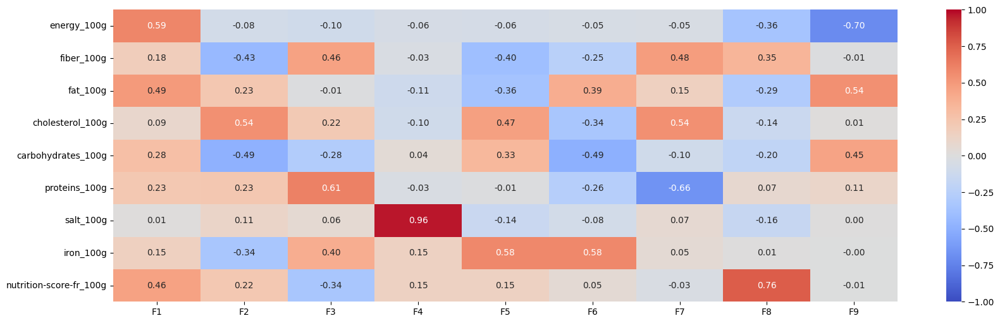

In [ ]:
#Heatmap des Composantes Principales en ACP
fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(components.T, vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")

In [ ]:
# Fonction Graphique de Corrélation en ACP
def correlation_graph(pca, x_y, features):
    x, y = x_y
    if x >= pca.n_components_ or y >= pca.n_components_:
        raise ValueError("x et y doivent être inférieurs au nombre de composantes de la PCA")

    fig, ax = plt.subplots(figsize=(8, 7))
    texts = []
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)

    for i in range(pca.components_.shape[1]):
        ax.arrow(0, 0, pca.components_[x, i], pca.components_[y, i],
                 head_width=0.05, head_length=0.07, width=0.01, fc='grey', ec='grey')
        texts.append(ax.text(pca.components_[x, i], pca.components_[y, i], features[i],
                 color='black'))

    adjust_text(texts, only_move={'points':'y', 'texts':'y'}, arrowprops=dict(arrowstyle='-[', color='black'))

    plt.xlabel(f'F{x+1} ({round(100*pca.explained_variance_ratio_[x],1)}%)')
    plt.ylabel(f'F{y+1} ({round(100*pca.explained_variance_ratio_[y],1)}%)')
    plt.title(f"Cercle des corrélations (F{x+1} et F{y+1})")

    an = np.linspace(0, 2 * np.pi, 100)
    plt.plot(np.cos(an), np.sin(an), 'gray')

    ax.axhline(0, color='grey', linestyle='--')
    ax.axvline(0, color='grey', linestyle='--')
    ax.set_aspect('equal', 'box')

    plt.show(block=False)

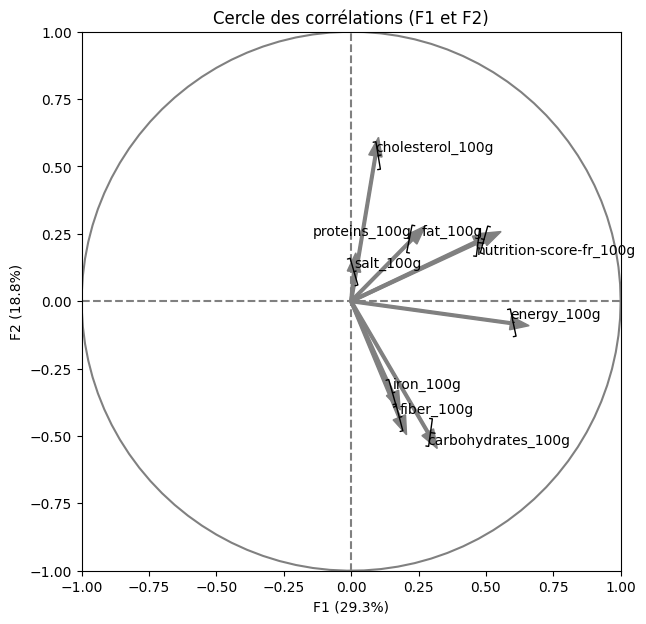

In [ ]:
# Graphique de Corrélation entre les Composantes Principales F1 et F2
x_y = (0,1)
correlation_graph(pca, x_y, features)

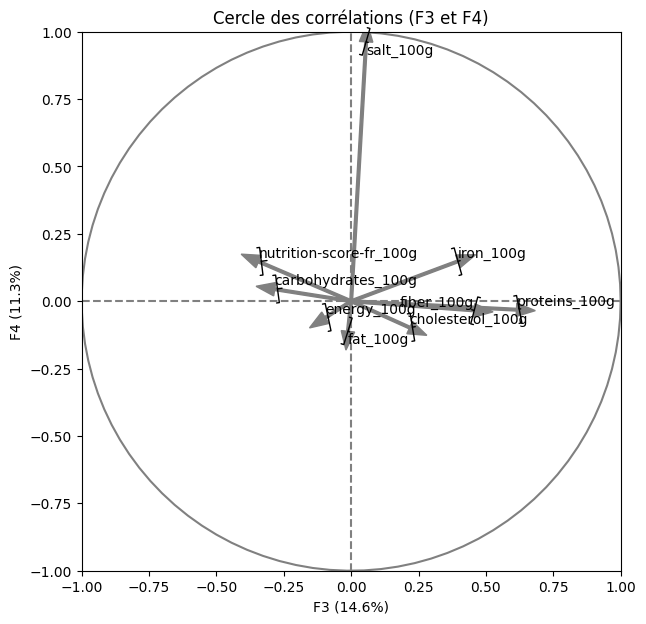

In [ ]:
#Graphique de Corrélation entre les Composantes Principales F2 et F3
correlation_graph(pca, (2,3), features)

In [ ]:
#Projection des Données sur les Composantes Principales
df_pca_proj = pca.transform(df_pca_scaled)

In [ ]:
# Fonction de l'affichage du Plan Factoriel
def display_factorial_planes(X_projected, x_y, pca=None, labels=None, clusters=None,
                             alpha=0.7, figsize=[8,7], markers=None):
    X_ = np.array(X_projected)
    x, y = x_y
    fig, ax = plt.subplots(figsize=figsize)

    hue = None if clusters is None else clusters

    if markers is None:
        markers = ["o" for _ in range(len(np.unique(hue)))] if hue is not None else "o"

    sns.scatterplot(x=X_[:, x], y=X_[:, y], hue=hue, style=hue,
                    palette='Set1', markers=markers, alpha=alpha)

    if pca:
        v1 = f"{round(100 * pca.explained_variance_ratio_[x], 1)} %"
        v2 = f"{round(100 * pca.explained_variance_ratio_[y], 1)} %"
        ax.set_xlabel(f'F{x+1} ({v1})')
        ax.set_ylabel(f'F{y+1} ({v2})')
    else:
        ax.set_xlabel(f'F{x+1}')
        ax.set_ylabel(f'F{y+1}')

    x_max, y_max = np.max(np.abs(X_[:, [x, y]]), axis=0) * 1.1
    ax.set_xlim(-x_max, x_max)
    ax.set_ylim(-y_max, y_max)

    ax.axhline(0, color='grey', linestyle='--', alpha=0.8)
    ax.axvline(0, color='grey', linestyle='--', alpha=0.8)

    if labels is not None:
        for i, (x_coord, y_coord) in enumerate(X_[:, [x, y]]):
            ax.text(x_coord, y_coord, labels[i], fontsize=9, ha='right', va='bottom')

    plt.title(f"Projection des individus (sur F{x+1} et F{y+1})")
    plt.legend()
    plt.show()


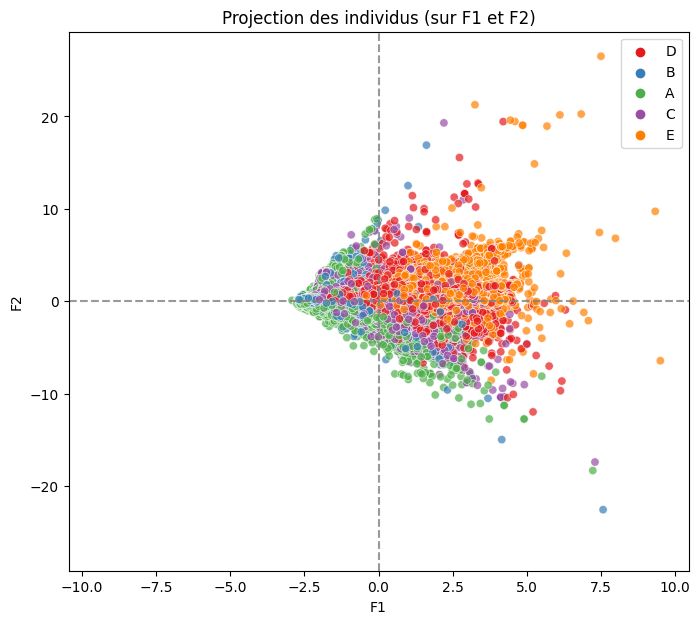

In [ ]:
#Affichage du Plan Factoriel F1 & F2 en Analyse en Composantes Principales (ACP) avec les Notes Nutritionnelles
x_y = [0,1]
display_factorial_planes(df_pca_proj, x_y, clusters=df_analysis['nutrition_grade_fr'])

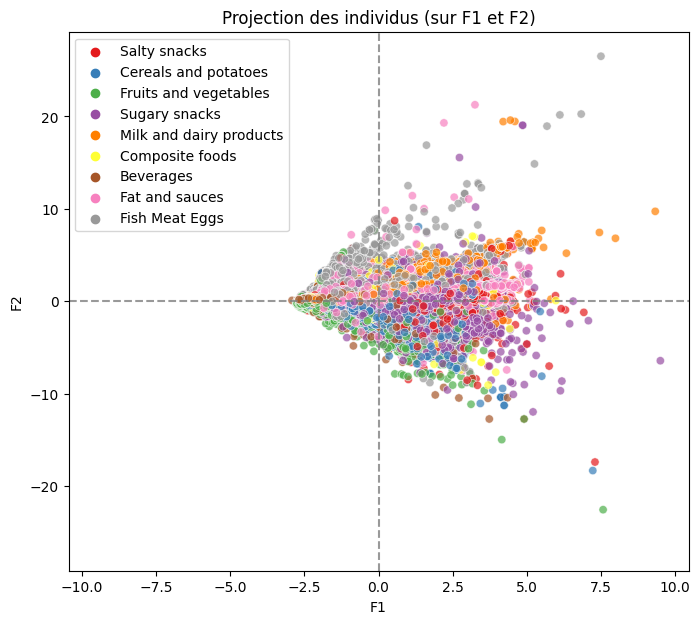

In [ ]:
#Affichage du Plan Factoriel F1 & F2 en Analyse en Composantes Principales (ACP) avec les PNNS1
x_y = [0,1]
display_factorial_planes(df_pca_proj, x_y, clusters=df_analysis['pnns_groups_1'])

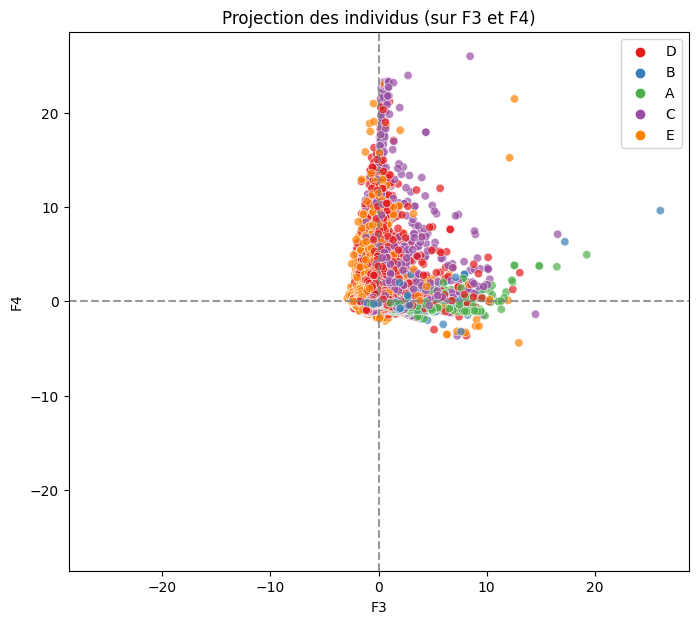

In [ ]:
#Affichage du Plan Factoriel F3 & F4 en Analyse en Composantes Principales (ACP) avec les nutrigrades
x_y = [2,3]
display_factorial_planes(df_pca_proj, x_y, clusters=df_analysis['nutrition_grade_fr'])

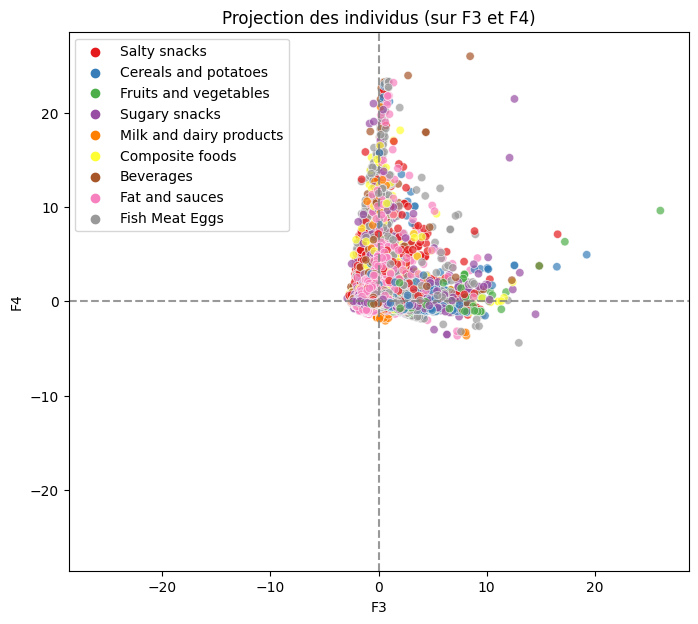

In [ ]:
#Affichage du Plan Factoriel F3 & F4 en Analyse en Composantes Principales (ACP) avec les PNNS1
x_y = [2,3]
display_factorial_planes(df_pca_proj, x_y, clusters=df_analysis['pnns_groups_1'])

**Conclusion :**  
L'analyse en composantes principales fournit un aperçu riche de la structure sous-jacente des données nutritionnelles :

- Les corrélations identifiées entre les graisses, l'énergie et le score nutritionnel indiquent que ces variables sont des indicateurs clés de la qualité nutritionnelle des produits.
- La dispersion des produits sur les plans F1 et F2 reflète la variation de la qualité nutritionnelle, avec une séparation claire entre les aliments ayant des notes de nutrition différentes.
- Les axes F3 et F4 révèlent des aspects moins évidents de la composition nutritionnelle qui ne sont pas directement liés à la qualité nutritionnelle, tels que la teneur en sel ou d'autres micronutriments.

Ces observations indiquent que l'Analyse en Composantes Principales (ACP) a été utile pour explorer les différentes dimensions de la qualité nutritionnelle. Elle peut être appliquée pour orienter la conception d'un système d'auto-complétion précis et informatif.Cela aide à garantir que les entrées de données reflètent non seulement les informations nutritionnelles basiques, mais aussi des subtilités plus nuancées.

### Test ANOVA ###

L'Analyse de Variance (ANOVA) est une méthode statistique essentielle qui permet de comparer les moyennes de plusieurs groupes pour évaluer s'il existe des différences significatives entre eux. Elle est largement utilisée pour déterminer si des facteurs catégoriels ont un impact sur une variable continue. Dans ce contexte, nous utiliserons l'ANOVA pour étudier les relations entre les catégories alimentaires et les valeurs nutritionnelles, en examinant si des différences significatives existent entre ces groupes.

In [ ]:
# Hypothèse de normalité : Test de Kolmogorov-Smirnov avec la correction de Lilliefors

df_test = df_analysis[select_columns_quantitatives]
seuil = 0.05
print('Hypothèse 0 : Distribution normale dans la caractéristique')

for col in df_test.columns:  # Assurez-vous d'utiliser df_test ici
    D, pval = sm.stats.diagnostic.kstest_normal(df_test[col])
    print('Analyse de la colonne : {}'.format(col))
    print('D= {}\nP-value= {}'.format(D, pval))

    if pval < seuil:
        print('p inférieur au seuil ({}) : Rejet de l\'hypothèse 0 : n\'a pas de distribution normale'
              .format(seuil, col))
    else:
        print("Pas de rejet de l'hypothèse 0")
    print('---')

Hypothèse 0 : Distribution normale dans la caractéristique
Analyse de la colonne : energy_100g
D= 0.07956208127169684
P-value= 0.0009999999999998899
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : n'a pas de distribution normale
---
Analyse de la colonne : fiber_100g
D= 0.28151921470066954
P-value= 0.0009999999999998899
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : n'a pas de distribution normale
---
Analyse de la colonne : fat_100g
D= 0.19420774212512487
P-value= 0.0009999999999998899
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : n'a pas de distribution normale
---
Analyse de la colonne : saturated-fat_100g
D= 0.25185602590951606
P-value= 0.0009999999999998899
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : n'a pas de distribution normale
---
Analyse de la colonne : cholesterol_100g
D= 0.34316052090004623
P-value= 0.0009999999999998899
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : n'a pas de distribution normale
---
Analyse de la colonne : carb

In [ ]:
# Hypothèse d'homogénéité : Test de Levene

facteur = df_analysis["nutrition_grade_fr"]
columns = df_test.columns[:-1]
seuil = 0.05

print('Hypothèse 0 : Homogénéité des variances entre les groupes')

for col in columns:
    groupes = []

    for niveau in facteur.unique():
        groupe_data = df_analysis[df_analysis["nutrition_grade_fr"] == niveau][col]
        groupes.append(groupe_data)

    statistique_levene, pval = stats.levene(*groupes)

    print('Analyse de la colonne : {}'.format(col))
    print('Statistique de Levene= {}\nP-value= {}'.format(statistique_levene, pval))

    if pval < seuil:
        print('p inférieur au seuil ({}) : Rejet de l\'hypothèse 0 : Les variances ne sont pas égales'
              .format(seuil, col))
    else:
        print("Pas de rejet de l'hypothèse 0")
    print('---')

Hypothèse 0 : Homogénéité des variances entre les groupes
Analyse de la colonne : energy_100g
Statistique de Levene= 1685.043832239126
P-value= 0.0
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : Les variances ne sont pas égales
---
Analyse de la colonne : fiber_100g
Statistique de Levene= 1099.8127509158933
P-value= 0.0
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : Les variances ne sont pas égales
---
Analyse de la colonne : fat_100g
Statistique de Levene= 4952.499781652674
P-value= 0.0
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : Les variances ne sont pas égales
---
Analyse de la colonne : saturated-fat_100g
Statistique de Levene= 8775.169220231312
P-value= 0.0
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : Les variances ne sont pas égales
---
Analyse de la colonne : cholesterol_100g
Statistique de Levene= 1076.9664616651032
P-value= 0.0
p inférieur au seuil (0.05) : Rejet de l'hypothèse 0 : Les variances ne sont pas égales
---
Analyse de la colonne 

In [ ]:
# ANOVA
resultats_anova = pd.DataFrame(columns=['Variable', 'F-statistic', 'p-value'])

df_analysis.columns = [col.replace('-', '_') for col in df_analysis.columns]

for variable in df_analysis.columns:
    if '100g' in variable:
        formula = f'{variable} ~ C(pnns_groups_1) * C(nutrition_grade_fr)'
        model = ols(formula, data=df_analysis).fit()
        anova_table = sm.stats.anova_lm(model, typ=2)

        f_statistic = anova_table.loc['C(pnns_groups_1):C(nutrition_grade_fr)', 'F']
        p_value = anova_table.loc['C(pnns_groups_1):C(nutrition_grade_fr)', 'PR(>F)']

        resultats_anova = pd.concat([resultats_anova, pd.DataFrame({'Variable': variable, 'F-statistic': f_statistic, 'p-value': p_value}, index=[0])])

resultats_anova.reset_index(drop=True, inplace=True)

resultats_anova

,Variable,F-statistic,p-value
0,energy_100g,387.992919,0.000000e+00
1,fiber_100g,101.176436,0.000000e+00
2,fat_100g,368.898356,0.000000e+00
3,saturated_fat_100g,263.342730,0.000000e+00
4,cholesterol_100g,222.909401,0.000000e+00
5,carbohydrates_100g,222.303407,0.000000e+00
6,proteins_100g,355.020250,0.000000e+00
7,salt_100g,50.968507,1.482197e-321
8,sugars_100g,482.967092,0.000000e+00
9,iron_100g,26.888951,1.095228e-159


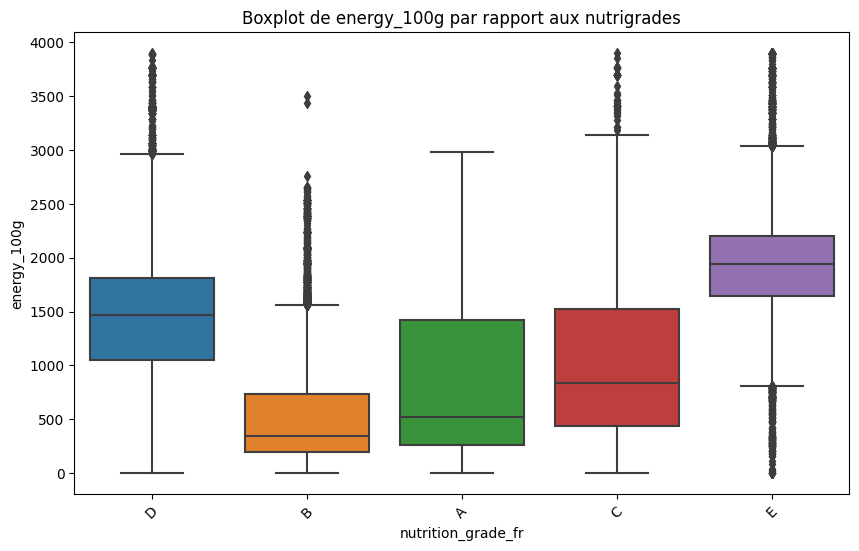

In [ ]:
# Boxplot d'energy_100g & les notes nutritionnelles
plt.figure(figsize=(10, 6))
sns.boxplot(x='nutrition_grade_fr', y='energy_100g', data=df_analysis)
plt.title('Boxplot de energy_100g par rapport aux nutrigrades')
plt.xlabel('nutrition_grade_fr')
plt.ylabel('energy_100g')
plt.xticks(rotation=45)
plt.show()

In [ ]:
ss_total = anova_table['sum_sq'].sum()

# Calcule de l'eta carré partiel pour pnns_groups_1
ss_pnns_groups_1 = anova_table['sum_sq']['C(pnns_groups_1)']
eta_squared_pnns_groups_1 = ss_pnns_groups_1 / (ss_pnns_groups_1 + anova_table['sum_sq']['Residual'])

# Calcule de l'eta carré partiel pour nutrition_grade_fr
ss_nutrition_grade_fr = anova_table['sum_sq']['C(nutrition_grade_fr)']
eta_squared_nutrition_grade_fr = ss_nutrition_grade_fr / (ss_nutrition_grade_fr + anova_table['sum_sq']['Residual'])

print(f"Eta carré partiel pour 'pnns_groups_1': {eta_squared_pnns_groups_1}")
print(f"Eta carré partiel pour 'nutrition_grade_fr': {eta_squared_nutrition_grade_fr}")

Eta carré partiel pour 'pnns_groups_1': 0.03426497217009261
Eta carré partiel pour 'nutrition_grade_fr': 0.9138229732777381


In [ ]:
# Test non paramétrique, alternatif à ANOVA : Test de Kruskal-Wallis
results = []

cols = [col.replace('-', '_') for col in df_analysis.columns]

for var in cols:
    group_A = df_analysis[df_analysis['nutrition_grade_fr'] == 'A'][var]
    group_B = df_analysis[df_analysis['nutrition_grade_fr'] == 'B'][var]
    group_C = df_analysis[df_analysis['nutrition_grade_fr'] == 'C'][var]
    group_D = df_analysis[df_analysis['nutrition_grade_fr'] == 'D'][var]
    group_E = df_analysis[df_analysis['nutrition_grade_fr'] == 'E'][var]

    stat, p = kruskal(group_A, group_B, group_C, group_D, group_E)

    result_dict = {
        'Variable': var,
        'Statistique de test': stat,
        'P-value': p
    }

    results.append(result_dict)

results_test = pd.DataFrame(results)

results_test

,Variable,Statistique de test,P-value
0,code,359.701694,1.409581e-76
1,product_name,344.372946,2.876596e-73
2,pnns_groups_1,31933.719716,0.000000e+00
3,nutrition_grade_fr,155862.000000,0.000000e+00
4,energy_100g,65772.548451,0.000000e+00
5,fiber_100g,13050.772849,0.000000e+00
6,fat_100g,58545.272521,0.000000e+00
7,saturated_fat_100g,72799.347637,0.000000e+00
8,cholesterol_100g,7030.083396,0.000000e+00
9,carbohydrates_100g,12132.144246,0.000000e+00


**Conclusion :**   
L'analyse ANOVA a mis en lumière des constatations importantes concernant la distribution des valeurs nutritionnelles dans notre base de données. Malgré le rejet de l'hypothèse de normalité et d'homogénéité des variances pour les variables telles que l'énergie, les fibres, les matières grasses, et d'autres, les tests ont révélé des interactions significatives.

- En particulier, la valeur de F significative pour l'interaction entre les groupes alimentaires PNNS (pnns_groups_1) et les notes nutritionnelles (nutrition_grade_fr) suggère que la qualité nutritionnelle des produits est affectée de manière complexe par ces classifications. Les nutriments clés montrent des différences statistiquement significatives entre les catégories, ce qui souligne leur rôle dans la diversité nutritionnelle des produits.

- Les résultats des tests de Kruskal-Wallis, effectués en raison des violations des hypothèses de l'ANOVA, soutiennent fortement ces constatations, en indiquant des différences significatives entre les catégories PNNS et les notes nutritionnelles. Cela confirme l'existence de distinctions nutritionnelles marquées et cohérentes en accord avec ces classifications.

- Le carré d'Eta partiel révèle que les notes nutritionnelles expliquent une part prépondérante de la variance pour les données nutritionnelles, bien plus que les groupes PNNS. Cela suggère que le Nutri-Score est un indicateur puissant de la qualité nutritionnelle globale des aliments.

Compte tenu des violations des hypothèses sous-jacentes à l'ANOVA, des approches alternatives telles que les tests non paramétriques ont été utilisées pour valider nos conclusions. Ces approches confirment que les classifications PNNS et Nutri-Score ne sont pas de simples catégories administratives, mais traduisent des différences nutritionnelles significatives qui doivent être prises en compte dans les initiatives visant à améliorer la qualité nutritionnelle des aliments.

# Conclusion

L'ensemble des analyses statistiques, incluant l'Analyse en Composantes Principales (ACP) et l'Analyse de Variance (ANOVA), révèle des informations cruciales sur la composition nutritionnelle des produits alimentaires et leur classification selon le PNNS et le Nutri-Score. Nous avons constaté des associations significatives entre les catégories alimentaires, les notes nutritionnelles et les valeurs nutritionnelles clés telles que les graisses, les sucres, l'énergie et les graisses saturées.

Il est également crucial de souligner que notre analyse actuelle est limitée par l'absence d'une variable clé : la teneur en fruits et légumes en pourcentage, qui est un composant essentiel du calcul du Nutri-Score(données supprimées en début d'analyse car 99% de données manquantes).

Au vu des analyses réalisées et des données à disposition, la faisabilité d'un projet d'auto-complétion ou de suggestion pour aider à la saisie efficace dans la base de données de Santé publique France semble prometteuse. Les modèles statistiques comme l'ACP et l'ANOVA ont révélé des structures claires et des associations significatives au sein des données nutritionnelles, fournissant un cadre solide pour développer des algorithmes de suggestion. Ces algorithmes pourraient prédire des valeurs nutritionnelles pour des entrées incomplètes ou suggérer des corrections en temps réel, basées sur des tendances observées dans la base de données existante

Il est tout de fois pertinent de noter que l'Union européenne envisage une amélioration du Nutri-Score pour une application cohérente à travers ses membres. Cette évolution est d'une importance capitale car elle va probablement intégrer des critères supplémentaires et affiner les seuils actuels pour une évaluation plus précise de la qualité nutritionnelle des produits.